# Bevezetés

A **Kolozsvári Diáknapok** évente több mint 50 próbából álló, közösségi és versengő eseménysorozat, ahol baráti társaságokból verbuválódott csoportok mérik össze tudásukat és kreativitásukat. A Diáknapok nemcsak szórakozást kínálnak, hanem komoly versenyt is, hiszen a különböző feladatokon elért pontok összesítése dönt arról, hogy melyik csapat zárja az évet a legtöbb ponttal.  

Ebben a projektben a Diáknapok történeti adatain alapuló alkalmazott gépi tanulási (ML) módszereket valósítunk meg, hogy:

1. **Megértsük, mely tényezők (próbák, csapatjellemzők, évszámok stb.) befolyásolják legerőteljesebben egy-egy csapat összpontszámát**,  
2. **Klaszterező algoritmusokkal csoportosítsuk a csapatokat**, ezzel feltárva, hogy vannak-e jól elkülöníthető “erőviszonyi” szintek vagy „klánok” a mezőnyben,  
3. **Felügyelt tanulási modellekkel** (például döntési fa vagy véletlen erdő) **előre jelezzük**, hogy egy adott csapat bekerül-e a Top 5-be, illetve potenciálisan megjósoljuk a következő Diáknapok nyertesét.  

**Miért érdemes ezzel foglalkozni?**  
- A Diáknapok során több évnyi adat gyűlt össze eltérő formátumokban (részletes próba-szintű bontás egyes években, máskor csak összpontszám vagy csapatlista), ezért először szükséges az adatok előfeldolgozása (data wrangling), hogy minden év egységes, “long form” adatbázisként legyen kezelhető. 
- A normalizálás során egységes formátumba hozzuk a csapatneveket, kezeljük a hiányzó értékeket, és numerikus skálára helyezzük a pontszámokat, hogy összehasonlíthatóvá váljanak a különböző próbák és évek.  
- A felfedező adatelemzés (EDA) segítségével feltérképezzük a pontszámeloszlásokat, a próbák közötti korrelációkat és a csapatok közötti trendeket, amelyek megalapozzák a későbbi jellemzők (feature-ök) kialakítását.  
- A feature engineering során olyan új jellemzőket hozunk létre (például a csapat részvételének évei, próba-átlagpontszámok, kategóriák), amelyek növelik a modell prediktív erejét.  
- A modellépítés során legalább két különböző algoritmust alkalmazunk: egy felügyelt (supervised) módszert a csapatok rangsorának előrejelzésére, valamint egy felügyeletlen (unsupervised) klaszterező eljárást, hogy láthatóvá váljanak a csapatok közötti természetes csoportosulások.  
- Végül a modell értelmezésével és következtetésekkel visszajelzést adunk a KMDSZ szervezőinek arról, mely próbák döntik el leginkább a végeredményt, és mely csapatok viselkedésében mutatkoznak hasonlóságok vagy különbségek.  

A projekt célja nem pusztán a statisztikai elemzés, hanem egy olyan end-to-end ML-pipeline megvalósítása, amely a nyers adatoktól eljut a döntéstámogató eredményekig:  
1. **Data Wrangling** → embedded_files kódból “long form” adatbázist hozunk létre  
2. **Data Normalization** → csapatnevek és pontszámok egységesítése, hiányzó értékek kezelése  
3. **EDA (Data Discovery)** → vizualizációkkal feltárjuk a mintázatokat és anomáliákat  
4. **Feature Engineering** → új jellemzők létrehozása, amelyek segítenek a modell tanulásában  
5. **Modeling (Supervised & Unsupervised)** → legalább egy osztályozó vagy regresszor az összpontszám előrejelzésére, valamint egy klaszterező a csapatok csoportosítására  
6. **Conclusions** → a modellek eredményeinek értelmezése, javaslatok megfogalmazása a következő Diáknapok nyertesének megjóslásához és a szervezőknek szóló döntéstámogatáshoz  

Ez a bevezetés összefoglalja a projekt felépítését és indokait, amely alapján lépésről lépésre haladunk a kód és a magyarázó szöveg keverékét alkalmazó Jupyter-munkafüzeten keresztül.

**!!! Fontos, hogy minden kódcellát egymás utáni sorrendben futtassunk, mivel egyes scriptek az előttük levő scriptek által létrehozott adatokkal tudnak csak dolgozni. !!!** 

**!!! Leggyorsabb módja a futtatásnak: Run -> Run all Cells !!!**

```


In [ ]:
# ── Auto‐install any missing packages ──
import sys
import subprocess

def install_if_missing(pkg_name, import_name=None):
    try:
        __import__(import_name or pkg_name)
    except ImportError:
        print(f"Installing {pkg_name}…")
        subprocess.check_call([sys.executable, "-m", "pip", "install", pkg_name])

# List of (pip‐package, import_name) to check/install:
install_if_missing("pandas")
install_if_missing("matplotlib")
install_if_missing("seaborn")
install_if_missing("numpy")
install_if_missing("scikit-learn", "sklearn")    # <-- correct name here
install_if_missing("unidecode")
install_if_missing("ipython", "IPython")
install_if_missing("openpyxl")



import pandas as pd
import os
import glob
import matplotlib.pyplot as plt
import seaborn as sns
import base64
import io
from IPython.display import display

# Dictionary to store processed DataFrames
processed_data = {}

# Python Scripts
A Scriptek különbontva

## 01_Data_Wrangling.py

1. **Fájlok előkészítése**  
   Az összes bemeneti fájl (évszámok és pontok) egy Python-dictionary (embedded_files) kulcsai között található. Innen vesszük előre a fájlneveket és tartalmukat.

2. **Évszám kinyerése**  
   A fájlnévből leválogatjuk az első négy számjegyet, így meghatározzuk, melyik évhez tartoznak az adatok.

3. **Betöltés és formátum ellenőrzése**  
   - Ha az adat tartalmaz `Unnamed: 0` oszlopot (korábbi transzponált formátum), visszatranszponáljuk (`.T`), majd a `melt`-függvénnyel “long form” formátumra alakítjuk.  
   - Ha már van külön `csapat` és `pontszam` oszlop, hozzáadunk egy `proba = "Összesített pont"` jelölést.  
   - Ha találunk olyan oszlopnevet, ami tartalmazza a “csapat” szótagot, átnevezzük `csapat`-ra, és a többi oszlopot `melt`-eljük próba–pontszám párokká.  

4. **„Long form” átalakítás**  
   Minden fájlból előállítunk egy DataFrame-et három oszloppal, majd minden sorhoz hozzárendeljük az adott évszámot (`ev` oszlop).

5. **Összefűzés és tisztítás**  
A kapott “long form” DataFrame-eket egyetlen nagy `final_df`-be fűzzük össze. Ezután a „pontszam” oszlopot numerikus típusúra konvertáljuk, és eltávolítjuk azokat a sorokat, ahol `csapat` vagy `pontszam` értéke hiányzik (`NaN`).

6. **Mentés CSV-be**  
A végleges, egységesített táblázatot elmentjük `Processed_csvs/egyseges_diaknapok_adatok.csv` néven.  

> **Miért fontos ez?**  
> Így a következő lépések (normalizálás, EDA, feature engineering) már egy egységes, jól strukturált adatbázissal dolgozhatnak tovább.

In [2]:
# 01_data_wrangling_selfcontained.py

import pandas as pd
import io
import base64
from IPython.display import HTML, display


# Dictionary to store encoded files
embedded_files = {}

# Embedded file: 2024.xlsx
embedded_files['2024.xlsx'] = '''UEsDBBQAAAAIAAAAPwBhXUk6TwEAAI8EAAATAAAAW0NvbnRlbnRfVHlwZXNdLnhtbK2Uy27CMBBF9/2KyNsqMXRRVRWBRR/LFqn0A1x7Qiwc2/IMFP6+k/BQW1Gggk2sZO7cc8eOPBgtG5ctIKENvhT9oicy8DoY66eleJ8853ciQ1LeKBc8lGIFKEbDq8FkFQEzbvZYipoo3kuJuoZGYREieK5UITWK+DVNZVR6pqYgb3q9W6mDJ/CUU+shhoNHqNTcUfa05M/rIAkciuxhLWxZpVAxOqsVcV0uvPlFyTeEgjs7DdY24jULhNxLaCt/AzZ9r7wzyRrIxirRi2pYJU3Q4xQiStYXh132xAxVZTWwx7zhlgLaQAZMHtkSElnYZT7I1iHB/+HbPWq7TyQunURaOcCzR8WYQBmsAahxxdr0CJn4f4L1s382v7M5AvwMafYRwuzSw7Zr0SjrT+B3YpTdcv7UP4Ps/I8dea0SmDdKfA1c/OS/e29zyO4+GX4BUEsDBBQAAAAIAAAAPwDyn0na6QAAAEsCAAALAAAAX3JlbHMvLnJlbHOtksFOwzAMQO98ReT7mm5ICKGluyCk3SY0PsAkbhu1jaPEg+7viZBADI1pB45x7Odny+vNPI3qjVL2HAwsqxoUBcvOh87Ay/5pcQ8qCwaHIwcycKQMm+Zm/UwjSqnJvY9ZFUjIBnqR+KB1tj1NmCuOFMpPy2lCKc/U6Yh2wI70qq7vdPrJgOaEqbbOQNq6Jaj9MdI1bG5bb+mR7WGiIGda/MooZEwdiYF51O+chlfmoSpQ0OddVte7/D2nnkjQoaC2nGgRU6lO4stav3Uc210J58+MS0K3/7kcmoWCI3dZCWP8MtInN9B8AFBLAwQUAAAACAAAAD8ARHVb8OgAAAC5AgAAGgAAAHhsL19yZWxzL3dvcmtib29rLnhtbC5yZWxzrZLBasMwEETv/Qqx91p2EkopkXMphVzb9AOEtLZMbElot2n99xEJTR0IoQefxIzYmQe7683P0IsDJuqCV1AVJQj0JtjOtwo+d2+PzyCItbe6Dx4VjEiwqR/W79hrzjPkukgih3hS4Jjji5RkHA6aihDR558mpEFzlqmVUZu9blEuyvJJpmkG1FeZYmsVpK2tQOzGiP/JDk3TGXwN5mtAzzcq5HdIe3KInEN1apEVXCySp6cqcirI2zCLOWE4z+IfyEmezbsMyzkZiMc+L/QCcdb36lez1jud0H5wytc2pZjavzDy6uLqI1BLAwQUAAAACAAAAD8A/5Arbk8oAAAN+gAAGAAAAHhsL3dvcmtzaGVldHMvc2hlZXQxLnhtbI1d23LkNpJ936/o6PedFgmSpXLYngDrflGprlJVvWls2d0xdsuh1ox3/37VLRyYdTLPxL5JSCIzkchDgOCp5Pd//5/ff3v378fnL5+ePv/wvvjb1ft3j59/evr50+dff3h/2I//+/r9uy8vD59/fvjt6fPjD+//9/HL+7//+F/f//n0/M8vHx8fX969Kvj85Yf3H19e/vjuw4cvP318/P3hy9+e/nj8/Cr55en594eX13+ff/3w5Y/nx4efv3X6/bcP5dVV8+H3h0+f379p+O75/6Pj6ZdfPv30OHz66V+/P35+eVPy/Pjbw8ur+18+fvrjy/sfv//506vs63jePT/+8sP7WHwXl039/sOP33+zfffp8c8vnb/fvTz8Y/f42+NPL48/v0bg/buvQ/vH09M/vwpnr01XX7t+MH3H39xaP7/7+fGXh3/99rJ9+nP6+OnXjy+vSv6yNnx4efjx++enP989f1P+5Y+Hr9EqvgvXr67+9LU1fm3+Jnzt+nUA//7x6vsP/361+VO6orVXFJdXDOwV5eUVQ3tFuLxiZK+oLq8Y2yvqyysm9orm8oqpvaJ3ecXMXnF9ecXcXtG/vGLhRIyCunQuoajeOJdQWFfOJRTXW+cSCuzauYQiu3EuodBunUsotjvnEgru3rmEontwso2ie+dcQtG9dy6h6B6dSyi6J+cSiu7ZuYSiGx0QlhTe6MCwpPhGD4gU4OhAsaQIRweMgUIcHTgGinF0ABkoyNGBZKAoRweUgcIcHVgGjrMDzMBxdpAZ/orzh9ebab6jlv4dtex2pfC35duNq7kiwaBM2KQ4D9/ar6l5VKaIk5rxW3vFd8akvU+XT1N7TepnpTvp8zJhidQvUnuPEmCZ1PNgb97a+6R+5Y/1NmmvKd3XImQbX802Xd4j53e+M3uEgNoPyRtOnDu00/X3Qs8xXc/3rpNoP/ujilG0p0zj0caBmPKYMq1gwzHlWskjiCLZYsq2hq9HtvVYMEOesGDuz01MCRcqvnMh4zqr0wVkgw/Z0IUs6WzDG2Sra4ZsSEsYQzZ1YMiGdHOjO+A4uBM1CQlrhKlpslrT9TPRPg9uCBdJfcOQFYO6Ee2r4Kf3bdJ/zaANArRop+hvg5tju+Cm2F5oPyRveFW9S+08V/f+FB7T5X0K2kmYPaOdF+GI6BvUIpyM2uBuI2PKNTYcR37YYkq2whie+AGNUzG0iHyzmBWaUsYFc+NBynXWygvMVj5mq+6jAj+zVG/zV/Yo/QaVf5MbVv4wR1UCLW1JxpU7yEmV8ozXWaF+Vvm31vlbO98oF+nyHnmzrMQ6W7lpvKr8dRbaKWnW/uWbZJS3INvKvZ/tKv9Gsfe1HyqxzKKdEesP9Zgu53v3Cc4zYjGBZosuOsTWH25Eptl1FoFgyIpciCLX4kS0I9nM1naGNDGQrfy7Rco3B7Jvgv5fS9kFYmsfsXUXsXQLbeu35v4VI/ZN0JBvw9q/g45Se8WnB7W/ytZplujyaWq/4lW2dmM+r/3VcVH7++4lzBKQb2o/y1a1j9g02Cua6XUtFlmMiiFb+7m680e79705wBuK2R2CQF7eCy+PSQ/rP4nrz2/tHOMYa38nHVOuFQbkAz9JYko2s29NyVbYh2M/cHEi2pFufMATZ5gxA9k3gVlk67QxZkXIuFJsjBsfsk0XsqSzbd6arznygzdBnyHb+Pvixr9Fjxv3pjRp/GyaQg0BtnHvtnPfl0VS0qOhLhuxwPpqVo0P16Sdt+jrxr+XbZJVPgHbNm4W7Rp3p7+HFoZrI1ZYtPMKK/Qc4T2fjSHyDFc/O2L0gxZTmtkFtlELbCPQ2qgF1s+0OPHjHFOq2SflGdLEoFWMIeVbqPjECwnXsX0B154P114XrqSz7SW4cnIPev4K2xNb4rf2wGeh456/wvZS0pOaqW911vPx2vOTbwHttGtY9vwF+QaDIrOrnp+st+n6miC47vl74nQ5H/ttez5iez5ihfOHNFjzFCtCfC+CdkzX93hTLK4/p/aGN5Sx597+YutPYkyZZgDbE4Dt+bgci0mMEz/Mcao6pGxzACtMp3xzDp5SB7G8Xvt4ve7ilbag7fVbc4+naXDt4/XaT+HRW3vJWTa+doM1uU6TzTvia3/TNPPVzK/9BTZpueYFNmnh/XDynQ+cV9f+xus2tfd4Q3ztwzVdXvG7rGt39nfXPlx95YfkO6fKHcZE03rvR+x47W8aTr7Vsz8dMYrsiC0EjFUx3zHlmUWrH7Qo8iymRLPLMTLNvCpKqeagVZhO2eY8v6bgiROnvo/WfhetZKvtJ7TySjTou9M69JtH/TQblJHjvg/WfloR+JA4ecPHTf2EPj4j7ruJvUja+b3eMqkxT699NzNWfX833Pfnf933V6FNcpKx2vex6gds3/e32gc4w8+uyRnz7OpP3xHzQZg/+SE4I5Cc6bHv771iSjPn0bXv7zBTntkD35RpzrOrH7k4Ee1TKOI3ssg2C1d/ymLKN2dxtYO4wGtxJbgtV13E0hS2r9K39poX2CQxL3ZE+yi1B16mxjBhiCpXKd0Yt9DET7Gp3ayyqd0ss6m94KesJQTmSTYJDHjFmG8xBH63sRYubaCI0mQrhrYT7XuMwLzjgUfmgTYLeH+sVB3RgykhJwjYqzNGzSCIsGEPjhFxA2V0sU+2YpLiKCeUQXOSmFeoExHfiBy0t4xZTh6DaDUWJKKzBOfAiEPkQhHWLjhitNq2r9I3UPN700GSmG1zajcrcWoPfF8bw4QBdZHuzeTTFAIO6EyYnov2RWoveb1YwoJ53IXAHChjdOaBVwnWwqkNTAQa9hYBN8Au/G20MHDAqM1jbw6HwXWhcJ16XPP6rOJ0Rg/eGMSYJPa8KkfQ4DoZsbAWPUYi1eJYxDZOlGAqoh5n2SsLamEdeegcWyEoYmNdCMpU0eVM8YrSFoln0lzRtA2SxGyuC0GiGRVg4/DhVeEzTSaFYk5lTYzp0t16z4WBBVzlKC9h2WLaH/SqEEyj20JQk9ZC0wameSa2hU8q2onB7YWBQ54fA2lwvQykfU1HdOBDzVPh86LOGBsfEcQoTMRWTHVE+jmAFqqQfw6gBV0LCegAOhnnvWKcZbcsooUVZGHg9TTmNAziZKsQlKqiy6niHX1bgJ/CfOVBkpiXR6nd7r1BNKL1flz4FJhJam8MoMERYkD7lJw5rrerdBLw3XFZgKLFz80Ys0G0P+ZbKOJFaQ2BOeiCgMlt28Jnn+2ES/scJQPp4C+UdzBtHqEhMMfTObKUjCcRjzM0GbJzFD1im7vY3bcfkagyMI5ycO3mW9CwchJaVAd3DYyzPOcW1IijRXWQ67SZ3ktQC85V0SVdceK3RaKRVOYMrPBJPkPRPkrtRd8s0z7bZoIOzIyaQsBc8Fnh03DmsGBQDWYQPQ4sYYHXshuhaZU1GViD22RgLRhY2bTZevvUoJ1o30ORfaau/JvcHQTMWLgXvh7RoW8Wap+5dc4+2Udqv0dsxZzGgRIgAS1/UkxeHOeEsltv5CDjEEnIQ49IQg/UgtyFPPQeqJENfwXsEtSCllV0eVk187KKRMwKHKNBktjNtyAxjQoQe5gBDRsG1YLxM1UmZoVLi5kLVxfwiA0sC0uXSaD2qUCrQpCNbiEwv14ofBbVBqbZ2a2I0i6126VaBOmQXTKgrhWo/fgd0cFwP8TgzjmuFtR+j4gEdEAtBEOlaiQmLyIBncfpWmI6dTGn3ujiYFrQy5CGHqZTF3VGJmhbRZe3xadFbZH4LuaV8CBJ7BmZ4P6MCpCFzCGZT0aaQFNDG9EpBPaB2udYzZVPC/jEL2GWhc/zuVGaVoXgcWULBtN+h022QDjZijDtCp96tBfBOMAA59YdXOXfYt4LV4/owM9TJ9HhDNPcIUbhbGyVYKAEQyUYiTmNSEDngVrxxnIKmpsTctDDtOCIIQsDv3aKy5zpap0W5K6iy+7iZ8i2SASUok/eDwqfpTMsfA7TKLWXfLAwLny60gQd+Hhuig5m7+0TfuaifQED/KJumQSGNiIUrQrwswyiQa2ie+VaBG8DTcxj3xY+B2kn2vfCwAEeGfoIBIY/IjQd0YEfpk6iw1lEL0YM2nmXpRhf6GJpJDlrDKQV7UsJ/kpAC+kUdfs4LZlfygqy0FulMUj1OC3oX0WX/8WvDtsisVqKnkG0YIAVPoVolNrNejUufOLMpAAJzLzKSowayvoZOnBmzAufM7VAB/6B1jILTDkEX9MKg2Nk3ULAd421CNMGpu3O26cw7WDB/KZJWDhgDAbT4ISR4F4oOqIDry4n0eGcx2aPvf0esVUCpJ+z8QafzmJakcOUYCJiHpGCfJwYcw46kBa6kIUO4yRJeupFlqCIFV2OGFP22gK0LLvx9glCw0LQxApBzRoXgihWgPplKqL43K9Z9pUBLbhi8IhDuYRl3oHeiLGtCsFMuoWAnx3WBVhzBtFQZYqVCNaYCN9ezM8Bo+Y76x0s80+F78Woj9Bk992CD3dGD4to30Rsc5wMooVA5V8ciQBGJKCz71b8MfSwa7QkkCkjyEIP0FbZZTEPwSEruxwyvnu2ZSJ4XTGtaVD6NKihaB+VoBwxokufwDNJ7YZ3MYUmrmyU2hnQwqFFKThQSxhuSHAjNK3QwRb2gIB2pmuhaZPaeTu3LQX9aVf6JKe9MHCAIl6I77KAj8ZKnx93zLPA592iwxnBuDJHY5BYNqgYRlTZF4fCekT+2bMxpLit8qEIZPDXWJ/lMRpEKytIQ+cdVgaAeI4uBYGsvCghxgSyMpFerniVGZSCQFYKAllqL03tgNLn1UxSO5fMmKZ2XsRmpc9AmguHFnCIgbsswVzj0+4kMM/R0GROu6GJGeZr4dMGHZiutxVB2pU+wWlfCgbXAb6a024ILKR9X495QnnTLSbirHyKUfSISD+7RCvBUBoZidmLSEDLCYUue9wNh82uG10cSCv6GIZij8ZgRSFaVdzq0sf4ca8twcji368NksQi2qfvjEqQjQyiVdktEKmY540OdK+fCctz0b6AR1yNb4mh8cmYULSCp2bTnYfAT9FC0yZ34D03BHwUtCtVBS7BHsOgzdFYjgYfjQlNR3TgW+5JdDindvPTpFjKMlyKPKbCEYdK10ikWRyLCEYkoHMyBiPmrBt+OYDGzFpEgz7GEuRh5x50iWjBHiu77DH+8W1bouoRn4IPSr9w01C0j1K7g2ifoDMpweHin0dCE9PHhKK58GgBA7ytXyYB7ydvhKJVKchjcJRvDWvRYQOPmNm1xTQYPIviXFBkl+gk4MPAOwj4DcJ9jrZBdKI8MRnqpIyfk8CQM6IIbET6OZAWPYaqB/LPWaJ9/l3MCWhuG9M8QvMgnWfQQloQ1JCGHqIxWQrSgjtWdrljnBttCSIOv60elD7bZ1iKikyjEpwl8yTtlzmaQBN3mGZNjGlBl5ornxYQ8A8PlsKnm1KQx0pRuyuPwRTJFNyx3IEPu4VHu9RuV2kx5kMp+FB3CKt5Jy18PaIDazop2+dswvxsQ6RTbJVAJWAcKsFIhDAiAy3PRM1GRA7ybT/mJHRArcp5lZI7Zh27xLSgjpVd6hiXkmzLRFi64l9bDEpBHRPto9TO5z7j0qdETUrwuvi0u/SpQbPsKgMaDDSysIAF3gcscw8S3JSCOYYOducNAR93iyhtcgfzLC2YY6VgjgkDBwyaK4jfQcAMgHsR72NqD0yIOQnTZ0TPHHaLDhHZ56zSijemVCH9Cn5QjEhAy71GClp4TrPEQlpSx8RMReShB+k0GkEdKwV1rOxSx/ikqC0Tq6Vv3mCVPkNnmNptGaFSUcdKUfgrtfNtZpoVMaZR74kx7deHWuB6zsklhmB+tyHGvCoFb6wUVKm1ULRBBy6KuBUx2qGD3XsL4lgOklmkRZ21e6HpmDWZZ2mM2mAaAgtqxRxDF/uzDcyqfZr20yAiAZ2fbSDT7DKtKoJhxu3WWzLHlC7koXc8ZguPXWJaMMfKLnOMn/vaMvFa+rw5HZQ+Q2xY+sShETRxcYFx6XNqJmXPz+9pEvCB9Kz0eUbzUjDHYIDfMC0hMG+lhaYVOthlGkQtEqxLwZbalD6Pbivad6WgjonpOcAj81IaHpmX0kLTMU+DOfFWpcKygF/XRNUltmJS40AJkICWZyISLY5FDONECaYiJnGWk9ZC2p/AiDT0XmKBOiaIJqWgjpVd6hiT0NvyGpA2R94+qWdY+uWkRqm9ZDyMS1E+LLWbn25NS581NCv9elJz4ekCHrHlJRSZAzJf0UoM+RYG+NB+jaFZQKNWFtc2KUUhMRG8vXDpAAP2gAzRNgdkvqYjBmdK2IsonTEEu0Yr3piY6KhyLyL5LKJGIjmiSr+Y8885H4MV+w5LMseUGWSh84NpJxkuES2oY2WXOsZPGm3ZB6LN+ZgoMFYK3tAoCUqmlY5LwR0rBQ9nCqfMmbfPlpqXfoGwBTwyVTwxNvMs7ZPQVsLwLUbAlPa1CN4mD9kwTfwY7UT7Xnh0gAE+JrhDLOxbaVET7IgevLicVI9zEtjPUohwRKSfPZ8aqOSIQ9kHGeis0kIwEeGNSEHnNZYkjykjSMPABy5xmfNHYDoI8ljoksd4E9WGRG3p8yZ0EAR5TLSPAopxkefjAOoQ77whYEbbNPiVnGboYNbp4BOHFtkCb72DT/W5CT7RbRVEBTIY4DviWkRpgw6GDRpECTLRvhcGDjlG/DCN+TEn3mJsR3QwD9OiwxkumWU6R8lgWowiquyLQxGPOBJTGscim+Jf+WcQrUaSM9D54ozwCznovMWyXS4BLbhj4eLjkswdC4nY0jcH3sGnFA2DzwMaBVHzahx8+tMktdt3WBBwCGbC9Fy4uoCiPi/SSWD23UEQr1bC8i0s8Mv4dRAUp00eHD9KB8EeC6L2mBj0IbvEG+8cDd54C03HPKO8SosOZ1jgW0CMIn4x559FtG8jDkU6RSSg3XiLyMacgXbjDV0W0ZI7liQW0GmE9rgbI1EffhPUsdCljvH7pTYkXsu1+VFlkpgyRUF8rzGITyeOg1/faRJAD+KjMfjE1LHgE43mwecGLWCAuU9LdKC9xE0Q1DEoMidjGDPfDdciSJvgl6faiiHsROz2wtNDjilvuuEpV165z0EycAYVkFSdhO0zNPHrixhFNGIrZjQOlEBlX0T6OXAW5cUmSoD8szz1WZZYOAvi2iInsznrhrLOPf8S0OpTjl3mGHO425BoLdc8DYMgmGNB1B0LoMHwU3QQzDF0MGfdwvIs+N/2mwefGrQIqMBlAA3KENO7heUVNBl6NwTmaExo2uRB83O0iNJODG4vDBzgkWF3Q2Ceo8WEHtGB33mehOlzziUDaFV0DD0soIVgmOfUAFoRx5A1dn1Gwtr1OcXcAlryxpQVJKHzAyx4LA66g6CNhS5tjIfbhgp4JskgSQy3O/iknVEQ31YcB1FyLIDexKdi8Il/Ix38WlPz1G7gLEhPSxg2r67E0FboYBdoVCIzcBa8qk1WRSDZBp9ztAuCNaYsHLJPZseNmnD88kqpOkIVj/skAnWGJi7LHqPoEXMCWkirkmNKMBIhjGMlQAo6a7T6WuUsD9FCWrHG4LD9plwwfL1LSAvWWOiyxvh3/m1IjJZrdnEQxKcgg2CNhdrPmHEQtDF0MIVMgqD5zIJfb0x4tEjtZp+5FB7dZMMG0+KLkOjAgrXosBGuboVHO2VgLwwc0MEeioFNZg7FRLUxdOC920l0OMO0+RJqVHGNrdAVB0qA9HO+weyHMKr8izkBnVMxOGwXaUkaU2aQht6uG8rUY7RgjYUua4xPgtqQGC09fqYcBFFwLIhvRQawksxBtyCNoYMp95sE/Cg4Cz53ay48WkAPv1VcZsvmXEywxoLgSd1mTWaZFrQxdOAN/zb4JKldEJ+OFAYOGLT5mXQWmF23KDeGDly69yQ6nIPlQAHTijSmBAMlQPo5a7T4tqTKv4gEdNbopMoCWlLGlBEkoXfObWvbXQJaUMZClzLGe+I2JD5Lj5kngyCKjQVRbCyIbxeOg6CMBVtrKQE6dTCA9utMzYWnCxjgO8YyiGJjQTDGoMhuuy3nJ+FZFBtDB/6V51YEaRfEhyXFLBwQI/OLSgjMLyqFpmPuYNZov8NZjS1G0SPm7LN4lsXGRBLEkYhgRP45b65ksTHosufckjGmzCMLHX4J5lY9RwvCWOgSxvim04ZEZ+mZz+YEn0g0DKLWWGo3x8rjIGqNBVNpKeEZNbEYz4IvJtoX0MMM5yU6mPVZ8MVEJG7ziM0xt99hA4+YLSYitMvXGziLMmPwyL61UnQxmOBl6ggBb7hOYnBnmLA/kRbexpx8Fs+KMKZ6jEQSRGSfc84t+WJJYh+hJVsM1i2awRbjs8KlMXIJZsEVC12uGJtrQ+Kx9OxraPE1wGEQdcYC6luZ11aCK5baGQvT1M5nCLPg86PmwqFFEGSnJYbGj9Y3QtNKWL7NMTJw9jts0IFv1dvgE412wWev7YWnhzxmc8aNr1aa1VkUGUMH82UN0eGMIdjNth+MiOSz6EDyOSdiQjASAYzIPgtmRRODV2aXMZP+zpV15KB3xm0IjhdwrgRNrOrSxPg1eVslEkvDlOpBJWhion1UKZpYJb5TmdrNT65wPRmYifa5cGhR4TOVvNeGwDw8C02rStCcbiHg5/O10LRBB3623VY+l2mHqJoTMWHhgA7m6TkL+Ok5+8SARg8e3UnYPqPdrM6iQ2yVQGVfHGanGM+IoFmdRWhjTkAD6MotZhdneboNnJUqJKHDKcnKBO2zEiyxqssS401YW6GcFxeoH1Q+sWdYic87jipU9OIfXFWixBg08fPcFJr4w7OVTxCaVz6RagEDPS50kAVc17fyuUmrPDaDaGgyiBY1xtCBNx9bEaWdGPReGDggGAbPqDDGP4sWio7owM8qJ9HhjBGYmoGiQ2yVAMlnl2fVYyTCF1X2xYkIbET6WThLhhgkxl+koIdntnKJZkERq7oUMX5MbavEYGn4FjyoBEWsEtXFKnyZkI/CKkERS+1mr53a+WFjVoGPxVgWxcVwPbM9lvDU1DgQmlboYI7CIOAXAGuhaaM0bSufYrQTwdsLAwcM2tQ4yNEzYBbFxdCBmXon0eGM+bRrs/oyJZLPglkxxEQ44kjNRByLyEbkn1PioBJ0s5nsMleOIQuD2U4gDfviXVUlGGJVlyHG61RbJQJLzW+NB5VP6xlWorZYBe4OM8QqnzwzqVBbjI+2YZnfPlc+CWguPFrAgHl4TgJD+RSKVlBk8SwKdq0hMIySLGCGWCUYYqJ9rywcIDCsT0yQYX2KYR/RgbdbJ9HhDF/t8qxqiyH9LKIVRQzZZBGtKGIignGiBEhAfkyLyEAPz0IXktB5esZI1G5bMMSqLkOM0dlWqHnEL7EGlSgsVomPUqZ282JoXIm6YlDEpQJTu3n1nNoZO/NKfJIyO0SCJRQZOIuiYlBk4Zw8NRX3IeCb8qZyyWxbEaJdNmDQ7E/OAa5aMIuPZ95Xggt19F09CctnJJJ5TyXyJebUs1hW3DClaiRmLiL3HCwrbpia7Ij888CsuGEYibn7IAd7CsyCG1Z1uWFcJ6etUO2IPRlUoqJY5bOSRhW4RAbM/kf6JhUIOObJOWnicvuVKCkmPF3AANeQWVZ+7acboWglhnwLRw15WyjawCM+FNhWPrFoV/mfUdxDkfm8LFziYqd3EPAu/F74esyDM0uz4IZhng17W3SIOfksnFVBMThl4Vy7d/o4FpGNExHaiPSzYJa0MKUKGRjMaQJSsFZgFqywqssK48eatgJphbcVg0rUEqvUZyiToOSztnElaGHQxOkyhSaz1RZfoRTtCxjg2sVLCOzJtqCFoYPFM+pXGTyLr1BWgjq1rQQtrBJfoRSuHhA8e7CtaGFC0xEdeGwn0eGMDhbOfjBiKzRFlX0R6efstBUrTKRfnIjIRuSfhbMkhSlVSMHAMYxLY+QSzYISVnUpYXzo1FYgrHAh5UGSGI5nhU8oGjSjfpU5CANXyMDZpwpNU7t561z5RKu5aF/AMK/BSxg2h9qCEyYcvcWQeWRr4dEGHlksC0pYJShhwqODmp07CPjX7/fC1SPGxvUuT6LDGS7Zp2bhU2yFqjhQAmSfA2bFCFMCZJ8DZvC+7HOzZIQpK8jBwJ+TiUhCBWdBCKu6hDCOdVuBscLr1CBJLJxFBbEK7CX+6nvlU3Imlcu7mcIjc6rtk4TmleCDpXbzFbklBIZBkgSmMIkY8S0U8aPCWnTYIBJMCKsEIUxEbi9CcchTYLAMbhwTSISnR3QwP8HIYzZgTpr4tCcKZyNSz2GQIAUsmIWukYhgHCvBRMQ2Iv/48zJxJv2dK13IwWBIckjCSrA7K0EIq7qEMD4nbisQVrg6yKASxcMqn94zqlCdypxpCz5YBXqNeUkFTQxnX9FceLqAAb6DLSGwcParkK3EmG+hiFN7LVzaiCFsK8EHE9fvhf4DQmfhrPhgQtMRHUx9T9HhjCHYV1QiSLGtFMEKyefA2SfIxZGIYET6OQQSxQjDCE0RbunvXOlCDnpH2iZeF3CuBSGs7hLCuIZnW6OqEf9OdVALQlgt+EMjCHg7P659Rs4EHfgYdJoE5qVz7ZOB5sqlRXaJAQ2BYZCIUa9g2jBIsib+WIZyapMFTArDsBnTtV/MbF/79bsOuJ6fnDEGQyERgz6iA3+I6CQsn6HIPDmrYMRW2I7IP4topJNBtIhfHCsBMtAiGv4a4M6kZK6sIAvNsbZpv8SzIITVXUIY/zKirRNhJZgqQ7UoGybaRzWqUvGpdi34YKnd/DqyxqcOGc2iyNO8dgk8C+gxv46sff7YTS2+OFmLmmHZUWZrixBtfEe3IkA74edeqD9kf/hEGwJzoi00HdGBTxBPosMZaWQemzFpDpBVwTAlQOZZ/ggCZYFciKVZqZrmJDNrMyQOkNXHJjESywYzmXAJZcEGq7tsMH5X09aJrGIqfQ9q8a3JWrDBUnvBx2njWnxrMrXzY3PtU3Fmon0u/FnAH17Il+jAXDBhYFX7Napuff/XsMub3U0SMIl2W4tiYbVPMNrDgOGNZMv8qhmWzWm2UnWEgLdZJxGMM4JnsayKhcGEsygrzhVyz74KHokkiyr74kSEN079eY0z6RZS0PAa4iJH3vzO2elzCWdBBqu7ZDA+pGjrxFUxP38b1IIMVgsyWI3KWfyGqhZksBp0JmaPQMBAnNWCDSbaF1kRH4TVgg0mxraCIkMfgYB/EbsWmjap3SzOggom2vdC/SGP2CBaMcGEpiM68D7oJDqc4aphj4gOMeeexbNigiGVLJoVE0wkX5yIyMapEiD7PDirWmEYiD3RzskvqJ21oILVXSoYrwBtncgqJd+GB7Wggon2UQ2yEf+QqvZZN5Na0JamScAImcGCAbPv0SIbMMuzX4DrRiha1eIDkzBg3lAJRRuEgot51j6XaCcc3dcuTeuQp8BstPHpR7PR9h09qg4nDNnUzxeaYlSCnHoWzIoKJuYhIvecjbYqEyaSMubkMyVIMHIHzEIXEtAhj8BhhWXBBKu7TDAmY7d14qqYen2DWlQJq0XJp1EtPl44rkWZsNr/kuMU1xss+9fPa8EEy57y7y5qQ8NJWPYZYqtaMMEQItKzFg5t4BAf4m9FhHa1TzHaCwMHGLBbbfDAzFbbp1Ydc7tZmAUPLJu2YFZEMHRxttqKdDUUEYkjEcKosi9OlCrknyn7FGfSL+SghTO4YOYNFcKijrQFF6zucsH4obatE1fFbKgGteCC1YoLBgHn0rgWXLDapdxMheFZLQqE1eKzkr76Jdy0p9mCB5bandPsxk/HtdC08T3a1j6RaJcDatDsR+KQ2u1ZtqCH3QtFR3QwLDAxsrMKaoyiR2yVAInnrMzqg5IiweJYRDZOlADJZ9CH7POQLD6AiQT0ttn/kQdWCx5Y3eWBcU2Ctk40FfMZ1UEtSoOJ9lEtiEbjWpQGQwf+wdW0ZoJMQrLP25kLhxbQzxBfQmB+D+kbXuF6+8CMz1Uyc0S4tPENbMXIdrVg1u2F/gM6mF9DQmB+DSk0HX1PT+LyM0ZgXjSLDjEnngWy+opkHoMBMjLPIllxwHLuWSi7A48z2WMuZi8iAb2zbMuMu8SyIIHVXRIYv35q60RTMffTQe0Tboa1IIGl9oK3ruNaVAVDB97HTeETUzqF5XktaGAwwNVnl1Bk1mVRFkwYvq1dGts62zVQdq/f1j6HaCfa98KdA+wa0ggEhs8pNB1rwSY7iQidYcE8skblVGyFrqgyLyL1nNMvxQFTgomIbUTymV/ExFnOV4tmYQUZ6G2x/2NRsFpwwOouB4xj3daJo2K+xzaoBQdMtI9qMK7MS2YwrszpV9/dK0zhk3lg9hlac+HRAoY5hZdJYLEsvh+J6w2W3XpTa3H5Bv7z76Zqn6W0qwUBTOg/YLwWyyIQ9yJyR3TgWionYfqMdnuOrT4dqQQq7+JQhCMi8xwkix4TJUDqmf0Fcs8DsqoHhjR2luVkRfxuqhH0r6ZL/+oz/atJJBvzmYJBI+hfon3UoPwWv2NuRD2w1M5FE6ZwiX/RLAzPRfsitfPB1DK1GxwLPavG5zrdYsC8UV8LRRu0k+GtCNAOBswGWxg4ZI8YyhAYKAtNx9Recj3Tk+hwxmSaLbboEFslUIkXh2Ii4kgEMKrUi8g9C2UYN6deCKGFMoZuoIxEtlDOyhSWBfWr6VK/+NuJbQOeDX+0adAI6pdoHzUgHvGq3AjqV+PTb6ZQRBifNT4zay4cWjQo0MSvlxtB/RKKVo2gfjUuk2st1GzQzu+jRHx2Ij57of+QJ4BfSEFgXkiJgR1zB2Z+CdNnuGoonKJD/CvvDJIV8UsJkHj2fZQIbFSZF6fKXeSeh2TF+4K/9tePMC8OsBtB/Gq6xC8mWLYNCi7x4dOg8QlVQ9E+Su281o0bUQUstTOXedr4/KhZajd1CYQ/C7RzzaAG5CH+fYVQtGp86tItBsAMTqFnA8OG+SUitBPt+8ZlJh0QOLskowIY/7xCjOyIDjw3J9HhnLPIAFlVAGsUi2qgdA1FAkRknrMmK9KXiGxE8hm6y0z6O1dGFjmRza8rEEaFZMH5arqcL9baNona0+Pz8kHjU3WGon3UuGymcWo29LaJf/20EcyaWeNzceaNIHxBkTnywgD4+FoMbNX45LdbfwBrcfnGv3zb+HyhnRju3ldzwGjNO2VMsHmnLIZ7RAe+6Z9EhzM62J21InvBWWdrrXhVSDsHx4JwNVaCiQhtnPqxjTPp1VzZQPY5H50yRi5RLLheTZfrZRxpG1SWYlLnoBFfhmwE2Str4t9INaLuV+MylqZZD8PYtztvRNmvBrQksruEwHwYUmhaoYN5D+WPYC083WTDZm8tuF6NzyLaCwMHhM58FBKWzUchG58+dcyTwPwQCAyW/WJtMQoLEZnn7K0V1wthskhWn4T0JyhORGDjVHRA8nlA9vl4cSFUIf1qwfNqBM+rqS9wzESvBmQbPiYfNKLkVyNKfjUu1WXciIJf/uVTv3nmN8+h3GDYvXzZCB7UjRjrCh0sgl0Da7954zdvRWh2/uV7v/nQiFpedxCYd8i+oqPffPKbz1m7Aa5PeUKmObhV9b2EJmSa8/5Y9ECyOa+PRY+Z7DEXPUTOxaVpf4Pthy8fHx9fhg8vDz9+/8fDr483D8+/fvr85d1vj7+8wvXqb733754//foRf788/fHtr1c0/+Pp5eXpd/z38fHh58fnr/+9brt/eXp6wT8fXm38+fT8z292fvw/UEsDBBQAAAAIAAAAPwCDGGolSAEAACYCAAAPAAAAeGwvd29ya2Jvb2sueG1sjVHLTsMwELzzFdbeaR5qI1o1qcRLVEKARGnPJt40Vh07sh3S/j3rVClw47Qz493Rznq5OjaKfaF10ugckkkMDHVphNT7HD42j9c3wJznWnBlNOZwQger4mrZG3v4NObAaF67HGrv20UUubLGhruJaVHTS2Vswz1Ru49ca5ELVyP6RkVpHGdRw6WGs8PC/sfDVJUs8d6UXYPan00sKu5pe1fL1kGxrKTC7TkQ4237whta+6iAKe78g5AeRQ5ToqbHP4Lt2ttOqkBm8Qyi4hLyzTKBFe+U39BqozudK52maRY6Q9dWYu9+hgJlx53UwvQ5pFO67GlkyQxYP+CdFL4mIYvnF+0J5b72OcyzLA7m0S/34X5jZXoI9x5wQv8U6pr2J2wXkoBdi2RwGMdKrkpKE8rQmE5nyRxY1Sl1R9qrfjZ8MAhDY5LiG1BLAwQUAAAACAAAAD8ACDuLZvADAAD5CgAAFAAAAHhsL3NoYXJlZFN0cmluZ3MueG1sdVa/b+M2FN77V7BGgZsUpxmK4uD4KsuyrVoWDZFOcN4Ym5FVSaSPpNLYW0ZvBQJkyOYxW4EDPGQl7v8qnRZI4aeDhzjvM9/73vc+/uh8uq9KdMeVzqW4bP18dt5CXCzkMhfZZWtGB96vLaQNE0tWSsEvWxuuW5+6P3S0NsgtFfqytTJm/bHd1osVr5g+k2suHHIrVcWM+1dlbb1WnC31inNTle2L8/Nf2hXLRQstZC2MK3t+0UK1yL/UPHiPdDs673ZMNyD+1KeJ3V112qbbaR+j/yL2iZB5SMLkFPDJnPpxRMMkIvNTsBeGqTfFyRACkxn16RjP7SPAojiyD2kfxPEwtQ8BgfE4OI0FIz/ph3EUphAJCUUeamIVRPQzongGF2EcU/uc+gAgOCCwhb6fBCHq+ZTG4SkWpphG49PowO7SQYQGOIgAhKl9nPipTzFQ//cwGQJSY/dbPAaFx3Y3j2K/14cLYvuQeE2NvyMoiYYjCnBM3Kiak87eJPsO8YndUbDEGW9KXUEwzuTbX83aTIOPAUEXDeEYxyBqH8fQEKl9moK8xB+DEZHYn4AY9QdNnbi9cuzQ/enbHXCs67EX211DOAm+o5d9JnP7ADKRD6Ze/sFOw0MuImP3ZQ6QWRJ5w1kCE9mDEhtueMYLgK1YwfUN5wpYs14U1L4qUGbCEb5FM42w4GDPuMOpiOWfwDCyYh7Z1gam63G+9Sa1Abmu7P4nx3zFyw1Id4bPCBz3RG4z+zKWYsNAo9Na6015B8rPtd0Xld0LUOTb316TLsQoucq4glqekR+DD4DU2zlZwLbt653dq4ov7+wLSHXNSW5WsMT/NMHOZccPOLTFpi7sfokKl9pdQmih2ZoZQMD5N70K5zSExt9yvS3yyn4F9d2wVOmMAYqisVwUDE3sXucFwqW76EDFvqpFkYsPqC9FbfQpHAmPclaBobJswxQi21xvDQfwQNnDYqHtIbMHQCuoK3TthHRuBQozatjAzR5IzNWN4wk6VMaLHAMJkRu9laV9NqfAqF7nhRsuOm7At2+AxMrd7ViAw4J/qfOSIZpnKtfQBZNaMVo3bCWm9XbEjNnYV7Bo5PSxhxLox1f2RZX263QFT5ReLkv38oCAu6wnxzcDeBUcW7UH7Sap7kA2qeyD0wpQS367dQ8lOPilc0oGJufOEkeXrCS0oXsAhOPPHhn5KbybjZO0ZEVdMjCpa86XqsEL/VplsmT3oJO6zL1hLQA3VuWGFUw12CSV98ZPUwhEwwRDuhOe9XBalw1WDBylo5Y7bZ+Ad5Y5KwRbS/3fvj/FY15JwdSiadrMaWBwICVwCdmGeiHdD96Btnu7dv8BUEsDBBQAAAAIAAAAPwBproQY+wEAAD0FAAANAAAAeGwvc3R5bGVzLnhtbL1U34ucMBB+718R8n7nKvRoi3r0CguFthRuC32NGjWQH5KMi95f30niqgt3LNxDX8zM5JtvZr7E5I+TkuTMrRNGFzS9P1DCdW0aobuC/jkd7z5R4oDphkmjeUFn7uhj+SF3MEv+3HMOBBm0K2gPMHxJElf3XDF3bwaucac1VjFA13aJGyxnjfNJSibZ4fCQKCY0LfPWaHCkNqOGgmZLoMzdCzkziW2lNCnz2khjCSA99hEimikeEd+YFJUVPtgyJeQcw5kPhI4WnBLaWB9MYoX4rZL/USssDpOElNfDYqDMBwbArT6iQxb7NA9YXqPwkSbgbqA7y+Y0+7hLCAvWrYxt8KD3lWOozCVvAROs6Hq/ghkSvwlgFBqNYJ3RTHrKS8Y+k4TLUFDow2FG7dgIZpEu8aCF/SY2oEILN6GIuXR5Exthr8+yGChRzaV89kx/21WnFPmmluhRHRV8bwqKv4g/yYuJ4i5mpImO59+zRe4dbfYuWjK1K/9b2ekb2emWTdgwyPlo4nzRewrAzf8qRacVv0jALi7pjRUvmOrveI0Bbql/QUDUPoKHEoaf2kWBdfggxZWsa5T4v6ugv/xjIXdtVqOQIPQrkiJnM21qhl1gFb5JV1WQo+EtGyWc1s2CbvZP3ohRfV5Rv8XZwILa7B/+TqYPoYPt4Sv/AVBLAwQUAAAACAAAAD8AGPpGVLAFAABSGwAAEwAAAHhsL3RoZW1lL3RoZW1lMS54bWztWU2P20QYvvMrRr63jhM7za6arTbZpIXttqvdtKjHiT2xpxl7rJnJbnND7REJCVEQFyRuHBBQqZW4lF+zUARF6l/g9UeS8WayzbaLALU5JJ7x835/+B3n6rUHMUNHREjKk7blXK5ZiCQ+D2gStq07g/6lloWkwkmAGU9I25oSaV3b+uAq3lQRiQkC8kRu4rYVKZVu2rb0YRvLyzwlCdwbcRFjBUsR2oHAx8A2Zna9VmvaMaaJhRIcA9fboxH1CRpkLK2tGfMeg69EyWzDZ+LQzyXqFDk2GDvZj5zKLhPoCLO2BXICfjwgD5SFGJYKbrStWv6x7K2r9pyIqRW0Gl0//5R0JUEwrud0IhzOCZ2+u3FlZ86/XvBfxvV6vW7PmfPLAdj3wVJnCev2W05nxlMDFZfLvLs1r+ZW8Rr/xhJ+o9PpeBsVfGOBd5fwrVrT3a5X8O4C7y3r39nudpsVvLfAN5fw/SsbTbeKz0ERo8l4CZ3Fcx6ZOWTE2Q0jvAXw1iwBFihby66CPlGrci3G97noAyAPLlY0QWqakhH2AdfF8VBQnAnAmwRrd4otXy5tZbKQ9AVNVdv6KMVQEQvIq+c/vHr+FL16/uTk4bOThz+fPHp08vAnA+ENnIQ64cvvPv/rm0/Qn0+/ffn4SzNe6vjffvz011++MAOVDnzx1ZPfnz158fVnf3z/2ADfFniowwc0JhLdIsfogMdgm0EAGYrzUQwiTCsUOAKkAdhTUQV4a4qZCdchVefdFdAATMDrk/sVXQ8jMVHUANyN4gpwj3PW4cJozm4mSzdnkoRm4WKi4w4wPjLJ7p4KbW+SQiZTE8tuRCpq7jOINg5JQhTK7vExIQaye5RW/LpHfcElHyl0j6IOpkaXDOhQmYlu0BjiMjUpCKGu+GbvLupwZmK/Q46qSCgIzEwsCau48TqeKBwbNcYx05E3sYpMSh5OhV9xuFQQ6ZAwjnoBkdJEc1tMK+ruYuhExrDvsWlcRQpFxybkTcy5jtzh426E49SoM00iHfuhHEOKYrTPlVEJXq2QbA1xwMnKcN+lRJ2vrO/QMDInSHZnIsquXem/MU3OasaMQjd+34xn8G14NJlK4nQLXoX7HzbeHTxJ9gnk+vu++77vvot9d1Utr9ttFw3W1ufinF+8ckgeUcYO1ZSRmzJvzRKUDvqwmS9yovlMnkZwWYqr4EKB82skuPqYqugwwimIcXIJoSxZhxKlXMJJwFrJOz9OUjA+3/NmZ0BAY7XHg2K7oZ8N52zyVSh1QY2MwbrCGlfeTphTANeU5nhmad6Z0mzNm1ANCGcHf6dZL0RDxmBGgszvBYNZWC48RDLCASlj5BgNcRpruq31eq9p0jYabydtnSDp4twV4rwLiFJtKUr2cjmypLpCx6CVV/cs5OO0bY1gkoLLOAV+MmtAmIVJ2/JVacpri/m0wea0dGorDa6ISIVUO1hGBVV+a/bqJFnoX/fczA8XY4ChG62nRaPl/Ita2KdDS0Yj4qsVO4tleY9PFBGHUXCMhmwiDjDo7RbZFVAJz4z6bCGgQt0y8aqVX1bB6Vc0ZXVglka47EktLfYFPL+e65CvNPXsFbq/oSmNCzTFe3dNyTIXxtZGkB+oYAwQGGU52ra4UBGHLpRG1O8LGBxyWaAXgrLIVEIse9+c6UqOFn2r4FE0uTBSBzREgkKnU5EgZF+Vdr6GmVPXn68zRmWfmasr0+J3SI4IG2TV28zst1A06yalI3Lc6aDZpuoahv3/8OTjrph8zh4PFoLc88wirtb0tUfBxtupcM5Hbd1scd1b+1GbwuEDZV/QuKnw2WK+HfADiD6aT5QIEvFSqyy/+eYQdG5pxmWs/tkxahGC1op4X+TwqTm7scLZZ4t7c2d7Bl97Z7vaXi5RWzvI5KulP5748D7I3oGD0oQpWbxNegBHze7sLwPgYy9It/4GUEsDBBQAAAAIAAAAPwCvv/e/JQEAAFACAAARAAAAZG9jUHJvcHMvY29yZS54bWydkstqwzAQRff9CqO9LdtpShC2A23JqoFCXVq6E9IkEbUeSGod/30Vv5JAVl2O7p0zdwYV66Nsol+wTmhVoixJUQSKaS7UvkTv9SZeoch5qjhttIISdeDQurormCFMW3i12oD1AlwUQMoRZkp08N4QjB07gKQuCQ4VxJ22kvpQ2j02lH3TPeA8TR+wBE859RSfgLGZiWhEcjYjzY9tegBnGBqQoLzDWZLhs9eDle5mQ69cOKXwnYGb1kmc3UcnZmPbtkm76K0hf4Y/ty9v/aqxUKdTMUBVwRlhFqjXtirwZREO11Dnt+HEOwH8sQv6jbdxkaEPeBQCkCHupHwsnp7rDaryNF/G6TJeZHW6Ivk9yZdfp5FX/WegHIf8mzgBhtzXn6D6A1BLAwQUAAAACAAAAD8AXrqn03cBAAAQAwAAEAAAAGRvY1Byb3BzL2FwcC54bWydksFO6zAQRfd8ReQ9dVIh9FQ5RqiAWPBEpRZYG2fSWDi25Rmilq/HSdWQAiuyujNzdX0ytrjatTbrIKLxrmTFLGcZOO0r47Yle9rcnf9jGZJylbLeQcn2gOxKnolV9AEiGcAsJTgsWUMUFpyjbqBVOEtjlya1j62iVMYt93VtNNx4/d6CIz7P80sOOwJXQXUexkB2SFx09NfQyuueD583+5DypLgOwRqtKP2k/G909Ohrym53Gqzg06FIQWvQ79HQXuaCT0ux1srCMgXLWlkEwb8a4h5Uv7OVMhGl6GjRgSYfMzQfaWtzlr0qhB6nZJ2KRjliB9uhGLQNSFG++PiGDQCh4GNzkFPvVJsLWQyGJE6NfARJ+hRxY8gCPtYrFekX4mJKPDCwCeO65yt+8B1P+pa99G1QLi2Qj+rBuDd8Cht/owiO6zxtinWjIlTpBsZ1jw1xn7ii7f3LRrktVEfPz0F/+c+HBy6L+SxP33Dnx57gX29ZfgJQSwECFAMUAAAACAAAAD8AYV1JOk8BAACPBAAAEwAAAAAAAAAAAAAAgIEAAAAAW0NvbnRlbnRfVHlwZXNdLnhtbFBLAQIUAxQAAAAIAAAAPwDyn0na6QAAAEsCAAALAAAAAAAAAAAAAACAgYABAABfcmVscy8ucmVsc1BLAQIUAxQAAAAIAAAAPwBEdVvw6AAAALkCAAAaAAAAAAAAAAAAAACAgZICAAB4bC9fcmVscy93b3JrYm9vay54bWwucmVsc1BLAQIUAxQAAAAIAAAAPwD/kCtuTygAAA36AAAYAAAAAAAAAAAAAACAgbIDAAB4bC93b3Jrc2hlZXRzL3NoZWV0MS54bWxQSwECFAMUAAAACAAAAD8AgxhqJUgBAAAmAgAADwAAAAAAAAAAAAAAgIE3LAAAeGwvd29ya2Jvb2sueG1sUEsBAhQDFAAAAAgAAAA/AAg7i2bwAwAA+QoAABQAAAAAAAAAAAAAAICBrC0AAHhsL3NoYXJlZFN0cmluZ3MueG1sUEsBAhQDFAAAAAgAAAA/AGmuhBj7AQAAPQUAAA0AAAAAAAAAAAAAAICBzjEAAHhsL3N0eWxlcy54bWxQSwECFAMUAAAACAAAAD8AGPpGVLAFAABSGwAAEwAAAAAAAAAAAAAAgIH0MwAAeGwvdGhlbWUvdGhlbWUxLnhtbFBLAQIUAxQAAAAIAAAAPwCvv/e/JQEAAFACAAARAAAAAAAAAAAAAACAgdU5AABkb2NQcm9wcy9jb3JlLnhtbFBLAQIUAxQAAAAIAAAAPwBeuqfTdwEAABADAAAQAAAAAAAAAAAAAACAgSk7AABkb2NQcm9wcy9hcHAueG1sUEsFBgAAAAAKAAoAgAIAAM48AAAAAA=='''


# Embedded file: 2025.xlsx
embedded_files['2025.xlsx'] = '''UEsDBBQAAAAIAAAAPwBhXUk6TwEAAI8EAAATAAAAW0NvbnRlbnRfVHlwZXNdLnhtbK2Uy27CMBBF9/2KyNsqMXRRVRWBRR/LFqn0A1x7Qiwc2/IMFP6+k/BQW1Gggk2sZO7cc8eOPBgtG5ctIKENvhT9oicy8DoY66eleJ8853ciQ1LeKBc8lGIFKEbDq8FkFQEzbvZYipoo3kuJuoZGYREieK5UITWK+DVNZVR6pqYgb3q9W6mDJ/CUU+shhoNHqNTcUfa05M/rIAkciuxhLWxZpVAxOqsVcV0uvPlFyTeEgjs7DdY24jULhNxLaCt/AzZ9r7wzyRrIxirRi2pYJU3Q4xQiStYXh132xAxVZTWwx7zhlgLaQAZMHtkSElnYZT7I1iHB/+HbPWq7TyQunURaOcCzR8WYQBmsAahxxdr0CJn4f4L1s382v7M5AvwMafYRwuzSw7Zr0SjrT+B3YpTdcv7UP4Ps/I8dea0SmDdKfA1c/OS/e29zyO4+GX4BUEsDBBQAAAAIAAAAPwDyn0na6QAAAEsCAAALAAAAX3JlbHMvLnJlbHOtksFOwzAMQO98ReT7mm5ICKGluyCk3SY0PsAkbhu1jaPEg+7viZBADI1pB45x7Odny+vNPI3qjVL2HAwsqxoUBcvOh87Ay/5pcQ8qCwaHIwcycKQMm+Zm/UwjSqnJvY9ZFUjIBnqR+KB1tj1NmCuOFMpPy2lCKc/U6Yh2wI70qq7vdPrJgOaEqbbOQNq6Jaj9MdI1bG5bb+mR7WGiIGda/MooZEwdiYF51O+chlfmoSpQ0OddVte7/D2nnkjQoaC2nGgRU6lO4stav3Uc210J58+MS0K3/7kcmoWCI3dZCWP8MtInN9B8AFBLAwQUAAAACAAAAD8ARHVb8OgAAAC5AgAAGgAAAHhsL19yZWxzL3dvcmtib29rLnhtbC5yZWxzrZLBasMwEETv/Qqx91p2EkopkXMphVzb9AOEtLZMbElot2n99xEJTR0IoQefxIzYmQe7683P0IsDJuqCV1AVJQj0JtjOtwo+d2+PzyCItbe6Dx4VjEiwqR/W79hrzjPkukgih3hS4Jjji5RkHA6aihDR558mpEFzlqmVUZu9blEuyvJJpmkG1FeZYmsVpK2tQOzGiP/JDk3TGXwN5mtAzzcq5HdIe3KInEN1apEVXCySp6cqcirI2zCLOWE4z+IfyEmezbsMyzkZiMc+L/QCcdb36lez1jud0H5wytc2pZjavzDy6uLqI1BLAwQUAAAACAAAAD8ACQ26EAkpAAAnAAEAGAAAAHhsL3dvcmtzaGVldHMvc2hlZXQxLnhtbI1d23LjRpJ936/o6PedbqAKoDhheyIBEgBvEm8SSb1pbNndMXbLodaMd/9+1VadMpmZJ2LfpLpkVmblQRWrDhLf/eN/fvv13X8en79+fvry/fvibx/fv3v88uPTT5+//PL9+9t9999X7999fXn48tPDr09fHr9//7+PX9//44f/+u6Pp+d/ff30+Pjy7lXAl6/fv//08vL73z98+Prjp8ffHr7+7en3xy+vNT8/Pf/28PL67/MvH77+/vz48NOfnX779UP58WP94beHz1/ev0n4+/P/R8bTzz9//vFx8vTjv397/PLyJuT58deHl9fhf/30+fev73/47qfPr3Xf7Hn3/Pjz9++l+Lus6ur9hx+++1P33efHP76e/f3u5eGfu8dfH398efzp1QPv330z7Z9PT//6Vjl7Lfr4resH07f7c1jr53c/Pf788O9fX7ZPfwyPn3/59PIq5C9tk4eXhx++e376493zn8K//v7wzVvF38P4dag/fiuVb8V/Vr52/WbAf374+N2H/7zq/DG1aGyL4rJFa1uUly0mtkW4bDG1LeJli862qC5b9LZFfdlisC1Gly1mtsXVZYu5bTG+bLFwPKacunSaKK+unCbKrddOE+XXG6eJcuzaaaI8u3GaKNdunSbKtzuniXLu3mmivHvrRJvy7p3TRHn34DRR3j06TZR3T04T5d17p4nyrjggLJV7xYFhqfwrHhCVg8WBYqk8LA4Yg3KxOHAMysfiADIoJ4sDyaC8LA4og3KzOLAM2s8OMIP2s4PMoP3sQDP85ecPrw/c/NQt/adued5Vub8p3x5u1Uf9nH2rGCuzJmWCtZqiaZm8qcR0b+Uj/fQsE5aUmCGJr1X5LIlRxfMkplLli1Req8ldJvH6CblKo9fDuU7tdfnNW/mVKl6n5jp+N6R8+1YelXN2yfWq9T4ZpUF/m6SPVbTfpalVYg7wmdJ69JufUnP9CL4nLhMhxkoKNT210pLyFGrllUbWlHTofHdKT4JKBiJoxjrMSTzIgqhOARc0XGRlcXQB5eBDOZxvWfTeKbxNYLxSj5A2uNE6Ce6ET0N6vipbuuBGZR9SVGokhxQGSszM1zpPzfUgF0l8pZ5by9Ree3wVCJIDQTJpvw5+FG+gV+9IUrl+0O2CG2J7eE1jORAsBxMub2CGHL2d8L18QnP1lL73I0SEeEEaVtH69koKttIgZEo6pHCzYA7ugiIDkTPDSPXaOycRIQsSWpJiLkS9hUlBd0WW5ehjOZ5jWU1IExOW9Z61jf6yHNOCp8EcE5hVfHTR9W6fxHxU6+YQ/XVzFt24mUd3tV4k6ZWaimV0nywrX/h11M5+A7Lfeg2LNI6jD6it75idP8R99PF0G/2n2R0pPyQ5QRl1jD6MYZR60N/7zUWIE6TBvOpQT2FW6Ke6INC0+2VKHCodU56Cza7K0X+USoq2wm7HI4OyP5uSIs5BMuz+Cy8XUK58KFfnUFZQa6oE5Y9qFG3lB8Ok8sE2rRKWFTi7yvVjD/EqSIZUrvd/s8pfmMloFlUKWSVmWflgrnwwVz6YKz+Y1hVBM2m/9V2zI2L2FYEzmak7ovYAOXpV9l18wnA0nInrRcj4pfHtFYSahXOSZFA7hQqNZqa6J6oRbhbNqDCb7IqhufKX/hRyDpohiSzMtY/m+hzNCmxN/TaFxmNt7c7tpPZDZ1r7z9Gu9sGcmutQGN7K9box8wcz94sXSbj5tVy7y/iq9qFc+1CuCZRrAuXUXm9BtrW/MNf+/n1fEyiT+birfawdkhy9QTv6rjxhnhTy74kXRIgbpIFhGso1gzIiykDZDynpmOred7WkYHOgnCrMxmOOyTRQJmNKIedAGZLIwjzyoTw6h7LaNjSjNIUa4+3I32OP/DmcvpWXY32HMHIfV30SM9Z77CRGRc7srVgrnY/8LTaEaCiP3HBdjXwoj3woj3yMrEcEynCYkrMd+avyyN9jwySN5BFBsm/qAYPUa7Lf/DQiQE7lJnKFOEEaPwwkRZkD5CTpSp9eT/3Zko6pRqhZJI8Ykt8qDI5HDMcjssF+Kw/mibBCDJEl+crH8dU5jpWy5uqt+EqfybRX/pJ85bpxeuUPubtytfZXyYV6e+0rnflK537rxVtxqeG99JuvrvxF8PrKn7YbfzDr1NyceaFcL8lXLmB3afA6sPco12deSbw58/KNPSQx+qLk6Dc/Qauav3vfByLECdLAyRrHV/5SlsKsvNIXTFN/oEICTXrfzTIQxSnUxubAi0SDLIiCFG3OYnxl1vsLEI99EI/PQaxG14zfikd6FW3H7jxNxn7IT1O5vg7uxv6+epxQrBfjJEaNcjZ2V9352EfxW3FZKZOWY38dXY390LtOY1dibnzPrMduGG2ScHNw7Tffjf3d5D6VazG3SfyVKr/zB3lIYvTB09H35AnSVfm9L13EN0oaRI3GMClPUWYOOWTqj1M6MoWSAs0eW4/J2p1CTT8UJcWag2I/wiVFm7MUj80G5ALFxUdC4vl4jmOFs+a19g3f+vncphpzqzZJFWZBTuXlWP9GThXmKoppGFKFvpyeQYPGM8p1eC5QoVeTZaowv5WJbdepvFLTewMTDKqzbYYt85GszpgJjWzivX22Ta/PWbWa0Tti3CG7VT0MjrBawzt30CdgUG2PwJg/pCF2S8t8K4jAstLkC8SghVvH1PSsYsiyNNSzlZZnwtQvmBZEorNqo8tfWi7xzkh7Fzw5hcXmtTbhXYVym2rMyp3Kzb1zKjf7xi5VmLU7lRc6kodUYVZvaDBwL1zwLtBea16SDisoNhtxDNXsxFFhjsdQYTbjqUIvDFuMycC9IHCHuw3c4Va9HycTd4AksyMnHU5Ztd6TM2+IMHdIk31u4O6HjSAAS7MYT6kWxKCDdqJlYBWzHAtmg86iRBZkcgWR6KzuEHb2uLmEO2GLFed0Mf0QaQoQXfQlblv4/KEJKZ+m8lIHZlf4rJw+ldtf3IVPVZsRzfPC51ctMKJKPeOWRNAKHfRQr2GC3rEXhDdW+PS2DUzWz9Zt4fONdsS0PQTpH4W3qKj1vp0M9QCb9Q+AI3HSCR3MSRrRIEKMEwSfA3VSMcmjNdfVTHuXPWKhzphtiEB7AD6jfRCFHtgZmQxmOmAHsZEcjxeET1acE8q02KYAB0dvU9vC5xdNUrm9u04VQfNPu8Ln+fSp3N54oUJfeRU+h2meyu3iTrhQS2bDimi4hjPMXp4IWqPC7uXTWNUTblv45KYdKd9n28zaDs1mK88IZlmUqjiSEDhB0pWa6XvmDhHmD2lIdEibtVjIpwHrIx2ZkvkTFoPSE/8KgtDZyjNW2ZzWLJh6RKKHd7DaGN4J56w4J51VmnRWgC6jh9KmGgN3wgubpoqgb7O6VGEuxSBJn5YOBWEizTBYg3dCPkvlpabPLAufNbWCZnMcBw1qBbyBBj3UNRnSBho0935b+NSoXUFoaNl7ZnkH+cos72SsB1ToH09H4qYTdOtd0z3pIELcIQ0xW1pityAAnUN2Eh7SMe19jn4DdjKsWY5Nu5OnjDSmBWHogR2EOLaTJ6y04pyWplenpqjSQPTo28Lnak0Kn740TeXho1nbCTOtAG9KhcyQKvS7RrOCsI7mWZI5qCNUrmVB+GnE6GsYbRZ3v/0aI7JrO9hcqmKbJ0KD3ffePptmFneoNos7IZIdsl+VqCOZ6hM6mLdBiDtEmD+kyWFj0E7odjLJptvtPKGfdcS70rMKBKGztldm0QXcKWWNaUEcBvPLZJU9xuBOaGvFOW+t0ry1IpF6Yq1Q2haEuUbKp6m8HJljeZ831BfgXCm/DYXPJJsVPjtoXviEtAVGpIk8S9JhhRHZpb0mS7vvizVRsIECHahb4qMdOli0w3lmaQd9yyzthBJ3QA99DXIk1p2ybnNOR+lsxCGC+LNgr9nSnkZraqbZQIN1orwnXpeBRJrMcoRoeCIIPawzUhsGrC/LBIF4xY7kCa2tOOe16evlpkiknKj1tYXPIJqQ8mkBtpNZ2X3eT1+AKGTO6Hy+2oxonhc+GWyBEekX2JcFYbgVhLB1nSrsGR3psCYmbGCz3jFvC5/5tSO27SHIHtKlCntI53vvkCWZdd3ld51gs3kvjHhVhASAIPicVZ1UIPjM01umTHuXHWJXdcK2QwB6R3Q+21HmOZgt0v0ZFEShh3TT5RLphPhWnDPf9CsbTZEoQ0EfdrSpRjtoUhDyWyoPem/TFT7LqC/AfzPnc1f+2jBDhb71maPCvGKSKuzLnwXhwRWEvHUNKwzYfUHrwudibfJQzQmd32FH3LeHaYZHAw2GSEOGeoAk/aPpmCoM1lN7e9fOGHHENkH4WWorosliHTNqF3XGimNzKj1TP2QTLdbTdFisU3Icsx5B6GHdTPol1gk/rjgnyOn7taYYA+tqiG2qsVj3SUrTAhw5s4H3aVN9Ae6YOZxLHQzU0cEs62OyrCcalHkFhdiwyh0M0glZjghaFz6lb5NNMD/XCWGOmLaHILuqj9mq7g/1AJv1D/8j6XCCBkObKxhvjhgniD7naI5R5zBaAw/En70I6LJL7LpOBoYQ9Nb1NLP2cI5S6NDFYj1Zqa+vBIFYkR18SUh05TmJTtOOmjIxdYL2d1v6lKtJ6TOrpqk86NeputLnD/UlqFgqyIZUoaGeFSikkwEtIF9vNJakw6oEv00jPVWY3+ol4Yyt0UFDPZXX+pK99IlyO1K+h2LzUz37VCMdFXqaD6gwi7o/C6esWl+65QoDdeINQfA5eVp8uwXBV+pDJ0H42VN4pr0ncSkDGxYi0Jy1CGLQS9fC2HMIZ8uec+LwEumEPldeJJHT9Lky8YpMhoa29MlTk9LyehLUQWvSy3rpc5d6dNAviw0loUHNSp/3NidjXUCDfpgsmRErpvo6VZh1naheE6M3UPBRn8yVPl9rVxL+HGwzO3hoMDv40idEHiBJ3zEcU4UBe1KgH1j3xBcixBnSsApEn13W82DNETwJDunYnErP1A85cCzayfzJPNdYtBM1CEMP7WnW2bLOUq2dk+f0z9amTMSeUqcZbEtCnit9ltK0BKlKv+ZS+tyhvgRDSZ/Bpwq9HM8gyEDdp6otMCKtYFn6lLQVOpgdfEnIc8QXazKiDUzWL29socAgneVdY+Q5VJgdPJnOA2zW3j6SDqesWl+ukw4iJACkYRWIPQfqabQj8yIqCQ7pskdsDjaifsiRaaFOcg0KgtCDOknphjB0rtcxMpZUkVDnynPqnNbXlInTU+jVuE015td66bOTpiUyoKmKrvRpQ30JNpU+mSuRv0pDnaRkI+ULjEi/UL9Ehb7iXmFIdlUP3gp3g/Z2C++T+Ta5g1nVfSft0MG835ZtMGBHajZ9u07cdIAkQ4v3jT7lIenbNqJAhBgniD57CM8qEH1m8yhTpr0jcyEIQHsuh9C3SMf0mZt11DhIZynoljnO7aqeBsCgTlhz5TlrrtasuTIC6mYLHwnU/Vxl0xKkLH3dVvqkoT6VG8bHgAp91j5Dhb5KmJeENocx6SvAJemwggaL9UjWdZ8ntiZGb7IC/cJb6fO0dqR8D9PsDp7Q6e7IxB2yJH0yV7q8yVOeN7ODZ5w54gxpiHGC4HOgDoafef2FTKl0bE6lZ+oRgd4OPur1FlinpDmmBUHoQV17/hLphDJXnlPm9Ow0ZSLzFPrKvU01FukkQ9g0VZQ6xLrST3LVQ5Ie1ABJBuk+I2te+gS4BeTonxRLjMgAvfKD4hqadfqYktDQ1qVPktqggz4325Y+22tHyvcQNNbp3VGhGfd3bKwHuEmzJo8locxBkl3W/Q4ixB2C+HOWdcJ+m+TgsMs6Iex1THvPKgamHSFo9hTzPLEW6UQWotBDOuKQreqEL1ee8+X0xVNTJsqQyTbZloQvR8qnJWhXZgNP+HIlyVE2QJJ+r7X0CVHz0udWLdiIlqiwh/CMMFeSrG/oYLHuG71BB30tvSVG7EqfbbWHIIt1pC8zWPdpiIfsJs2XIzN9QgfzqhtUW74ccYcg/uzdOrFbJtk+i3XfQGERKD2rGJj2GZtwmeeZtWAnWhCHQWfdk5V1/SXWCWGuPCfM6R1oUyYyU2HP5XwG0qQkhLkSubuUSV0Jkpjq0aOH/RIC2EdmYffHNEcHQ6OBCp2Zdkkkrdhgr0ufKnVDBK1LnyW2YQq2pMOu9FPG7SHIgh0ZzgzYSXo4OMneuJEEcVm1OZoj8yBCrBMEoLOw+3YLAtActwpC0DmbI9p7VjEw7QjBQjMRJAehA3aWKg6mmOfWX3HITuEJaa48J83pPXlTXgHt5pMnJGFcSUhzJUhz5nKd5IwrWdI4dDAru08fm6dy+2sd/Cqdn4Z0WBHTrkuXPHZDmq+J+A0MNiwaVOifLTti8R6W6ZeMbiFJc7ruyGweIEl3OJIOJ3Swn0BhjDniDkHsOUBnjLk8Wl2D6HOAnvK5WaCzTHLE6YL40zxiQQB6OGd8uYwWTchBEI4YzAlfrjzny+k7mKZMjKFCZ/xsU439tBH4VQbnoDKZm3WfL9SXSCtnFvVEvDJrOukwL0lqOQxJX4MuMSQDdJZcLlUYpJPsckT+BvJNCnbMgwE66bCHafYEHkw6s6YTwlz2qjmWc20+ob0+Tr0nCkSIcdKwCgSfA3SQ9eyxHGHrdWQupGfaEX8O0MGJsyfwlC3HhCEGvbs2Y8rlV48IWy6cs+X07DQBJCPDoQmELRcIRWwakChOIz34hKE+gKilj+VQoVf04DOi5sEnRC3yUPWKHnw21orYfB1IxjmUa6ATizcYkLlWJwPaZU9ooEOSrrhFhX6r4Y7YdoAK8/2U4NPl0F6zIu+JM0SIN6RhFYg9e6+do89+Q4UEgXSsomfqEX/O95CIiYhA74NIjC0HuOh9qyAKz1blS6ATsly4+J6qJsuFRNcZ69RkbaoxWSImgSSbC4TG1AVCloMGcyiHCpPxOffQV21kTAuMydyrB5JuLviEsmsoMFAnXDli8wYWWKiTXHOBcOUgyCK9YEgnuebQwbzZRjqcgsuhuyfNRYgvpGEVLQsAQfCZlCOC8LN7dzLVgvizF22sAvGnT7sE8ecBncyTIASdl10QhCQTTSBMuXDOlNOXy01IbJ2x+TZDqjE3bYGkmQv4aqa+Uw+EKRdAYdLJKdBBM+Wgwazo5GOji0BIXUtiwwodzN49VRgKPBG0Rnu9ec8KNH0m+HSqHSnfQ5ChwGcn6Sv1QPLM5Q6q4khsO6GD+ZWeI8Bi3XeHIPwspBF+lgOfKsyvdBId0jHlPVMxEKcLIvDKIp3y5Ej0C2IwmJqVI+wS6eybpedEOW1uExJZZ6wfkm0gRLlAiHIBieHMkk4+6NijQr+3MKBCb7pnqcLu3glVDoL0crUkHVbEuOvgE+XyQA3SCVEO8vUtG9qbFZ1kmIOzzXEcRmSO44jFhyzJrOgkwRw0mAt14jsR4gxpiHWC2LO/0jFa5zumsMMA/a3CHsehwgKd8eT8KBCEn4dzllsOFjo4t3C5xDlhyYVzltxIs+RCYupcaXPb4HOeJqR8GvAZUbOi+yyhPtj8WQnmSZISNCOC5mREizwis6CT1HKB8KmuA/m4KRG0DoQjBwUaVFvSYUdM3kOQuWDLTtWHcWSoBzhJPzGOwefIZc3KhHtU2Ps1Ypw0gTHLWmK3TPJw7d6dseSY+p4pGVgFItB+uWlOTVkw9YhC5+Adwkpy8h4ITS6c0+Q07bUJiapzpblqbfApTxNSPg3gTulPqwWfi9QHQiwagk+rmwWfUjUnI1oEkgBtSTqsAskrh/bmN7ovZw3LTF65bLJOIklM3gWfALiHafab5CyvHBnrAR30Mc0xVRiow6maNwNBDtRpWjkyo9LmYLJYT/qNsCmxUFgASs8qBt92QQQW+gRZ5iyYZcGUIAq9Vd3E2yXSCUkunJPk9ClNE/D5UX3f3AZCkgs+FWkaQG0zm3ef/tUHUKr0VXqqMFfpwU8ONicjXUCB3br7HVYwQe8Ar1FhFnXfF+vg06I2GJGhyAWflLUj5XsI0ppvs1PVGn2XKwzUkYXOrOpuvrdTVq1fVCfOECHekBx8FuikYpIHa0gzZE6lY9oRf/YlF+J0QQCad5RknifWAp2llION9ooNgCFs2EAYcuGcIacvTJswAtA1ZyYQhhwpnwZCXOoC+VxqQOIuVTFAkn6dDYIM0P0RLbICnXsGFTomV4F8NhUjMkAn9Ljgf2h2A8WaHLMNhB4XCD0OgnSHW4xU/z64I0M9oIOhvQc/oxza2yWdfMRUyLRJjj2Lc0aOy5Fh13PSpSOelZ6EpQxM1CzPnv2ZTslxqNEHToIg9ICeBsBWdEKOC+fkOG1WExJJZ6RPiNpAMsoFnzU1DfiGqXpidIGQ4wK+KmmA7nOjZoF8UzUQchxGpH8HLUmHFTrYFR3f9tRAJ+nkiMkbmKwzcGxJh13wGVx7CLIrOgh4ZkX3nXeAaebLjMFPJ5c1mwWdJHQTYps0ZJ6lZRWIvVL/MpEpcZSw6BOEn/MjnZHjUGE37pQch0izMEcyObtxTwNmMCfkuHBOjtMXRE1IDJ2Rvo9pg091mgSStGuaKsznqrvgJ0TrIcmQYFOFZtnNgk9zmpOhLqDA3qMTbhw62AXd58YRxevg0642eUDmes3nD+6Cz6zaQ5Dehd1mn6qKOzLUA2ZNv/FwJB1O6GDSRpIOIsTbkoPP4pwQyhB8hmUlOfoszgkFrmdKBlaB+LNpKOB1B+cskRxst2+2oIYwZiKhxsVzapyGVBMTQafW57dtqjHLeSSJ5CJhcXXRJxr1ETwxfY8eCc9ohsFqnEefWLaAIPN95Ug+xhoJNQ626eWc+GKNAWmcR0L52kbyKVZ0MJ9KR4XZuGOoZuOOHuaFVVTo7DVHYt0JHfSz5J64T4T4Wxoyo9KSoBGEn8mQI1MmqyPOlZ5VDEw7ItAAnYWsIAYt0DFcC3TrrUugE2pcPKfG6XdlmohPnpokFJHkkYs+eWwawYzTr7BFwoyLIA3pW/QsSePcZyzNyUgXkKPXqmX06WYrYtp19FlXN6T9mli8gQFqPNtIaHHE4D0M03dMt3CpDvY7MtIDJJmvtEU/hRzTfA/N9sQdxlmQsw+wsgqEnvNOC+vSMe09mSMZiNMF4afZV4L481DOEshhvJYAi2BmyzmhxcVzWtxI0+JiIufU5ptNkdDiIqHFReT20uft0ScZ9dH/yOoAQXrTHn1e15wMaAE55hsupMOKKLiOfm6yGyJnHX0m1CaCvqd/m5MOu+jztvawzKKc0PruyFAPkKTBeSQdTuhgvutAnCcSGSWOWC2IPAflUG5O4UiMSce090z7wETl+DPZn+F1B+WMEwcT9Q9KWdlgu0Q5ocTFc0qcnoQmJmpOrVOxtNGnRE0iocRBkr7w6CIhuPWo0PAZos+ImkWfqzSPPudqgXKdZYa0XxHTriPYfhrmvovW0WdhbWCw4bgTw3akfB8tbSrBnBDc7vIkGJwjB53BuZ85jtlwT5whQrwtiD2bdoKYLYg95xPL2XADc0JK61nFwLQj/AzRSea5xuLcZ9EhBJ1PsiEI2WJOGHHxnBF3pRlxMQLmOsNMJHnjIlhBBuckk1kXyedW0cHwZKJLxppFwrmaR0KJgwJ9UrUkHVbQYIHujugm+qnY1pEw4lK53vVtSftd9KlZe4zTHMGhwhzBkZEe8hzok3bf4hMUmIQTxKUimH2LckIVa4nVMvHHJFOmu2MqelYxMN0IPpPDCsHnQZxx4QA6e50GYfQAjnDh4jkXTh+CNzERcir90nIbCRcuEs7TNFWYvH1dJJ9ZhSRNlB4wKBWps+hTp+bRpS4tIF9nxFwS01boYGivvoIbImcd/Yx0m1RujtnR3mCcMOHgafMGOgwwb6CTkR4gST+Yj77FJ7Q3p+xEgUgkVLCGTKa0rGKSlVuUs2RxZCakJzEpA6tA8Jlk04g+D+WMBgcTnZUc6GIoJzy4eM6D01+bbiLYOGNNj4mEB0fKpxFfvdSM1+gzgfpY+yE5pArzbSZSPicjWmBEhvFKOqyiz+S6RnvNeCVy1tGnXm1SuSbBkeY7jN/kmYDnzEupqDAvpaLCbtgJseyIHgbnLjvunrhChBgnOfIsypNm+1YqG6wg+CyznVX0JCplYBUIP31nI/PsKgtzQrVDBAbz5RfE4IihnJDg4jkJTpPOmwgqjuHGREKCI+XTVG6YKF0k31WNyIRllvKR+1NhFn1q2Tz6LKsFRqRPu5bEhFUkHLjo8sFuiJg1Gc8GBuuDzi3x0C76dKw9DDMvqkGDeVGNDPWQJZn9uk+Byy7VFDiiQIQ4QxpitCDwnLUcgzXMmOxZi3I/ZqQnvpWBVcx8lwjCzwM5EYUA9Nbykf5dcAlyQoCL5wQ4vTduYiLiVDqpWxsJAS4SAlwqL/XVexcJAS6Vm9cmhixJg9zPADYnI1qg3GCcfE41kuRwaG9WcpIdjhi8iS6lbEua76JPxNrDb3YhR7o9s5CT1HDooKPiSDqcMDP6jPuedBAhxklDrBPEnbeS4yOy5h01Jgyx56zkZFwDE4Xo0z95BeHngZzlhgPqbHbnVDNmKzmhv8Vz+pu+BGgiWDgaCm0k9DdSPo1gZBmQ+2yiPncwtJjEMtJ0diJoTka0gAL9U2QZfT7eKvrpxa6jT3u6IYrX0WdcbYjeLWm/IwbvI6he5h6NpLa7IyM9QJLeNx6jnxeOab4nCkQi474RowWB56zkSbl9Oc0frXRMec+UD8TlguAzWWYRfR7G/ekWxJ+3kKcuhOJaEepbdU5903vypgIBRyOqrUCu0iCvfILTNJXbr61VJCscNGgW04AO+ra88hlJ84p8RRUKdFAsSYcVTDBUdlToezQiaE1M3mBEWsGWmLYj5XsIMlT2PG2ayk6m7ZAlaY5r5WeFQ3tDfCO+ECHOkBx8ZjFnFYg98/aDIPpsriimvWcVA/G5IP50biNBADo4rxjzDSbaI3bUkA17RZhv1TnzTadGaCpQcPRddlsR5ltFmG8VaEkG5oT5hg76JGVAB72W5w4a5oT5VoGNpTO3kw4rYtp15dLAboiYNTF4A/H6gD3bZUBOmG8wTF/b3qJCH77ckaEeoNqkfiQdTtmnejEnvhMh3pAcehblMM+gHDw9i3L29VSmvWcVA3G6zPwokHkergU5I77BdAfkSMXIUE6Yb9U5800/spsqUXCCSR9TEeZbRZhvFT5UqpO2Vz6VqK+QDEyfvUGSQTn5dGpFPp0KOZoHsCQmrCpCfavcHGQ3RMy68vlOGzhCH70RB+1I+R6OsyBHljgDcpIMLntIVRx9i09QYK7KiStEiC+kYRVtts5gHLw386s8R5IFOdHSE9/KwCpmrGKeB2xRzohvGXXaFIRgJD/LK0J8q86JbxrKTZUIOEEHRlsR4hspn6Zy+9HUymcY9RXSlhmQJ0nKA7PKZ1DNSfkCCgwhpvKzgK0qQnyr/ExwpPmaGLxBe017qwjtjZTvYZde0W5RoW8y78hID/C0JqsefYtPUKAF3ZOgEEEP86scgWcXctJjksPCnK8TR0nHZOXYMy9/D8y5wsJP5r6zZEHiQBB/Drk1D5hkh6oI7a06p73pY6imQjYqfYveViQRHCmfVmC96TfMK8J6q8Dd0nflqcKkdsVYDcgJ6w0jMnflpMMKI7Io91lvRM668vlOm1Suz2i32RMG5tF9Gu1zB017Q4WhvZGhHuAjfZtx9E0+pWJ9TXdP5Itg9i3KGesNKizKQbnTNTn2LMoZ741VDEw7ok/vwwTh563kPk0P8ee8jQYlDOOE9Vads970hVVTVcC45sNUhPVW+QyjaSov9Wx2FckAVyGdlj5fx5gMxn1C0pyMdIER6WVqWZHvpBLTriHInLz57dep3DDYs8X6dTRi2Y6U7yHIMNgxUsNgJz46ZB+pR/yx8mlv0Gz364z2Rpwtja9BWmK0TEiHKZkGYZEnPVMxsIoZ0Y3Y8wDOKG8Ib5ugPQtje3VCeavOKW9jTXmrwL3RQdFWhPJGyqcV8qZpXmtFvo9agdpkjt3wwU4NcTCeNMR9WtMilZsbNNJ+VRHGW+WyvG6II9ZE/MYXsyXu2WH0Bt4kVdst/GmYMGSgB3TQDjr6Iz2xGb4njhMhrpCGGC2IOudgnRAkZcqUIPAsEYZpR+Q5CPezEQpiz4M4+yoqTHQgrv1+CXDCdqvO2W76Z1pTJd5NoaHfVoTtRsqnkKRN7SrCdqtAzVIdBkgy12c+DWpORrSAAl2xrHwG1godDHO98uluRPGayN+kcu3qLfHQriJstwqcM81chwGGuU5Gesgu0pRW3+ITNJs7cqJAhNgmDZlNaVnFJJttV3HSpSMzIQg+m/CN+FwQfTppoiD8PIwzthuLTFkZv19inJDdqnOym36gNRUSa+mPxLQV+RQqKZ9W+PCo5sFUPn2oT+WGtl6RL4bOKpLtjYxoUREu15J0WBEF15X/KVQiZl0RshvGo095tqTDjnhuD0H2xA38QbNNh2oDcnxU1SzkhO/m++KeNBeBZruOs1xvvgZB4NmPmxM3Scd098ThMjDPCgs+mZPhLtioEH3BcPYQfyPGgiFMt+qc6aaT/DRVYg+NNdW8TTX23oww3SBJLy1d5bOK+sqlJw1E/gzyDb59PtHCF78k4lcQbwkwyF+n8U1obsTcjT+eLWm+I2btK5KL7hYVlv5CWG55wjSZ1R/pKSvQH1yofIKgCLFNEHUOuhnLLQ/W7tJJFxZ3gsBzfoczmpvvEUHseQs4Y7lhuM4mXSu5gHdNSG71OclNr5ZNndhbY/0d4LZ2OU6TmqR3q5ElTHNfakJxqwnfa/AVz4jiOSlfwDL9AsOSdFjVJLlb7dOnbmCA+XQSsXiDEWnyC2m/qwnBLVumeawYkeGxEtMOWZJevomPThiSPmYj7UVqltmtZgQ3VjHx40KmpLxjqnvibxmIwyXHnvkRDo9bfDNZCD+H+IIBE95LTdht9Tm7TR+ANnUiDI20uW3t05UmNfniKSTpt767mrDbUrnJWjrkMWmI+3SoORnRIivQazjpsCImX9c+u400XxODN76YLWm+q8nHTmGWob2gwtBeUGH25/6Ijn7xKftTL+BMvgixTRoyl9Jm6wy+fXIZ4s7SV5nunlUg8ByAE2JbHqzFNxGF2HNuyiCsJOfoNSG21efENv0yWFMntlCtsxu2tc9VmpDyaQ1+j07pVpMvnaKDvvYeMCZ9VYZyA3CS0y2V6zyJS9J+VRNeW+3z2oiYNbF344vZkua7muRzg9vM729UmN/fZKAH+FPTq47+SE/wj+anE/kiOSQMvEnStpb1mGSrzQadyeqYLASe3aAz1wpCz5BU5r6rZMF0IPi8BRwZ/8hdeE1IbfU5qc08a5oavCb9CGxTjfkJXhNWW+1ye7raZxz1fvOhBuFHo9tP1zUno1mk8kInl1+SDquaMNr8cd5AvnbbuiaUNl/OljTfEbfta0t7SvgG4czg2zf44A/oSJqf/Ob3frEIsUsaVtESSRNSjniznwPvmAoSczIQZwuirtDHSjLP82CxTYQtc2ibdKxmXJfIJky2Ol4gW1PZatC9NL+qrUkGt5rkUZvWLnGnQ3uLbbf9UPv0rVntk6XmpP0C49c34ETOCuO02PZ5bETOuiY8Nl/MljTf+c33GKUhsaHCkNjIOA+YeX0Yd/Q1n/zieyJepGYcNmKx5Iiz4CaZ20h5xzT0rGJgqmckugRh50GbENhI+cqUX+KasNfq6gLXmr5W509qmhXbJexMavL9Ur955xf3fvFQIxuZxrRPgZr7YhZ+8ZIMfVUT1pov5oaIWdc+X2nji9mS5ju/+R4TZbfiIJSZpZow1nwFR7/45BffE+EifntpSHmbA9CAmZDVSDmJNOmJn2VgHpUZEUXCTUi8yZKUr0z5G5I/fP30+PgyeXh5+OG73x9+eVw9PP/y+cvXd78+/vyK4I9/G71/9/z5l0/4++Xp9z//egX4P59eXp5+w3+fHh9+enz+9t/rbv3np6cX/PPhVccfT8//+lPPD/8HUEsDBBQAAAAIAAAAPwCDGGolSAEAACYCAAAPAAAAeGwvd29ya2Jvb2sueG1sjVHLTsMwELzzFdbeaR5qI1o1qcRLVEKARGnPJt40Vh07sh3S/j3rVClw47Qz493Rznq5OjaKfaF10ugckkkMDHVphNT7HD42j9c3wJznWnBlNOZwQger4mrZG3v4NObAaF67HGrv20UUubLGhruJaVHTS2Vswz1Ru49ca5ELVyP6RkVpHGdRw6WGs8PC/sfDVJUs8d6UXYPan00sKu5pe1fL1kGxrKTC7TkQ4237whta+6iAKe78g5AeRQ5ToqbHP4Lt2ttOqkBm8Qyi4hLyzTKBFe+U39BqozudK52maRY6Q9dWYu9+hgJlx53UwvQ5pFO67GlkyQxYP+CdFL4mIYvnF+0J5b72OcyzLA7m0S/34X5jZXoI9x5wQv8U6pr2J2wXkoBdi2RwGMdKrkpKE8rQmE5nyRxY1Sl1R9qrfjZ8MAhDY5LiG1BLAwQUAAAACAAAAD8AKCwyD+ADAAAiCwAAFAAAAHhsL3NoYXJlZFN0cmluZ3MueG1sdVY9byM3EO3zKxjhAFdrOQkQBAdZF0le2Y4sydDKNuKOXo126eWSOn4o0XYuU6ZxcZ1KdQEMqHBL3P/K2Cku8NDlztshh2/efHQ+/VlLtgZjhVbHrR8Oj1oMVK4XQhXHrav5MPmlxazjasGlVnDc2oBtfep+17HWMXRV9rhVOrf62G7bvISa20O9AoXIUpuaO/w0RduuDPCFLQFcLds/Hh393K65UC2Wa68cXnv0U4t5JT57GHyzdDtWdDuuO7B8xZ0Ku3Wn7bqd9ov1PyQ8WtuABfUW6NnGcSkcKGGbt2AfwCSXWhUUqL3jrtJNeCKYkCJszYLYdWHCNrfULvO3tkGJPIIUYCgCyGfCYlENhNuwufbUyerc0khPuMqB9blzEghhf93fYwBMwqoi4DDszFKwpc7FO1AVdo2Q/G7ByQ/ahaeaG+40ScZvoAriMMJ/NY1hJMNWJbHXfkPYRBSlI7i2mJ9ocCMvXXg274Q3DjtHXCZht3J4Icnh5OvfcYpegfcJuhx8HJ4PexHzxfSCWMG8lo+i4r0MTxXVzyzsVySijFcVsUleE5vjyxgHWQM12rHCFmFHBD4P2zsZdhGzyt9hOnyxTdiSk05BnSPXUlBV+byaY+ZoaCWvwN4BZSI7cH5xTxyuJufJ6dUko6qpeZI13tE7sE00ydg7otExsOmSXVk2VVS/h9PDLJ29NV+Hhw/hcXaWXvzOrtN5OuvRUMa6KcJupNWG07SFvVEbcFAAwa7D9gPCJchNpK1AdaH/IMfByp7bRpCz+uF5jVVUw2IddgTt3dlGy/CF1N6lt3Yj1zR/3FRchqdGk7NuIBOupK8Z+JrdIIL8voUOs+8HB4Tar/8k/YgOemyk84qzMQpOVGwqcYCR+Ma82HDDsganhANSGLfYUaoaBU2IzW7T2XV6O0/H5F187vgQ/UhAxiXIuYtQUeKcnJJqGZqwz7HB74uwJz4nxqtKqAN2opV3dPqk6SypYhVtm0rU2EMoFQs8qyAnXYO5w6tozzC6LMDQBPa1CQ82kvFz7N5Au09faIk7Ai3+WXgYI8/ZbWx+S+wM5AK8tW44UecMu1eTQLGxYUem6xw+e+zYbC4KI2zkORxXjDMcppvwTFloXgSeOUGDuQFYmIgMxt7waEsbQ4HUeRkjG8s77C3SZ8gKdBYeR+GRTJDJr0tBV4me2vgqbBeswgLHNY/lr6tVXCdgw/P9SzcgwgRjOJIVyXHqkEvJKy9pGvpeiuTUKyIx7MHYI7JSR1J6OpnO0ogD3s5Gvo5sd0MocVnBAy9LqqkLqLXiJo9AWZPaXPf5/57bxiW3+y9QSwMEFAAAAAgAAAA/AGmuhBj7AQAAPQUAAA0AAAB4bC9zdHlsZXMueG1svVTfi5wwEH7vXxHyfucq9GiLevQKC4W2FG4LfY0aNZAfkoyL3l/fSeKqC3cs3ENfzMzkm29mvsTkj5OS5MytE0YXNL0/UMJ1bRqhu4L+OR3vPlHigOmGSaN5QWfu6GP5IXcwS/7ccw4EGbQraA8wfEkSV/dcMXdvBq5xpzVWMUDXdokbLGeN80lKJtnh8JAoJjQt89ZocKQ2o4aCZkugzN0LOTOJbaU0KfPaSGMJID32ESKaKR4R35gUlRU+2DIl5BzDmQ+EjhacEtpYH0xihfitkv9RKywOk4SU18NioMwHBsCtPqJDFvs0D1heo/CRJuBuoDvL5jT7uEsIC9atjG3woPeVY6jMJW8BE6zoer+CGRK/CWAUGo1gndFMespLxj6ThMtQUOjDYUbt2AhmkS7xoIX9JjagQgs3oYi5dHkTG2Gvz7IYKFHNpXz2TH/bVacU+aaW6FEdFXxvCoq/iD/Ji4niLmakiY7n37NF7h1t9i5aMrUr/1vZ6RvZ6ZZN2DDI+WjifNF7CsDN/ypFpxW/SMAuLumNFS+Y6u94jQFuqX9BQNQ+gocShp/aRYF1+CDFlaxrlPi/q6C//GMhd21Wo5Ag9CuSImczbWqGXWAVvklXVZCj4S0bJZzWzYJu9k/eiFF9XlG/xdnAgtrsH/5Opg+hg+3hK/8BUEsDBBQAAAAIAAAAPwAY+kZUsAUAAFIbAAATAAAAeGwvdGhlbWUvdGhlbWUxLnhtbO1ZTY/bRBi+8ytGvreOEzvNrpqtNtmkhe22q920qMeJPbGnGXusmcluc0PtEQkJURAXJG4cEFCplbiUX7NQBEXqX+D1R5LxZrLNtosAtTkknvHzfn/4HefqtQcxQ0dESMqTtuVcrlmIJD4PaBK2rTuD/qWWhaTCSYAZT0jbmhJpXdv64CreVBGJCQLyRG7ithUplW7atvRhG8vLPCUJ3BtxEWMFSxHagcDHwDZmdr1Wa9oxpomFEhwD19ujEfUJGmQsra0Z8x6Dr0TJbMNn4tDPJeoUOTYYO9mPnMouE+gIs7YFcgJ+PCAPlIUYlgputK1a/rHsrav2nIipFbQaXT//lHQlQTCu53QiHM4Jnb67cWVnzr9e8F/G9Xq9bs+Z88sB2PfBUmcJ6/ZbTmfGUwMVl8u8uzWv5lbxGv/GEn6j0+l4GxV8Y4F3l/CtWtPdrlfw7gLvLevf2e52mxW8t8A3l/D9KxtNt4rPQRGjyXgJncVzHpk5ZMTZDSO8BfDWLAEWKFvLroI+UatyLcb3uegDIA8uVjRBapqSEfYB18XxUFCcCcCbBGt3ii1fLm1lspD0BU1V2/ooxVARC8ir5z+8ev4UvXr+5OThs5OHP588enTy8CcD4Q2chDrhy+8+/+ubT9CfT799+fhLM17q+N9+/PTXX74wA5UOfPHVk9+fPXnx9Wd/fP/YAN8WeKjDBzQmEt0ix+iAx2CbQQAZivNRDCJMKxQ4AqQB2FNRBXhripkJ1yFV590V0ABMwOuT+xVdDyMxUdQA3I3iCnCPc9bhwmjObiZLN2eShGbhYqLjDjA+Msnungptb5JCJlMTy25EKmruM4g2DklCFMru8TEhBrJ7lFb8ukd9wSUfKXSPog6mRpcM6FCZiW7QGOIyNSkIoa74Zu8u6nBmYr9DjqpIKAjMTCwJq7jxOp4oHBs1xjHTkTexikxKHk6FX3G4VBDpkDCOegGR0kRzW0wr6u5i6ETGsO+xaVxFCkXHJuRNzLmO3OHjboTj1KgzTSId+6EcQ4pitM+VUQlerZBsDXHAycpw36VEna+s79AwMidIdmciyq5d6b8xTc5qxoxCN37fjGfwbXg0mUridAtehfsfNt4dPEn2CeT6+777vu++i313VS2v220XDdbW5+KcX7xySB5Rxg7VlJGbMm/NEpQO+rCZL3Ki+UyeRnBZiqvgQoHzayS4+piq6DDCKYhxcgmhLFmHEqVcwknAWsk7P05SMD7f82ZnQEBjtceDYruhnw3nbPJVKHVBjYzBusIaV95OmFMA15TmeGZp3pnSbM2bUA0IZwd/p1kvREPGYEaCzO8Fg1lYLjxEMsIBKWPkGA1xGmu6rfV6r2nSNhpvJ22dIOni3BXivAuIUm0pSvZyObKkukLHoJVX9yzk47RtjWCSgss4BX4ya0CYhUnb8lVpymuL+bTB5rR0aisNrohIhVQ7WEYFVX5r9uokWehf99zMDxdjgKEbradFo+X8i1rYp0NLRiPiqxU7i2V5j08UEYdRcIyGbCIOMOjtFtkVUAnPjPpsIaBC3TLxqpVfVsHpVzRldWCWRrjsSS0t9gU8v57rkK809ewVur+hKY0LNMV7d03JMhfG1kaQH6hgDBAYZTnatrhQEYculEbU7wsYHHJZoBeCsshUQix735zpSo4WfavgUTS5MFIHNESCQqdTkSBkX5V2voaZU9efrzNGZZ+ZqyvT4ndIjggbZNXbzOy3UDTrJqUjctzpoNmm6hqG/f/w5OOumHzOHg8WgtzzzCKu1vS1R8HG26lwzkdt3Wxx3Vv7UZvC4QNlX9C4qfDZYr4d8AOIPppPlAgS8VKrLL/55hB0bmnGZaz+2TFqEYLWinhf5PCpObuxwtlni3tzZ3sGX3tnu9peLlFbO8jkq6U/nvjwPsjegYPShClZvE16AEfN7uwvA+BjL0i3/gZQSwMEFAAAAAgAAAA/AGx+IiglAQAAUAIAABEAAABkb2NQcm9wcy9jb3JlLnhtbJ2SzWrDMBCE730Ko7st2yFNELYDbcmpgUJTWnIT0sYRtX6Q1Dp5+8p24iTgU4+rmf12dlGxOsom+gXrhFYlypIURaCY5kLVJfrYruMlipynitNGKyjRCRxaVQ8FM4RpC29WG7BegIsCSDnCTIkO3huCsWMHkNQlwaGCuNdWUh9KW2ND2TetAedp+ogleMqpp7gDxmYkojOSsxFpfmzTAzjD0IAE5R3OkgxfvR6sdJMNvXLjlMKfDExaL+LoPjoxGtu2TdpZbw35M/y1eX3vV42F6k7FAFUFZ4RZoF7bqsC3RThcQ53fhBPvBfCnU9An3s6LDH3AoxCADHEvyufs+WW7RlWe5vM4ncezbJsuSb4g2WLXjbzrvwLleci/iRfAkPv+E1R/UEsDBBQAAAAIAAAAPwBeuqfTdwEAABADAAAQAAAAZG9jUHJvcHMvYXBwLnhtbJ2SwU7rMBBF93xF5D11UiH0VDlGqIBY8ESlFlgbZ9JYOLblGaKWr8dJ1ZACK7K6M3N1fTK2uNq1NusgovGuZMUsZxk47SvjtiV72tyd/2MZknKVst5ByfaA7EqeiVX0ASIZwCwlOCxZQxQWnKNuoFU4S2OXJrWPraJUxi33dW003Hj93oIjPs/zSw47AldBdR7GQHZIXHT019DK654Pnzf7kPKkuA7BGq0o/aT8b3T06GvKbncarODToUhBa9Dv0dBe5oJPS7HWysIyBctaWQTBvxriHlS/s5UyEaXoaNGBJh8zNB9pa3OWvSqEHqdknYpGOWIH26EYtA1IUb74+IYNAKHgY3OQU+9UmwtZDIYkTo18BEn6FHFjyAI+1isV6RfiYko8MLAJ47rnK37wHU/6lr30bVAuLZCP6sG4N3wKG3+jCI7rPG2KdaMiVOkGxnWPDXGfuKLt/ctGuS1UR8/PQX/5z4cHLov5LE/fcOfHnuBfb1l+AlBLAQIUAxQAAAAIAAAAPwBhXUk6TwEAAI8EAAATAAAAAAAAAAAAAACAgQAAAABbQ29udGVudF9UeXBlc10ueG1sUEsBAhQDFAAAAAgAAAA/APKfSdrpAAAASwIAAAsAAAAAAAAAAAAAAICBgAEAAF9yZWxzLy5yZWxzUEsBAhQDFAAAAAgAAAA/AER1W/DoAAAAuQIAABoAAAAAAAAAAAAAAICBkgIAAHhsL19yZWxzL3dvcmtib29rLnhtbC5yZWxzUEsBAhQDFAAAAAgAAAA/AAkNuhAJKQAAJwABABgAAAAAAAAAAAAAAICBsgMAAHhsL3dvcmtzaGVldHMvc2hlZXQxLnhtbFBLAQIUAxQAAAAIAAAAPwCDGGolSAEAACYCAAAPAAAAAAAAAAAAAACAgfEsAAB4bC93b3JrYm9vay54bWxQSwECFAMUAAAACAAAAD8AKCwyD+ADAAAiCwAAFAAAAAAAAAAAAAAAgIFmLgAAeGwvc2hhcmVkU3RyaW5ncy54bWxQSwECFAMUAAAACAAAAD8Aaa6EGPsBAAA9BQAADQAAAAAAAAAAAAAAgIF4MgAAeGwvc3R5bGVzLnhtbFBLAQIUAxQAAAAIAAAAPwAY+kZUsAUAAFIbAAATAAAAAAAAAAAAAACAgZ40AAB4bC90aGVtZS90aGVtZTEueG1sUEsBAhQDFAAAAAgAAAA/AGx+IiglAQAAUAIAABEAAAAAAAAAAAAAAICBfzoAAGRvY1Byb3BzL2NvcmUueG1sUEsBAhQDFAAAAAgAAAA/AF66p9N3AQAAEAMAABAAAAAAAAAAAAAAAICB0zsAAGRvY1Byb3BzL2FwcC54bWxQSwUGAAAAAAoACgCAAgAAeD0AAAAA'''


# Embedded file: Copy of 2006.csv
embedded_files['Copy of 2006.csv'] = '''77u/aGVseWV6ZXMscG9udHN6YW0sY3NhcGF0DQoxLDc2MDUsRGlzemvDsyBQYXRrw6FueW9rDQoyLDY3NjYsUm9tw6FrDQozLDYyNzIsTm8gTmFtZQ0KNCw2MDc3LFNMSUNDDQo1LDYwNjAsRmFrLUFuw6FsDQo2LDU4OTEsQkVFUmthDQo3LDU3MjQsU3V2aXgNCjgsNTYyMixCaW8tQmV0b24NCjksNTQ2OCxixZFjc8O2aw0KMTAsNTMwNyxNw6FnbGF3ZWlzcw0KMTEsNTEyNyxiZWVyTFVDSw0KMTIsNDkyOCxMdWNpZmVyDQoxMyw0OTE4LG9sdMOhUkkgQkFOQ3rDoWoNCjE0LDQ3OTksSG93IGhpZ2gNCjE1LDQ3ODYsS3VmaXJjb2zDsyBIw5ZLa2Vsw7x0w7Z0dCBTw7ZyZMO2Z8O2ayDDqXMgYmFyw6F0YWlrDQoxNiw0NTg1LFgtdMOhemkgZVZvDQoxNyw0MzU2LE7DoWx5a2kNCjE4LDQzNDgsc8OhcmvDoW55dsOteg0KMTksNDE5OCxIw6FUdXJ1bA0KMjAsNDA0OCxQc3ppY2hvcGF0YSBNaXR0b23DqW4gPyENCjIxLDQwMDcsTWFyb2tueWkgU3rDqWstSGVqDQoyMiwzNzcyLG1pIGEgYmFqPw0K'''


# Embedded file: Copy of 2007.csv
embedded_files['Copy of 2007.csv'] = '''77u/aGVseWV6ZXMscG9udHN6YW0sY3NhcGF0DQoxLDY4NTMuMzUsZGlzemvDs3BhdGvDoW55b2sNCjIsNjc1Ni44OCxyb23DoWsNCjMsNjY3My45LGZhay1hbsOhbA0KNCw2NDg3LjE5LHNsaWNjDQo1LDYwMTUuMjgsbWluZDENCjYsNTI2NS40NixzdXZpeA0KNyw1MjE2LjkxLGhvdyBoaWdoDQo4LDUyMTIuMzEsYmlvLWJldG9uDQo5LDUyMDcuNyxkenNpZ2dlc2VrDQoxMCw1MDgxLjQzLGJlZXIta2ENCjExLDUwMjAuMzEscGEtbGlrDQoxMiw0NzM0LjI2LG9sdMOhcmkgYmFuKGMpemFqDQoxMyw0NjMyLjA3LHPDoXJrw6FueXbDrXoNCjE0LDQ1OTIuOTcsbm/Dsy1raSBhPw0KMTUsNDQ4NC44MixubyBuYW1lDQoxNiw0NDUyLjg1LG1pdHRvb23DqW4/IS4NCjE3LDQ0NDEuNDMsYmVlcmx1Y2sNCjE4LDQwNjEuNTMseC10w6F6aSBuYXBvaw0KMTksNDA0MC44LDY5IChzaXh0eW5pbmUpDQoyMCwzOTI1LjgzLHZhc3RhZ3Rlag0KMjEsMzMzOC45MSx0w7ZmaQ0KMjIsMzIyOC4yNixkYWx0b25vaw0KMjMsMzE1Mi4zNSxjc2Vjcw0KMjQsMjk3My42LG1hZ2xhd2Vpc3MNCjI1LDI1NzQuNSxmdWxsw6Fua29rDQo='''


# Embedded file: Copy of 2008.csv
embedded_files['Copy of 2008.csv'] = '''77u/aGVseWV6ZXMscG9udHN6YW0sY3NhcGF0DQoxLDkxNjgsRmFrLWFuw6FsDQoyLDkxMTIsU2xpY2MNCjMsODMxNixWYXN0YWd0ZWoNCjQsODMwOSxQZW5nw6lrDQo1LDgyOTUsU21va2UnbiBHeXBzaWVzDQo2LDgwNjYsQmlvLUJldG9uDQo3LDc5OTcsU3V2aXgNCjgsNzkyMCxNaW5kIDENCjksNzcwMixNaXR0b23DqW4NCjEwLDcyNzUsUGFsaWsNCjExLDcyMzMsRHpzaWdnZXNlaw0KMTIsNzE1MCxTaXh0eW5pbmUNCjEzLDcxMjgsTm8gTmFtZQ0KMTQsNzA3MSxCZWVyLUthDQoxNSw2OTkwLEhvdyBIaWdoDQoxNiw2ODY2LEhvcHAgdGUgWnNpZ2ENCjE3LDY3MzMsRGlzemtvcGF0a8Ohbnlvaw0KMTgsNjY2MyxCYXItQsOhcg0KMTksNjY0NyxBcGFmaXNva2sNCjIwLDY1ODUsRGV1cw0KMjEsNjQ1OSxTw6Fya8Ohbnl2w616DQoyMiw1OTQ0LFTDtmZpDQoyMyw1ODEwLFUuUy5QLiAmIEguVC4NCjI0LDU2OTAsSW5kacOhbg0KMjUsNTYzNyxPbHTDoXJpIEJhbmNjIFrDoWoNCjI2LDUzNzAsQ29vbCBBZ2UNCjI3LDQ5OTQsRGFsdG9ub2sNCjI4LDQ2ODEsWC10w6F6aQ0K'''


# Embedded file: Copy of 2010.csv
embedded_files['Copy of 2010.csv'] = '''77u/aGVseWV6ZXMsY3NhcGF0LHBvbnRzemFtDQoxLFBlbmfDqWssODc0NQ0KMixTbW9rZSBuIEd5cHNpZXMsODY5OA0KMyxGYWstYW7DoWwsODQ4MA0KNCxQVVItRCwiODQyMiw1Ig0KNSxFTkRvckZJTiw4MzU0DQo2LElnbm9yZSw4MzUwDQo3LE9sdMOhLXJpYmFuYy16w6FqLDgzNDkNCjgsU3pvdsOhdGFpIELDunbDoXJtZWR2w6lrLDgzMDINCjksVmFzdGFndGVqLDgyODANCjEwLEtlcmdlTWFyaMOhaywiODIxMSw1Ig0KMTEsU3V2aXgsIjgxMDIsNSINCjEyLEJFRVIta2EsODAwMg0KMTMsU8O2csO2bSwiNzk2MCw1Ig0KMTQsbm8gU3RyZXNzLDc4MzQNCjE1LEhlbGzDsyBQaXN0aSw3Nzk5DQoxNiw2OSBTaXh0eW5pbmUsNzc2MA0KMTcsTcOpcmNlLDc2NTgNCjE4LFZhZMOBc3pvayw3NTM5DQoxOSxrb03DqWRpYSw3NDI0DQoyMCxIb3cgSGlnaCw3MzA3DQoyMSxGYXB1bWEsNzI1Ng0KMjIsRnVja3TDunJhLDcxODENCjIzLERhbHRvbm9rLDcxMTgNCjI0LFBBLUxJSyw3MDMzDQoyNSxHYW1la2FwY3Nvayw2OTYyDQoyNixGdW5UQC1TdGljaywiNjkwOCw1Ig0KMjcsRmFuYXRpLUt1c3MsIjY5MDMsNSINCjI3LFRlYW0tU3Bpcml0LCI2OTAzLDUiDQoyOSxIb3BwIHRlIFpzaWdhLCI2ODMwLDUiDQozMCxTbGljYyw2NzEyDQozMSxZZXMgZm9yIFN1cmUsNjYxNg0KMzIsQmlvLUJldG9uLCI2NjAxLDUiDQozMyxGw6FrSsO6aCw2NTc0DQozNCxTVElITHVzLDY1MzYNCjM1LGNTw5ZSw7ZtcMO2bMWRaywiNjUxOSw1Ig0KMzYsWC10w6F6acKgLDY1MTMNCg=='''


# Embedded file: Copy of 2011.csv
embedded_files['Copy of 2011.csv'] = '''77u/Y3NhcGF0LEZlbHZvbnVsw6FzLEJlbXV0YXRrb3rDsyxGw6lsc3ppZ2V0IGZlbGFkYXQsTsWRaSBmb2NpLENpdHkgVG91ciBEYXksS29zw6FybGFiZGEsS8OpemlsYWJkYSxTdHJhbmRyw7ZwbGFiZGEsVGVuaXN6LFBhaW50YmFsbCxHby1rYXJ0LFDDs2tlcixLcnVjc2EsQ2lra8OtcsOhcyxTYWtrLFbDrXppbWFqw6FsaXMsUnViaWsgdG9ybmEsS29wb2fDs3MsQm9sYyzDmnN6w6FzLFRlbWF0aWt1cyBidWxpayxUw6FuY21hcmF0b24sTMOhYnRlbmlzeixGb2NpLEJvd2xpbmcsw41qw6FzemF0LEFmdGVycGFydHksUEMtasOhdMOpa29rLEt1bHTDunJtYXJhdG9uLENzb2Nzw7MsVGFibMOpLEJpY2lrbGl0w7pyYSxCaWxpw6FyZCxEw6FydHN6LEthcmFva8OpLFBpcmFtaXMsQ2l0eSBUb3VyIE5pZ2h0LE1hasOhbGlzLEFzenRhbGl0ZW5pc3osRGnDoWtuYXBvayBlbMWRYnVsaSxUZW1hdGlrdXMgQnVsaWsuLEJ1bGksQsOzbnVzeiBmZWxhZGF0LMOWc3pwb250DQpIb3cgSGlnaCwwLDM5MywwLDIyMCw3NSw3MCw3MCwwLDcyLDgwLDMwLDM1LDE2LDUwLDAsNzAsMTgsMjksMjUsMCwxNTAsMTYxLDM2LDE4MCwzNCwyMiwsNTAsMTc2LDcwLDMyLDk0LDMyLDE2LDM1LDI1LDEwMCw2MSw5NSwsMTUwLCwwLDI3NzINCkJpby1CZXRvbiwwLDM3OSwxNSw3MCw1MCwxNDAsMTQwLDcyLDM2LDgwLDE2LDgwLDE2LDAsMzIsNDIsNDUsMTQsMzUsNTAsMTUwLDE2MSw3MiwyMjAsNDUsNTIsLDQ3LDE3NiwyMCw2NCw5MywxNiwxNiwyMCwxMCwxNzUsMjc4LDM2LCwxNTAsLDEwMCwzMjEzDQpTdXZpeCwwLDI3NywxNSwyMjAsMTAwLDE4MCwxNDAsNzIsNzIsNDAsMTYsMjAsMTYsNTAsNDgsNTQsNDUsMTQsMjAsNzAsMTUwLDE3NywzNiwxNDAsMzcsMTIsLDY0LDEzOSw0MCwwLDEwMywxNiwzMiwyMCwzNywyMDAsNDkxLDcyLCwxNTAsLDQwMCwzNzg1DQpGdWNrVMO6cmEsMCwzNzMsOTAsNzAsNzUsNzAsMTQwLDExMCwzNiw4MCwxNiw0NSwxNiwyMCwzMiw0Niw0NSwxMSw0NSw1MCwxNTAsMTY3LDM2LDE4MCw1NywzMiwsOTAsMTM2LDUwLDE2LDg5LDMyLDgwLDQ1LDAsMjI1LDUzNCwzNiwsMTUwLCw0NTAsMzkyNQ0KUGEtTGlrLDAsNDE5LDAsNzAsMjUsNzAsMTQwLDk1LDcyLDQwLDMwLDgsNDgsMjAsNDgsODMsMCw3LDEwLDcwLDE1MCw5OSwzNiwxNDAsNDYsODIsLDYyLDE1Niw2MCw0OCw5MiwxNiwzMiw0NSwyNSwxNzUsNDA1LDM2LCwxNTAsLDQ1MCwzNTYwDQpQZW5nw6lrLDAsNDU4LDEwMCw3MCwyMjUsMjYwLDcwLDM2LDcyLDQwLDE2LDM1LDE2LDUwLDQ4LDk1LDU1LDI1LDIwLDE4MCwxNTAsMTcxLDcyLDE4MCw1Nyw2NiwsNjQsMjA3LDMwLDE2LDEzNSwzMiwzMiw0NSwyNSwyNTAsNTU3LDcyLCwxNTAsLDQ1MCw0NjMyDQpNw6lyY2UsMCwwLDAsMCwwLDAsMCwwLDAsMCwwLDAsMCwwLDAsMCwwLDAsMCwwLDAsMCwwLDAsMCwwLCwwLDAsMCwwLDAsMCwwLDAsMCwwLDAsMCwsMCwsMCwwDQpJZ25vcmUsMCw0MDEsNjAsNzAsMTI1LDE3NywxNzcsMzYsNzIsMTIwLDMwLDQ1LDE2LDUwLDQ4LDg2LDE4LDE0LDM1LDUwLDE1MCwxNTgsMzYsNzAsNTMsOTgsLDUyLDIxMCw1NSw4MCwyOSwxNiw3MCw2MCwxMCwyMDAsNDM2LDE1MCwsMTUwLCw0NTAsNDE2Mw0KTUFLSSB2ZXJlbSwwLDQxNSw1MCw3MCwxNzUsMTQwLDE4MCw5NSw3Miw4MCw0NSwzMCw2MCwyMCw0OCw2MSwxOCwxNCwzNSw3MCwxNTAsMTY1LDM2LDE0MCw0OCwxMiwsNTcsMTUwLDIwLDQ4LDcyLDE2LDE2LDM1LDAsMTc1LDQyNSwzNiwsMTUwLCw0NTAsMzg3OQ0KQVBBQ1NPSywwLDQwMywwLDcwLDI1LDcwLDcwLDM2LDM2LDE2NSwzMCwzNSwxNiw1MCw0OCwxNSw0NSwxNCwyMCwwLDE1MCwxNTgsNzIsNzAsNjEsNDgsLDY3LDEzOSw0MCw0OCw4NSwzMiwxNiwzNSwyNSwyMDAsMzg2LDM2LCwxNTAsLDQ1MCwzNDE2DQpVTkktR1VOUywwLDQwMSwxNSwzNTAsMjAwLDE4MCw3MCwxNTAsMzYsNDAsMTYsMzUsMzIsMjAsODAsNjQsODAsMTEsMjUsNzAsMTUwLDE4NywzNiwxODAsNTcsMzYsLDQ3LDE0NSwyMCwzMiw3NSwxNiwxNiw0NSwyNSwxNzUsNjQwLDM2LCwxNTAsLDQ1MCw0MzkzDQpZRVMgRk9SIFNVUkUsMCw0MDIsMTUsNzAsNzUsNzAsMTgwLDAsNzIsNDAsMzAsMCwzMiwyMCw4MCwwLDQ1LDcsMjAsMzUsMTUwLDE3Nyw3MiwxNDAsNTgsMjQsLDUwLDE1MiwyMCw0OCw5MCwxNiwzMiw4LDEwLDIyNSw0MDIsMzYsLDE1MCwsNDUwLDM1MDMNClNUSUhMdXMsMCw0MjUsMTAsMTQwLDE1MCw3MCw3MCwwLDAsMTgwLDMwLDYwLDE2LDIwLDQ4LDMwLDU1LDE0LDEwLDE1MCwxNTAsMjA5LDM2LDMwMCw0NCw0MCwsNjksMTI4LDAsNjQsODMsMTYsMzIsMzUsMjUsMjAwLDM3MCw5NSwsMTUwLCwzNTAsMzg3NA0KU21va2UnbiBHeXBzaWVzLDAsMzgxLDEwLDcwLDIyNSwzNTAsNzAsNzIsNzIsMTIwLDU1LDQ1LDgwLDIwLDY0LDQ3LDU1LDExLDEwLDEwMCwxNTAsMTc2LDcyLDM1MCw2Nyw4NiwsNjcsMTUzLDMwLDMyLDEwMSw4MCw0OCwzNSwyNSwyNTAsNTY3LDcyLCwxNTAsLDQ1MCw0ODE4DQpFTkRvckZJTiwwLDM4MywzMCw3MCwxMjUsMzAwLDcwLDEzMCw3Miw4MCw0NSw3MCwxNiwyMCw2NCw0NiwxOCwxMSwxMCw1MCwxNTAsMTgxLDM2LDcwLDczLDE4LCw0MiwxNTksNDAsNDgsMTQ1LDE2LDE2LDgwLDAsMjAwLDQzMCw5NSwsMTUwLCw0NTAsNDAwOQ0KRmFwdW1hLDAsMzkzLDE1LDE0MCwxMjUsNzAsMjIwLDAsMCw0MCw0NSwzNSwxNiw1MCwxMiw5Miw0NSwxOCwyMCwwLDE1MCwxOTQsNzIsMTgwLDYxLDE4LCw2MCwxOTEsNDAsODAsMjksMzIsMTYsOCwxMCwxMjUsMjUwLDExMCwsMTUwLCw0NTAsMzU2Mg0KTWVydCwwLDM2NiwxNSw3MCwyNSwxNDAsMTQwLDM2LDcyLDEyMCwxNiwzMCwxNiwyMCw4LDM1LDQ1LDcsMjAsNTAsMTUwLDE3MywzNiwwLDUwLDE0LCw2NCwxNzUsNTAsNjQsMzAsNDgsMTYsMzUsMTAsMjI1LDMxNiw3MiwsMTUwLCw0NTAsMzM1OQ0KRGVja2EsMCw0MDcsNzAsMTQwLDUwLDcwLDcwLDcyLDM2LDgwLDE2LDQ1LDcwLDUwLDMyLDM5LDE4LDExLDI1LDM1LDE1MCwxNzksMzYsNzAsMjAsMzAsLDQ3LDAsMzAsMzIsMTAyLDE2LDMyLDMwLDI1LDIyNSw0NTIsMzYsLDE1MCwsNDUwLDM0NDgNCkhlbGxvIFBpc3RpLDAsNDA1LDE1LDIyMCw1MCwxNDAsMjYwLDcyLDM2LDQwLDQ1LDMwLDQ4LDUwLDQ4LDM1LDYwLDE0LDEwLDAsMTUwLDE4OSwzNiw3MCw2MCwyNCwsNDksMTQ5LDIwLDY0LDU4LDE2LDMyLDIwLDUwLDIyNSwzOTEsMzYsLDE1MCwsMzUwLDM3MTcNCkJ1bW1lcsOhbmdhLDAsNDE1LDE1LDcwLDEwMCw3MCwxNDAsNzIsMzYsNDAsMTYsMjAsMTYsNTAsNDgsNDUsNTUsNDcsMjUsMTgsMTUwLDIwMyw3Miw3MCw2Nyw4NiwsMzcsMTcxLDQ1LDgsMTAzLDQ4LDYwLDMwLDEwLDI1MCwzODcsNzIsLDE1MCwsNDUwLDM3NjcNClgtVMOhemksMCw0MDAsMTAsMzAwLDEwMCwyMjAsMzAwLDAsNzIsNDAsMTYsMjAsMzIsMjAsNjQsNjUsNjAsMTEsMjAsNTAsMTUwLDIyMyw3Miw3MCw3MywxNCwsNTQsMTc4LDQ1LDY0LDEyMywxNiwxNiw4LDEwLDIyNSwzOTQsMzYsLDE1MCwsNDUwLDQxNzENCkcoZW8pcG9udCwwLDQwMiwwLDcwLDEwMCwwLDcwLDM2LDM2LDQwLDE2LDMwLDE2LDgwLDE2LDU2LDQ1LDE0LDEwLDcwLDE1MCwxODYsMzYsNzAsNTcsMzQsLDAsMTE1LDMwLDY0LDk2LDcwLDE2LDM1LDEwLDIwMCwyNjksMzYsLDE1MCwsMjAwLDI5MzENCkZ1blRALVN0aWNrLDAsMzQ2LDE1LDcwLDUwLDcwLDcwLDM2LDAsNDAsNDUsMzUsMTYsMjAsNDAsNTgsMTgsMTQsNTAsMzUsMTUwLDE2MSw3MiwxODAsMzIsMTIsLDQ0LDIyMyw0MCwxNiw5Myw0OCwxNiw4LDEwLDE3NSwzNjYsOTUsLDE1MCwsNDUwLDMzNjkNCkFwYWZpU09LSywwLDM5MSwxMCw3MCwxNTAsNzAsNzAsMzYsNzIsNDAsMTYsMzAsMTYsNTAsNiw0MSwxOCw3LDEwLDM1LDE1MCwxNzYsNzIsNzAsNTAsMTIsLDQ0LDE3Niw0MCw2NCw5MiwzMiwzMiwzMCwxMCwyMjUsNDQzLDM2LCwxNTAsLDE1MCwzMTkyDQpQVVItRCwwLDM4Miw0MCw3MCwxNzUsNzAsMTgwLDM2LDcyLDQwLDgwLDMwLDMyLDIwLDY0LDQ4LDQ1LDE3LDEwLDEwMCwxNTAsMTk0LDcyLDcwLDU1LDQwLCw2NywxOTEsNDAsNjQsODQsMzIsMTYsMzUsMjUsMjI1LDU3MCwzNiwsMTUwLCw0NTAsNDA3Nw0KTWl0Zml6ZXR6LDAsMzc5LDEwLDcwLDc1LDcwLDcwLDk1LDcyLDQwLDQ1LDIwLDE2LDUwLDY0LDgxLDcwLDExLDM1LDcwLDE1MCwyMTUsMzYsMCw2MywzMiwsMCwxNTMsNDAsNjQsOTIsMTYsMzIsMjAsMTAsMTI1LDM5MCwxODAsLDE1MCwsNDUwLDM1NjENClPDtnLDtm0sMCwzNTgsMTAsMTQwLDUwLDcwLDcwLDM2LDAsNDAsNjcsOCwzMiwwLDQsNjcsMCwxMSwxMCwzNSwxNTAsODAsMzYsNzAsNzksMzgsLDcwLDE5NywyMCw2NCw5Miw0OCwzMiwzMCwzMCwxNzUsMjA2LDM2LCwxNTAsLDQwMCwzMDExDQpCRUVSLWthLDAsMzg0LDgwLDIyMCw1MCw3MCw3MCw3Miw3MiwxMjAsMTYsNDUsNDgsNTAsODAsMjYsMTgsMjAsMjAsMTAwLDE1MCwyMDcsNzIsNzAsNzUsMjAsLDUwLDE0MiwzMCwzMiw3MSw0OCwzMiw0NSwxMCwyMjUsNDI2LDcyLCwxNTAsLDQ1MCwzOTM4DQpIb3BwVGVac2lnYSwwLDM3OCwxMCwxNDAsMTc1LDE3Nyw3MCwzNiwzNiw0MCwzMCw4LDE2LDIwLDQ4LDgwLDE4LDE0LDIwLDcwLDE1MCwxNzUsNzIsNzAsNTcsMTIsLDgxLDE1MiwzMCwzMiwxMDAsNjAsNDgsMzAsMjUsMTc1LDE3MywxMzAsLDE1MCwsNDUwLDM1NTgNClN6b3bDoXRhaSBCw7p2w6FybWVkdsOpaywwLDM2OCwxNSwyMjAsMTAwLDE0MCw3MCw3MiwzNiwxMjAsMzAsMzUsMTYsNzUsNDgsNTUsNDUsNDIsNDAsNzAsMTUwLDE4Myw3Miw3MCw0NCw3NiwsNjgsMTQxLDMwLDQ4LDkyLDMyLDQ4LDcwLDQ0LDE1MCw1MTgsNzIsLDE1MCwsNDUwLDQxMDUNCktPLVNFUiwwLDQwMiwwLDE0MCwyNSw3MCwxNDAsNzIsMCw4MCwxNiwyMCw0OCw1MCwxMiw3NSwxOCw1MCwyMCwxMDAsMTUwLDIxMiwzNiw3MCwzMiw4NiwsODIsMTk1LDQwLDMyLDI5LDE2LDE2LDQ1LDEwLDE3NSw0MjcsMzYsLDE1MCwsNDUwLDM2MjcNClNvYXBzMm5pZ2h0LDAsMzk4LDEwLDE0MCwyNSw3MCw3MCwzNiwwLDQwLDMwLDM1LDE2LDIwLDY0LDg5LDQ1LDAsMCwxMDAsMTUwLDE3Niw3MiwxODAsNTUsMCwsNDcsMTEyLDQwLDAsMCwxNiwxNiwzNSwyNSwxNTAsMjczLDM2LCwxNTAsLDAsMjcyMQ0Kb2x0w6FSSUJBTkN6w6FqLDAsNDEwLDE1LDE0MCwxMDAsMTQwLDE4MCw5NSw3MiwyMDAsMzAsOCwxNiw1MCw0OCw4Miw1NSwwLDEwLDEzMCwxNTAsMTgxLDM2LDE0MCw4MCw1NCwsNDcsMjAwLDMwLDMyLDk0LDQ4LDE2LDM1LDEwLDE3NSw1NjcsNzIsLDE1MCwsNDUwLDQzNDgNClByaXVzIENvcnZpbnVzLDAsMzQ5LDAsMTQwLDI1LDE0MCw3MCwzNiw3MiwxMjAsMTYsNDUsMTYsNTAsNjQsMzIsMCwxNCwwLDM1LDE1MCwwLDcyLDE0MCw0OCwzNCwsNTAsMTM5LDMwLDMyLDg0LDE2LDE2LDIwLDI1LDIyNSwzMzQsMzYsLDE1MCwsNDUwLDMyNzUNCjY5IHNpeHR5bmluZSwwLDM0OSwwLDcwLDI1LDE3NywxNDAsOTUsMzYsODAsMTYsOCwxNiwwLDAsMCw3NSwyMiwwLDEwMCwxNTAsMTExLDcyLDI1Myw0Myw1MiwsMCwxMjIsMjAsMCwwLDE2LDE2LDIwLDEwLDIyNSwwLDk1LCwxNTAsLDQwMCwyOTY0DQpCYWxscyAmIERvbGxzLDAsMzE3LDE1LDIyMCwxMDAsMTQwLDM1MCwxODAsNzIsODAsNjcsMzUsMTYsNTAsMTIsMzQsMTgsNywyNSw3MCwxNTAsMTgwLDcyLDE0MCw1NCwzMCwsNDIsMTQxLDgwLDMyLDEwNywzMiwzMiw4LDEwLDE3NSw0MjYsMzYsLDE1MCwsNDUwLDQxNTUNCg=='''


# Embedded file: Copy of 2012.csv
embedded_files['Copy of 2012.csv'] = '''77u/U3N6LixDc2FwYXRvay9Qcm9ncmFtb2ssLCwsQmVtdXRhdGtvesOzLCxDaXR5IHRvdXIgZGF5LCwsS3VsdMO6cm1hcmF0b24sTsWRaSBmb2NpLCxLb3PDoXJsYWJkYSwsS8OpemlsYWJkYSwsQXN6dGFsaXRlbmlzeiwsQm9sYyxVcnN1cyBjaGFsbGVuZ2UsLCxGb2NpLCxMw6FidGVuaXN6LCxUZW5pc3osLFBDIGrDoXTDqWtvayAxLCxDaXR5IFRvdXIgTmlnaHQsLFRlbWF0aWt1cyBCdWxpIDEuMSwsVGVtYXRpa3VzIEJ1bGkgMiwsLE1hasOhbGlzLEJlZXJwb25nLCxQYWludGJhbGwsQmlsacOhcmQsUMOza2VyLCxGb3TDs21hcmF0b24sLMOac3rDoXMgMSxUw6FibMOpLCxTdHJhbmRyw7ZwbGFiZGEsLFTDoW5jbWFyYXRvbiAxLCxTYWtrLENzb2Nzw7MsS29ycmVrVMO6cmEsLMONasOhc3phdCwsQmljaWtsaXTDunJhLCxLcnVjc2EsRMOhcnRzeiwsTMOpZ2hva2ksLEJvd2xpbmcsLEthcmFva8OpLCxQaXJhbWlzLCxGZWxzemlnZXQsU3phdG3DoXIucm8sLELDs251c3ogZmVsYWRhdCwsw5ZzenBvbnQsDQoxLFBlbmfDqWssLCwsNDQzLCwyMTgsLCwyMDIsMTQwLCwzNTAsLDE4MCwsNzAsLDM1LDEyNSwsLDkwLCw3MCwsOTAsLDMzLCwxMzksLDEwMCwsMTAwLCwsNjUxLDIwLCwxMDAsMzAsNDUsLDY0LCwxMDAsMTYsLDkwLCwyMjksLDE2LDQwLDkwLCw3MCwsNzYsLDMwLDMwLCwxNiwsMjAsLDgwLCwyMCwsOTQsMjUsLDQ1MCwsNDc4NywNCjIsd2F0dGFmw6FrLCwsLDMwOSwsMTUwLCwsMTA0LDE0MCwsMjIwLCwxODAsLDkwLCwzNSwxMjMsLCwyNjAsLDkwLCwxODAsLDQxLCwxNDMsLDEwMCwsMTAwLCwsNTY0LDEwMCwsMjUwLDcwLDE1LCw1OCwsMTUwLDE2LCw0MCwsMTkwLCwxNiw0MCw2NiwsNTMsLDE0MiwsMTYsMzAsLDYwLCwzNSwsNTMsLDIwLCwwLDI1LCwyNTAsLDQ1MjQsDQozLEVORG9yRklOLCwsLDM4MCwsMTY3LCwsMTkzLDkwLCw5OCwsMTgwLCwxNTAsLDMwLDEwMCwsLDE0MCwsNzAsLDcwLCwzOCwsMTg3LCwxMDAsLDEwMCwsLDUwMSwyMCwsMTYwLDYwLDU1LCwxMjUsLDEwMCwzMCwsMTEwLCwyMTYsLDcwLDMwLDg4LCw1OCwsOTQsLDMwLDE2LCw1MCwsMjAsLDYzLCwyMCwsMzUsMjUsLDQwMCwsNDQ2OSwNCjMsTcOpcmNlLCwsLDQwMSwsMTc1LCwsMTk0LDE0MCwsMjYwLCwyMDAsLDcwLCwzMCwxMTAsLCwyMDAsLDkwLCw5MCwsNTYsLDE0OCwsMTAwLCwxMDAsLCw1NTUsNDAsLDUwLDE2LDM1LCw1MCwsMTAwLDE2LCw0MCwsMjA5LCwxNiwxNiw4NCwsOTEsLDkyLCw0MCwzMCwsMTYsLDM1LCw1MywsMjAsLDI2LDI1LCw0NTAsLDQ0NjksDQo1LFBVUi1ELCwsLDI2MywsMjE0LCwsMjE5LDE0MCwsMTgwLCwxNDAsLDkwLCwxNSw5NSwsLDE0MCwsOTAsLDQwLCwzNCwsMjIyLCwxMDAsLDEwMCwsLDYzNCw1MCwsNTAsNDAsMjUsLDExMCwsMTgwLDcwLCw0MCwsMjI2LCwzMCwxNiw3NCwsMjIsLDEwOCwsMTYsMzAsLDMwLCwyMCwsNDMsLDIwLCw0OSwyNSwsNDUwLCw0NDQwLA0KNixCw7p2w6FybWVkdsOpaywsLCwzNTYsLDE3MiwsLDE2MiwyMDAsLDIwMCwsMjYwLCw0MCwsMTUsMTM1LCwsMTQwLCw5MCwsNzAsLDI5LCwxNjMsLDEwMCwsMTAwLCwsNTcwLDQwLCw1MCwxNiw1NSwsMTExLCwxMDAsMzAsLDkwLCwyMTAsLDMwLDMwLDYzLCw3MCwsOTgsLDE2LDAsLDQwLCwwLCwyMywsMjAsLDYwLDI1LCw0NTAsLDQ0MjksDQo3LE1BS0kgdmVyZW0sLCwsMzAxLCwxNjAsLCwxNTgsOTAsLDI4NiwsMTQwLCw0MCwsNDAsMTAwLCwsOTAsLDkwLCw0MCwsMzYsLDE2NSwsMTAwLCwxMDAsLCw1NzEsMjAsLDE0MCw0MCwzNSwsNDgsLDcwLDMwLCw5MCwsMjA3LCwzMCw0MCw2MywsNjksLDEzNCwsNDAsNzAsLDMwLCwzNSwsNDMsLDIwLCwzNyw1MCwsNDUwLCw0Mjk4LA0KOCxCYWxscyAmIERvbGxzLCwsLDMxOCwsMjI2LCwsMTYzLDE4MCwsMTQwLCwzNTAsLDQwLCwxNSw5MywsLDE0MCwsMTAwLCw0MCwsNDEsLDE0OCwsMTAwLCwxMDAsLCw0ODIsMjAsLDAsMTYsNDUsLDEwNSwsNDAsMTYsLDE4MCwsMjEyLCwzMCw4MCw5OCwsNjYsLDg1LCwzMCwxNiwsMTYsLDIwLCw0MywsMjAsLDM0LDI1LCwzNTAsLDQyMjMsDQo5LFVOSS1HVU5TLCwsLDMyMCwsMjAwLCwsMTk1LDM1MCwsMTgwLCwxODAsLDQwLCwzNSw5NSwsLDkwLCw3MCwsNzAsLDQxLCwxNzAsLDEwMCwsMTAwLCwsNTE0LDIwLCw1MCwxNiwzNSwsNjUsLDcwLDE2LCwxMzAsLDIyNCwsNTAsMTYsOTUsLDI3LCwxMTAsLDE2LDE2LCwxNiwsMjAsLDc1LCwzMCwsNDcsMjUsLDMwMCwsNDIxOSwNCjEwLHBpLXBpcsOhdG9rLCwsLDM3MSwsMTkyLCwsMTk0LDkwLCwyMDAsLDkwLCw3MCwsMjUsMTAwLCwsOTAsLDQwLCw5MCwsMjQsLDEzMCwsMTAwLCwxMDAsLCw1MjUsMjAsLDE4MCw0MCw1NSwsNjQsLDEwMCw0MCwsNzAsLDIxNSwsMTYsMTYsNzIsLDcwLCwxMTQsLDAsMzAsLDMwLCwyMCwsODAsLDM1LCw0MywyNSwsNDUwLCw0MjE2LA0KMTEsSy5PLlNFUiwsLCwyNzcsLDE3OSwsLDE5Nyw5MCwsOTAsLDIyMCwsMTgwLCwxMCwxMTUsLCwxODAsLDE1MCwsOTAsLDQ2LCwxMzgsLDEwMCwsMCwsLDQ3NiwyMCwsNTAsNDUsMjUsLDU3LCwxMDAsMTYsLDEwMCwsMjE1LCwzMCwxNiw5OCwsODAsLDkwLCw0MCwxNiwsMzAsLDgwLCw4MCwsMzAsLDMyLDI1LCw0MDAsLDQyMTMsDQoxMixIZWxsbyBQaXN0aSwsLCwzNDYsLDE3MiwsLDE5NCw5MCwsOTAsLDE0MCwsNDAsLDMwLDkwLCwsMTQwLCw0MCwsMTMwLCwzMSwsOTksLDEwMCwsMTAwLCwsNjIwLDUwLCwxNDAsMzAsNjAsLDExNCwsNzAsMzAsLDcwLCwyMjksLDE2LDMwLDc4LCw4NywsNjYsLDMwLDMwLCw0MCwsMzUsLDYzLCwyMCwsMjIsMjUsLDQwMCwsNDE4NywNCjEzLEZVQ0tUw5pSQSwsLCwzMDMsLDE0MSwsLDE3OCwzMDAsLDkwLCwyMDAsLDcwLCwzNSw4NSwsLDIwMCwsNDAsLDQwLCwzOSwsMTU2LCwxMDAsLDEwMCwsLDQxNCwyMCwsMTAwLDE2LDM1LCw1NCwsNDAsNTAsLDcwLCwyMDMsLDE2LDMwLDc1LCw4MywsODcsLDMwLDgwLCwxNiwsMjAsLDQzLCwzMCwsNjIsMjUsLDQ1MCwsNDEyNiwNCjE0LFNUSUhMdXMsLCwsMjk3LCwxMjUsLCwxNDAsMTgwLCw5MCwsMTQwLCw5MCwsMzAsOTgsLCwzNTAsLDQwLCw3MCwsMCwsMTU2LCwxMDAsLDEwMCwsLDU4Miw1MCwsMjAwLDE2LDI1LCw3MCwsMTMwLDE2LCw0MCwsMjA5LCwxNiwxNiwwLCw4NCwsMTA1LCwwLDE2LCwzMCwsNjAsLDAsLDMwLCwwLDI1LCw0MDAsLDQxMjYsDQoxNSxJR05PUkUsLCwsMzQzLCwxNjcsLCwyMjEsMTgwLCwxNDAsLDkwLCw0MCwsMTAsOTAsLCwxODAsLDQwLCw0MCwsMjQsLDE2OCwsMTAwLCwxMDAsLCw0MDcsNDAsLDEwMCw0NSw0NSwsMTI0LCw0MCwxNiwsNzAsLDIwOSwsMTYsNDUsNjQsLDI5LCwxMDgsLDE2LDMwLCwwLCwyMCwsMTIwLCwyMCwsNTMsMjUsLDQ1MCwsNDAyNSwNCjE2LHN6w7rDmnN6w6FqLCwsLDM1MywsMTg3LCwsMTU0LDkwLCw5MCwsMTgwLCw0MCwsMjAsOTMsLCwxODAsLDcwLCw3MCwsMjksLDk1LCwxMDAsLDEwMCwsLDUwOSw1MCwsNTAsMTYsMTUsLDczLCw0MCw2MCwsNDAsLDIxNSwsMTYsNDAsNzIsLDQ4LCw5MywsODAsMTYsLDMwLCw3MCwsNjMsLDIwLCwzMCwyNSwsNDAwLCwzOTIyLA0KMTcsTWluZDEsLCwsMjg1LCwxOTUsLCwxNjUsOTAsLDE0MCwsOTAsLDQwLCwzMCwxMTUsLCw5MCwsNDAsLDcwLCwyOSwsMTY4LCwxMDAsLDAsLCw2MDIsNTAsLDE0MCw1MCwyNSwsOTksLDcwLDMwLCw0MCwsMjI2LCwxNiwzMCw2NCwsNDMsLDEwMywsMTYsMTYsLDE2LCwyMCwsMTAwLCwzMCwsMTEsMjUsLDQ1MCwsMzkxOSwNCjE4LEJpdGNoa2EsLCwsMzA3LCwxMzIsLCwxNTEsMTQwLCwxODAsLDkwLCw5MCwsMjAsOTAsLCwzMDAsLDQwLCwwLCw1NywsNzgsLDEwMCwsMTAwLCwsNTA4LDQwLCwxMDAsMTYsMzUsLDU4LCw0MCwzMCwsMTAwLCwyMjUsLDE2LDE2LDgyLCwxMiwsNzIsLDQwLDQwLCwzMCwsMjAsLDQzLCwzNSwsMCwyNSwsNDAwLCwzODU4LA0KMTksQkVFUi1rYSwsLCwzNjEsLDE1OCwsLDE5Nyw5MCwsOTAsLDkwLCwxMDAsLDIwLDk4LCwsMTgwLCw3MCwsMTgwLCw1MCwsMTI2LCwxMDAsLDAsLCwzMjksMjAsLDE0MCwzMCwyNSwsNjYsLDcwLDE2LCw5MCwsMjAzLCw2MCwxNiw3NiwsMTEsLDg1LCwzMCwxNiwsMTYsLDIwLCw2MywsNDAsLDM3LDI1LCw0NTAsLDM4NDQsDQoyMCxTYXBpb3BoaWxlLCwsLDMwOSwsMTYyLCwsMTk1LDE0MCwsOTAsLDE0MCwsOTAsLDEwLDc4LCwsOTAsLDQwLCw0MCwsNDUsLDE1MCwsMTAwLCwxMDAsLCw1NzQsMjAsLDUwLDMwLDM1LCwxMDQsLDQwLDQwLCw0MCwsMjI2LCwzMCw0MCw3MSwsNTcsLDg3LCwzMCw0MCwsMTYsLDIwLCw3NSwsMjAsLDQxLDI1LCwzNTAsLDM4NDAsDQoyMSxERUNLQSwsLCwzOTYsLDE1NSwsLDE1NywxODAsLDkwLCw5MCwsNDAsLDI1LDkwLCwsOTAsLDQwLCw0MCwsMzksLDEzMCwsMTAwLCwxMDAsLCw1NTgsMjAsLDUwLDMwLDI1LCw2MCwsNzAsMzAsLDcwLCwyMjUsLDMwLDMwLDczLCwyNiwsMTExLCwxNiwxNiwsMzAsLDIwLCw1MywsMzAsLDQ1LDI1LCw0MDAsLDM4MDUsDQoyMixMaWtlIGEgQm9zcyEsLCwsMzA3LCwxNjcsLCwxNzgsMTQwLCw5MCwsMTQwLCw0MCwsMjUsODUsLCw5MCwsNDAsLDEwMCwsMzQsLDEzMywsMTAwLCwxMDAsLCw0NTgsMjAsLDIyMCwxNiwzNSwsNjgsLDcwLDQwLCw3MCwsMjM2LCw0MCwxNiw4OSwsNTMsLDkxLCwxNiwzMCwsMTYsLDIwLCw2MywsMjAsLDIzLDI1LCwzMDAsLDM4MDQsDQoyMyxCdW1tZXLDoW5nYSwsLCwyODMsLDE0NywsLDE5NywyMjAsLDE4MCwsOTAsLDkwLCwxNSwxMTUsLCw5MCwsNDAsLDQwLCwzNCwsMTM1LCwxMDAsLDAsLCw1MTksNDAsLDUwLDMwLDQ1LCw0NSwsNDAsNDAsLDQwLCwyMjUsLDE2LDE2LDkzLCwyMSwsMTA2LCw0NSwzMCwsMTYsLDAsLDYzLCwyMCwsNDQsMjUsLDQ1MCwsMzc5NSwNCjI0LG9sdMOhUklCQU5DesOhaiwsLCwyNjMsLDEyMiwsLDIxMiw5MCwsMTQwLCwxNDAsLDQwLCwzNSw5OCwsLDE0MCwsNzAsLDcwLCw0LCwxMDAsLDEwMCwsMTAwLCwsNTI0LDIwLCwyMCwxNiwxNSwsOTYsLDcwLDE2LCwxNTAsLDIyNSwsMTYsNDAsODksLDQ5LCwxMzcsLDE2LDUwLCwxNiwsMjAsLDEwMCwsMjAsLDM1LDI1LCwzMDAsLDM3ODksDQoyNSxCZWV6LU11dGUsLCwsMzU3LCwxNTYsLCwxODYsOTAsLDE0MCwsOTAsLDQwLCwzMCw4OCwsLDkwLCw0MCwsNDAsLDUwLCwxNTcsLDEwMCwsMTAwLCwsMzY0LDUwLCwxMDAsMTYsNzAsLDEwMiwsNDAsMzAsLDcwLCwyMTIsLDMwLDE2LDgxLCw1MywsMTA4LCwzMCwxNiwsMzAsLDIwLCw1MywsMjAsLDMxLDI1LCw0NTAsLDM3NzEsDQoyNixBUEFDU09LLCwsLDMwNywsMTU0LCwsMTQyLDkwLCw5MCwsOTAsLDcwLCw0NSwxMTUsLCwxNDAsLDcwLCw5MCwsNDEsLDE2OCwsMTAwLCwxMDAsLCw0MTEsMjAsLDUwLDMwLDQ1LCwxMjQsLDQwLDMwLCw0MCwsMjA5LCw0MCwxNiw2NiwsMzEsLDExNCwsMTYsNDAsLDE2LCwzNSwsMTUwLCwzMCwsMCwxMDAsLDMwMCwsMzc2NSwNCjI3LEJpby1CZXRvbiwsLCwzMzksLDE2MywsLDE1Myw5MCwsMTQwLCw5MCwsMTMwLCwzNSwxMDUsLCw5MCwsNDAsLDQwLCwyOSwsOTUsLDEwMCwsMTAwLCwsNDUyLDg1LCwxMDAsMzAsNTUsLDEyMiwsNDAsMzAsLDQwLCwyMTEsLDAsMTYsNzMsLDIxLCw5MywsMTYsMTYsLDQ1LCwyMCwsNDMsLDQ1LCwyMywyNSwsNDAwLCwzNzQwLA0KMjgsSG93IEhpZ2gsLCwsMzIwLCwxMjEsLCwxNjgsOTAsLDkwLCwxNDAsLDIwLCwxMCwxMTAsLCwxODAsLDkwLCw3MCwsNDMsLDEwMCwsMTAwLCwxMDAsLCw0NzIsNzAsLDUwLDE2LDE1LCw0OSwsNzAsMTYsLDQwLCwxOTUsLDE2LDYwLDYwLCw5OSwsOTAsLDE2LDE2LCwxNiwsMjAsLDQzLCwyMCwsMTgsMjUsLDQ1MCwsMzY5NCwNCjI5LEN1bSB3aXRoIFVzLCwsLDI3OSwsMTg5LCwsMTk4LDkwLCwxNDAsLDkwLCwwLCwxMCw4OCwsLDkwLCw3MCwsMCwsMjgsLDE0NSwsMTAwLCwwLCwsNDgzLDIwLCw1MCw4MCw1NSwsMTM3LCwxMDAsODAsLDkwLCwyMDksLDMwLDcwLDc4LCw1OCwsMTAyLCwwLDYwLCwxNiwsMjAsLDgwLCwyMCwsMCwyNSwsMzAwLCwzNjgwLA0KMzAsSEVMUCEsLCwsMzEyLCwyMTMsLCwxNjIsMTQwLCw5MCwsMTgwLCw0MCwsMzUsNzgsLCw5MCwsNDAsLDQwLCw0OSwsMTkxLCwxMDAsLDEwMCwsLDM1OCw0MCwsMjAsNDAsMTUsLDU0LCw0MCwxNiwsNDAsLDIwOCwsMTYsMzAsNjEsLDY0LCw2NywsMzAsNDUsLDQ1LCwzNSwsNTMsLDIwLCw0MywyNSwsNDUwLCwzNjc1LA0KMzEsSW5UZWFtLCwsLDM2MiwsNzksLCwxNzUsMTgwLCw5MCwsOTAsLDQwLCwzNSw4MywsLDE0MCwsNzAsLDQwLCwxNiwsMTYzLCwxMDAsLDEwMCwsLDM3MCw0MCwsMTAwLDE2LDI1LCw1OCwsNDAsMTYsLDcwLCwyMTAsLDQwLDE2LDU5LCwyNywsMTEwLCw3MCw0MCwsNDAsLDUwLCw1MywsMzAsLDAsMjUsLDQwMCwsMzY2OCwNCjMyLG9saW0tcGlhLCwsLDI5MiwsMTg4LCwsMjE2LDI2MCwsOTAsLDkwLCwxMTAsLDIwLDc4LCwsOTAsLDQwLCwxMDAsLDM4LCwxNDMsLDEwMCwsMTAwLCwsMzk5LDIwLCw1MCwxNiw0NSwsNTUsLDQwLDE2LCw3MCwsMjE2LCw0MCwxNiw3NCwsMzgsLDgzLCwzMCwxNiwsMTYsLDIwLCw2MywsMjAsLDM2LDc1LCwyNTAsLDM2NTksDQozMyxQYS1MaWssLCwsNDI0LCwxNjcsLCwyMDAsOTAsLDkwLCw5MCwsNDAsLDE1LDEzMCwsLDkwLCw0MCwsNDAsLDI5LCwxNTMsLDEwMCwsMTAwLCwsMjk3LDIwLCwxNDAsMzAsMzUsLDU0LCw0MCw0NSwsNDAsLDIwNSwsNDUsMzAsOTQsLDEwMCwsMTA1LCw1MCwzMCwsMTYsLDIwLCw2MywsMjAsLDQyLDI1LCwzMDAsLDM2NDQsDQozNCxZRVMgRk9SIFNVUkUsLCwsMzE1LCwxNjIsLCwxNzcsOTAsLDE0MCwsOTAsLDcwLCwzMCwxMDAsLCw5MCwsMTEwLCw3MCwsMjQsLDExMywsMTAwLCwwLCwsNTUxLDIwLCw1MCw0MCw0NSwsMCwsNDAsMzAsLDQwLCwyMTUsLDgwLDE2LDY0LCwxMiwsMTE0LCwzMCw0NSwsNDAsLDIwLCw1MywsMjAsLDAsMjUsLDQwMCwsMzYzMSwNCjM1LEZ1bnRALVN0aWNrLCwsLDM4MSwsMTU5LCwsMTgwLDE0MCwsOTAsLDkwLCw0MCwsMzAsMTAzLCwsOTAsLDQwLCw0MCwsMjYsLDEzMSwsMTAwLCwxMDAsLCw0NDgsMjAsLDUwLDMwLDQ1LCw1NSwsNzAsMTYsLDcwLCwyMjAsLDMwLDMwLDY1LCwzMywsMTEyLCw2MCwxNiwsNDAsLDIwLCw0MywsMzAsLDM3LDI1LCwzMDAsLDM2MDUsDQozNixTb2FwczJuaWdodCwsLCwyODEsLDE1MywsLDE4MSwxNDAsLDkwLCwxNDAsLDIwLCwyNSw3OCwsLDE0MCwsMTMwLCw0MCwsMjQsLDExNywsMTAwLCwxMDAsLCw0NzcsNjAsLDUwLDQwLDE1LCwwLCw3MCwxNiwsNzAsLDIyNCwsNDAsMzAsOTcsLDExLCwxMDQsLDE2LDE2LCwzMCwsMCwsNzUsLDIwLCwwLDI1LCwzNTAsLDM1OTUsDQozNyxLZXJnZW1hcmjDoWssLCwsMzQ4LCwxMzgsLCwxODIsOTAsLDkwLCwxNDAsLDEwMCwsMzAsMTEwLCwsOTAsLDkwLCwwLCwzMCwsMTU0LCwxMDAsLDEwMCwsLDM4Myw0MCwsNTAsMTYsMzUsLDUyLCw0MCwxNiwsNDAsLDIxNCwsMTYsMzAsNzgsLDU4LCwxMDUsLDQ1LDE2LCwxNiwsMjAsLDIzLCwyMCwsMzYsMjUsLDM1MCwsMzUxNiwNCjM4LEZhcHVtYSwsLCwzMjEsLDEyNiwsLDIwMywxODAsLDkwLCwxNDAsLDQwLCwxNSw5MCwsLDE0MCwsNDAsLDkwLCwyNCwsMTg5LCwxMDAsLDEwMCwsLDM3NywyMCwsNTAsMTYsMTUsLDEwMCwsNDAsMzAsLDQwLCwyMDQsLDE2LDE2LDgwLCw1MywsMywsMTYsMTYsLDQwLCwzNSwsNTMsLDIwLCwyNiwyNSwsMzAwLCwzNDc5LA0KMzksWC10w6F6aSwsLCwzMjcsLDk5LCwsMTgzLDIwMCwsMTQwLCwzMDAsLDQwLCwzMCwxMzAsLCw5MCwsNDAsLDAsLDAsLDg4LCwxMDAsLDEwMCwsLDE4Nyw2MCwsNTAsMTYsMjUsLDEyMywsNDAsMTYsLDQwLCwxOTQsLDQ1LDQ1LDczLCw3MSwsMTIwLCwxNiwwLCwxNiwsMCwsNjMsLDIwLCwwLDI1LCwzMDAsLDM0MTIsDQo0MCxLw6Fww6Fzb0ssLCwsMjI1LCwxMDIsLCwxNTAsOTAsLDkwLCw5MCwsNzAsLDMwLDk1LCwsMTgwLCw0MCwsMTMwLCwzOCwsMTEwLCwxMDAsLDAsLCwzMzgsNDAsLDEwMCwxNiwyNSwsNTcsLDEwMCwzMCwsNDAsLDIxNSwsMTYsMTYsNzksLDY4LCw0MywsMzAsMTYsLDMwLCwzNSwsNjMsLDIwLCwwLDI1LCwzNTAsLDMyOTIsDQo0MSxTemVzeiBDb2tlLCwsLDIyNywsMTI3LCwsMTg2LDkwLCw5MCwsOTAsLDcwLCwzMCwxMDAsLCw5MCwsNzAsLDcwLCwwLCwxMTUsLDEwMCwsMTAwLCwsMzc4LDYwLCwxMDAsMzAsNDUsLDU3LCw0MCw0MCwsNDAsLDIwNywsMzAsMTYsNzksLDcwLCwwLCw0MCw0MCwsMTYsLDIwLCwwLCwyMCwsNzUsMjUsLDMwMCwsMzI4MywNCjQyLHdlS2luR2VLLCwsLDI5NSwsMTQ1LCwsMTgwLDE0MCwsMTQwLCw5MCwsNDAsLDEwLDExMCwsLDkwLCw0MCwsNDAsLDQxLCwxMTYsLDEwMCwsMTAwLCwsNDY4LDQwLCwxNDAsMTYsODAsLDQyLCw0MCwxNiwsNDAsLDIzNiwsMTYsMTYsNjgsLDQ1LCw3NCwsMTYsMzAsLDcwLCwyMCwsNDMsLDIwLCwzOSwyNSwsMCwsMzI3NywNCjQzLENzw61raS1TaGFyZSwsLCwyNzYsLDEzNCwsLDE1Nyw5MCwsMTgwLCw4MSwsNzAsLDIwLDk1LCwsMjIwLCw0MCwsNDAsLDAsLDkxLCwxMDAsLDAsLCwzOTgsMjAsLDEwMCwxNiwzNSwsNzAsLDQwLDQ1LCw3MCwsMTMwLCwxNiw1MCw1NSwsMjQsLDEyMSwsMCwxNiwsMTYsLDIwLCw3NSwsMzAsLDAsMjUsLDI1MCwsMzIxNiwNCjQ0LEFwYWZpU09LSywsLCwzMDksLDExMiwsLDE4MCw5MCwsOTAsLDkwLCw3MCwsNTAsMTE1LCwsOTAsLDQwLCwwLCwzMSwsMTMxLCwxMDAsLDAsLCw0MzUsNDAsLDEwMCwxNiw0NSwsNTQsLDEwMCwxNiwsNDAsLDIyMSwsMTYsMzAsNTcsLDYsLDAsLDE2LDE2LCwxNiwsMjAsLDUzLCwyMCwsMCwyNSwsMzAwLCwzMTQwLA0KNDUsSMOhLVR1cnVsLCwsLDI3OSwsMTI4LCwsMTc0LDE0MCwsOTAsLDExOSwsNzAsLDI1LDg1LCwsMTQwLCw3MCwsNDAsLDE0LCw4MiwsMTAwLCwxMDAsLCwyODcsMjAsLDE2MCwxNiw0NSwsNTQsLDcwLDQwLCwwLCwyMDcsLDMwLDE2LDY0LCw0OSwsMCwsNDAsNDAsLDMwLCwyMCwsNjMsLDMwLCwyOCwyNSwsMCwsMjk5MCwNCjQ2LE1pdGZpemV0eiwsLCwzMjgsLDEyMCwsLDE5NSw5MCwsOTAsLDkwLCwwLCwzNSw5NSwsLDkwLCw3MCwsNzAsLDI0LCwxMjAsLDEwMCwsMCwsLDQ4OSwyMCwsNTAsMzAsMjUsLDYzLCw0MCwzMCwsOTAsLDAsLDQwLDE2LDc0LCwxNCwsOTMsLDE2LDAsLDgwLCwyMCwsNjMsLDIwLCwzNCwyNSwsMCwsMjg0OSwNCjQ3LEF6TmFwLCwsLDIwMywsMTE0LCwsMTk4LDkwLCwxNDAsLDkwLCw0MCwsMjUsOTUsLCw5MCwsNDAsLDQwLCwzNSwsMTE1LCwxMDAsLDEwMCwsLDIxNCwyMCwsNTAsMTYsMTUsLDExMywsNDAsMTYsLDIwLCwyMDQsLDE2LDE2LDgyLCwxMSwsMCwsMTYsMTYsLDE2LCwyMCwsNTMsLDUwLCwwLDI1LCwzMDAsLDI4NDQsDQo0OCxObyBTdHJlc3MsLCwsMCwsMTI1LCwsMTYzLDkwLCwxODAsLDkwLCw3MCwsMjAsNzUsLCwxNDAsLDE4MCwsNzAsLDAsLDE0MCwsMTAwLCwwLCwsNTAsNDAsLDEwMCwxNiw0NSwsNDgsLDAsMTYsLDQwLCwyMTQsLDE2LDE2LDc1LCw0NywsMCwsMCwzMCwsMTYsLDIwLCw1MywsMzAsLDAsMCwsMCwsMjMxNSwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCiwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwsLCwNCg=='''


# Embedded file: Copy of 2013.csv
embedded_files['Copy of 2013.csv'] = '''77u/cG9udHN6YW0sY3NhcGF0DQo1NDE3LCBQZW5nw6lrDQo0OTYyLCBXYVR0YUbDoWsNCjQ4MjksIEZ1Y2tUw7pyYQ0KNDgwMCwgQmFsbHMgJiBEb2xscw0KNDc1NywgTUFLSXZlcmVtDQo0NjkwLCBNw6lyY2UNCjQ2MzgsIELDunbDoXJtZWR2w6lrDQo0NTU4LCBLLk8uU0VSDQo0NTI2LCBQdXItRA0KNDQ4NiwgcGktcGlyw6F0b2sNCjQ0NzUsIGV6IGVneSBmYQ0KNDQ0NCwgSUdOT1JFDQo0Mzc4LCBNaW5kMQ0KNDM3MiwgVU5JLUdVTlMNCjQzNDMsIEhFTFAhDQo0Mjc3LCBIZWxsbyBQaXN0aQ0KNDI0MCwgWUVTIEZPUiBTVVJFDQo0MjIyLCBCaXRjaGthDQo0MTkyLCBCaW8tQmV0b24NCjQxNDcsIG9sdGFSSUJBTkN6YWoNCjQwOTYsIEvDoXDDoXNvSw0KNDA3OCwgQkVFUmthDQo0MDc4LCBUw4tNUE8hDQo0MDUxLCBCZWV6LU11dGUNCjM5NTMsIGJlZXItYmFyLWLDoXJvaw0KMzkzOSwgWC10w6F6aQ0KMzg5NSwgQnVtbWVyw6FuZ2ENCjM4NjEsIFN6ZXN6IENva2UNCjM4MzQsIENzw61raS0gU2hhcmUNCjM4MDEsIEluVGVhbQ0KMzc1NCwgxbAtYmVlcg0KMzczMSwgRmVscsO6Z2xhaydvc3p0IExTTA0KMzcxNywgQXpOYXANCjM2NTksIEFwYWZpc29raw0KMzY0NCwgVmlneU9yZ2lhDQozNjM5LCBIb2wgYSBzw7Zyw7ZtPyENCjM2MjksIFNUSUhMdXMNCjM2MjUsIFNvYXBzMk5pZ2h0DQozNjA5LCBWb2RrYXRvbsOhaw0KMzU4MiwgTGlrZSBBIEJvc3MhDQozNDUyLCBGYXB1bWENCjM0NDcsIGJvcsOBc3pvaw0KMzM5NCwgUGEtbGlrDQozMzcwLCBHIFBvbnQNCjMzMDUsIEhvdyBIaWdoDQozMjgyLCBOQGZpbmcNCjMwMTIsIEFwYWNzb2sNCjI2NTcsIEFjw6lsIE1hY2vDs2sNCg=='''


# Embedded file: Copy of 2014.csv
embedded_files['Copy of 2014.csv'] = '''77u/Y3NhcGF0DQpUaG9yUGVkbw0KV2VlZHLDoWsNCkJlZXotTXV0ZQ0KQml0Y2hrYQ0KQXBhY3Nvaw0KRMOtcCBQw7ZycMO2bA0KU3rDusOac3rDoWoNCk1pa8OzIGFuZCB0aGUgQmFyYmllcw0KVmlneU9yZ2lhDQpTVElITHVzDQpDdW0gV2l0aCBVcw0KVm9ka2F0b27DoWsNClB1ckQNCkhvbCBhIHPDtnLDtm0gPyENCklnbm9yZQ0KQ3PDtnLDtmdhSGVyZQ0KQmFsbHMgJiBEb2xscw0KTGlrZSBBIEJvc3MhDQpOQGZpbmcNCnBpLXBpcsOhdG9rDQpIb3cgSGlnaA0KS8OhcMOhc29LDQpGdWNrVMO6cmENClN6ZXN6Q29rZQ0KQmlvLUJldG9uDQpib3LDgXN6b2sNClTDi01QTyENCkhlbGxvIFBpc3RpDQpHLXBvbnQNClNvYXBzMk5pZ2h0DQpDc8Ota2ktU2hhcmUNCkF6TmFQDQpEcmluS2luZw0KSEVMUCENCllFUyBGT1IgU1VSRQ0KTUFLSXZlcmVtDQpQYS1saWsNCkbFkW5peA0KTWluZDENCldhVHRhRsOhaw0KQnV2YXJtZWR2ZWsNCsWwLWJlZXINCmV6IGVneSBmYQ0KSy5PLlNFUg0KT2x0w6FSSUJBTkN6w6FqDQpCRUVSLWthDQpNw6lyY2UNCkJ1bW1lcsOhbmdhDQpiZWVyLWJhci1iw6Fyb2sNClVOSS1HVU5TDQpLw7NtYSBTdXRyYQ0K'''


# Embedded file: Copy of 2015.csv
embedded_files['Copy of 2015.csv'] = '''77u/Y3NhcGF0DQpBcGFjc29rDQpBek5hUA0KQmFsbHMgJiBEb2xscw0KQkF3ZXNvbWUNCkJFRVIta2ENCkJlZXpNdXRlDQpCaW8tQmV0b24NCkJpdGNoa2ENCmJvcsOBc3pvaw0KQnVtbWVyw6FuZ2ENCkJ1dsOhcm1lZHbDqWsNCkNzw61raS1TaGFyZQ0KQ3PDrWtsb25vaw0KQ3VtIFdpdGggVXMNCkTDrXAgUMO2cnDDtmwNCmV6IGVneSBmYQ0KRsWRbml4DQpGdWNrVMO6cmENCkctcG9udA0KSGVsbG8gUGlzdGkNCkhFTFAhDQpIb2wgYSBzw7Zyw7ZtID8hDQpIb3cgSGlnaA0KSHVlDQpJR05PUkUNCkl0dC1hLXNva2sNCksuTy5TRVINCkthblRST0xMDQpLw6Fww6Fzb0sNCktvY3NNYWZmaWENCkvDk01BLVNaVVRSQQ0KTcOpcmNlDQpOQGZpbmcNClBhLWxpaw0KcGktcGlyYXRvaw0KUHVyRA0KUsOBTVNaRVNaDQpTYWQgTW9ua2V5DQpTb2FwczJOaWdodA0KU3B1bmtlbnNwcml0emVuDQpTVElITHVzDQpTemVzekNva2UNClN6ZXhvZmZvbg0KVMOLTVBPIQ0KVGhvclBlZG8NCsWwLWJlZXINClVOSS1HVU5TDQpWaWd5T3JnaWENCldhcllvdQ0KV2FUdGFGw6FrDQpXZS1LSU5Hcw0KV2VlRHJhaw0KV2hhdCBjYW4gZGFyZQ0KWWVzIGZvciBTdXJlDQo='''


# Embedded file: Copy of 2016.csv
embedded_files['Copy of 2016.csv'] = '''77u/LETDrVAgUMO2UlDDtkwsQkFMTFMgJiBET0xMUyxXQVJZT1UsV0FUVEFGw6FLLFBJLVBJUsOhVE9LLEvDk01BLVNaVVRSQSxDVU0gV0lUSCBVUyxGVUNLVMO6UkEsQkVUQSBIT1VTRSxCRUVaLU1VVEUsUFVSRCZCSVRDSEtBOyxCw7pWw6FSTUVEVsOpSyxIRUxQISxVTkktR1VOUyzDnC1CRUVSLFRIT1JQRURPLFZJR1lPUkdJQSxJR05PUkUsTkBGSU5HLFNaRVNaQ09LRSxFWiBFR1kgRkEsU0lDLUxBLE1ZRkFVTFQsV0VFRFJBSyxLT0NTTUFGRklBLFNaw7xSRVRMRU4sQVBBQ1NPSyxLLk8uU0VSLEJVTU1FUsOhTkdBLFLDgU1TWkVTWixXRS1LSU5HUyxTWkVYT0ZGT04sQkVFUi1LQSxCT1LDgVNaT0ssQ1PDrUtMw7NOT0ssQ1PDrUtJLVNIQVJFLEvDoVDDoVNPSyxTUFVOS0VOU1BSSVRaRU4sRsWRTklYLElUVC1BLVNPS0ssUEEtTElLLFNaRUREIE3DoU4nJ0tJLFNUSUhMVVMsQidBV0VTT01FLFdIT1JFREEsSU4tVEVBTSxXSEFUIENBTiBEQVJFLEtBTlRST0xMLEhPVyBISUdIICxZRVMgRk9SIFNVUkUsQklPLUJFVE9OLFNFWFBSRVNTLEZBWEFEQVQsU09BUFMyTklHSFQsU8O2UkTDtkfDtkssSFVFLE3DqUjDtkNTS8OpSyxKw6lHRVIgTUVJU1RFUlMNCsOWc3N6ZXNlbiw1MzcyLDUzMzgsNTA0MCw0ODIzLDQ4MTQsNDU2NCw0NTE4LDQ1MDIsNDQ4OCw0NDA2LDQzODEsNDM0Nyw0MzQyLDQzMDMsNDI3Miw0MjU5LDQyNTMsNDIyNiw0MTU5LDQxNDksNDEzMiw0MTMwLDQxMjYsNDExNSw0MDgxLDQwNDQsNDAyNyw0MDE2LDM5NzgsMzkzOSwzOTI3LDM5MjIsMzg5OCwzODcwLDM4MTksMzc5OCwzNzg3LDM3ODMsMzY5NywzNjk1LDM2ODMsMzY4MywzNjczLDM2NTYsMzYzNywzNTAzLDM0OTEsMzQ4NCwzNDAyLDMzOTUsMzMxMiwzMjAyLDMxNTcsMzA5OSwyOTk1LDI5ODgsMjk1MywyNzI2DQpCZW11dGF0a296w7MgLDI5OCwyOTksMjgxLDI5NywyNzEsMjc4LDI5MSwyNzUsMjc0LDI4MywyNzIsMjc0LDI2MCwyNTIsMjYwLDI2OCwyNzgsMjQ5LDI3NiwyNzgsMzAwLDI3OSwyNjUsMjY1LDI5MSwyNzYsMjYyLDI0NSwyNTEsMjk1LDI3NCwyODAsMjcyLDI4OSwyNTAsMjgxLDI3MywyNzIsMjcwLDI2OSwyODcsMjYzLDIzNiwyNzMsMjYwLDI1NiwyMzksMjY3LDI2MywyNjMsMjQ2LDIzMywyNzAsMjU1LDI2OCwyNjUsMjY5LDI1Nw0KU2FrayAsMTMwLDUwLDYwLDUwLDYwLDYwLDUwLDQwLDExNSw3MCw0MCw2MCw0MCw1MCw0MCw0MCw0MCwwLDcwLDEwMCw0MCw3MCw0MCwwLDAsNDAsNDAsNDAsNDAsNTAsNTAsNjAsNTAsNDAsNjAsNDAsNDAsNjAsNTAsNTAsNTAsMCw0MCw2MCw0MCw1MCw1MCw3MCw1MCw0MCwwLDUwLDAsNDAsODUsMCw0MCw0MA0KQ2hlc3QtUG9uZyAsMTgwLDQwLDQwLDIyMCwxMzAsMTAwLDEzMCwxMDAsNzAsMTAwLDcwLDcwLDcwLDcwLDEwMCw3MCw0MCw0MCw0MCwyMDAsNDAsMTMwLDcwLDEzMCwxMDAsNzAsNDAsNDAsNDAsNDAsMTYwLDcwLDQwLDQwLDAsNzAsNDAsNzAsNDAsMCw3MCwxMDAsMTAwLDcwLDQwLDAsMCwwLDcwLDEwMCwwLDQwLDQwLDQwLDcwLDQwLDQwLDQwDQpCaWxpw6FyZCAsMTIwLDU1LDg1LDQwLDU1LDExMCw0MCw3MCw1NSw3MCw0MCw3MCw0MCw1NSw0MCw3MCw4NSw1NSw1NSw0MCw0MCwxMzAsNTUsODUsNTUsNDAsNDAsNTUsNDAsNTUsNDAsNzAsNTUsNzAsNTUsNzAsNTUsNDAsNDAsNDAsMCw3MCw0MCw0MCw0MCw0MCw0MCw0MCw4NSw1NSw0MCw0MCw1NSwxMDAsNTUsNDAsNDAsMA0KUMOza2VyICwxMTEsMTA5LDExNiwxMjcsODYsMTE4LDQ4LDQ2LDQwLDExNSw2NCwxMDAsMCw5MCwxMzAsNzYsNDIsMTA1LDEwMywxMjQsODgsNTIsOTIsMTIxLDYwLDU4LDk2LDEwMiwxMTAsMTIzLDk0LDEyMCwxMTQsOTgsMTEyLDcwLDEwNiw2OCw4Miw4MCw1NCw1MCwxMjIsNDQsMCw4NCw3NCw2MiwxMTksMTA0LDc4LDExMywxMDgsNzIsMTE3LDU2LDY2LDEwNw0KS3VsdMO6cm1hcmF0b24gLDI4MSwzMTEsMjc5LDIzMywyNzIsMjQ5LDMzMCwzMjgsMjE2LDI5NywzMjgsMzAwLDI5MCwyNjQsMzEzLDM1MCwzMTcsMjc4LDMxNCwyNTYsMzAyLDI5NSwyNzEsMjg4LDI2OCwyNzIsMjY2LDI5MywyNzUsMzA3LDMwNCwyNjQsMjgxLDI3MywyNjcsMjU1LDI3NiwzMzEsMzEzLDI2NSwyMjgsMzAxLDMwMSwyOTAsMjk5LDIzOCwyNTUsMjY4LDAsMCwyOTQsMCwyNDMsMjMxLDAsMjU2LDAsMjY4DQrDmnN6w6FzICwxMzgsMTQ4LDEzMiw3MCwxNTAsMTIwLDEyNCwxMjgsMTEyLDUwLDk4LDEwOCwxMTQsNjYsMTM0LDE0NCwxMDIsNTIsNjQsODIsMTE4LDExMCwxMDQsNjAsNjIsMTQ2LDQwLDY4LDU4LDQwLDQwLDg0LDE0MCw1NiwxMzYsMTI2LDcyLDEwMCw3Niw4MCwxNDIsMTIyLDg2LDU0LDExNiw0MCw3OCw0MCw3NCwxMDYsOTIsOTYsOTQsMTMwLDQwLDkwLDg4LDQwDQpWw616aW1hasOhbGlzICw4NywxMzEsMTkwLDEzMSwyMDAsMTMxLDE4OCwxNDMsMTMwLDU0LDExOCwxOTEsMTE1LDExOCw4MywxMzksOTIsOTEsODUsNzIsMTM5LDEyOCw5Nyw3MCwxMzUsMTQ0LDE0MSw0OCw4OSwxODYsOTMsMTM5LDEzNiwxNDYsMTQxLDEzNywxMTQsMTQ1LDg2LDM1LDg2LDEzNywxMjksMTI3LDExNSwxMzcsMTMyLDY4LDE5Niw3MCwxMjMsMTQzLDk4LDEzNiwxMzgsODUsODksMTM1DQpLbMOhbiB0b3VyICwxMDgsMTIwLDEwOCwxMjAsMTEzLDk1LDExOSwxMTUsOTUsMTA2LDEwNiwxMTksMTEzLDExOSw2NSw0NywxMDgsMTIwLDEwNiwxMTMsMTE5LDExNSw4OSwxMDYsMTEzLDExMywxMDYsMTA2LDQ3LDExMywxMDYsMTEzLDk3LDExMyw4OSwxMTksMTEzLDk5LDY1LDQ3LDExMyw5OSwxMTksNjUsMTEzLDc2LDk3LDk3LDk1LDExNSwxMDYsODksOTksMTEzLDEwNiw4OSw3Niw3Ng0KQm9sYyAsMTAwLDc0LDEyMCw3Miw3OCw0NiwxMTgsOTgsNjgsMTMwLDc0LDEwNiwxMjgsNjYsNTUsMTEyLDExNiwxMDgsMTEwLDQwLDY0LDcyLDg0LDY4LDUyLDQ2LDkwLDgyLDY2LDk2LDQzLDEwNCwxMjYsNjIsMTE2LDU4LDQ5LDQzLDg4LDk0LDU1LDYyLDgwLDcwLDU4LDExNCw5Miw1Miw2NCw2MCwxMDIsNjAsNDksMTIyLDEyNCwwLDc2LDg2DQpLYXJhb2tlICwxMDAsMzAwLDg3LDIwMCw4MCw4MCw5Myw4OSwxNTIsMTQyLDkxLDY3LDE4MSw5MSwyMzAsOTEsNzgsMTgxLDE2Miw4OSw4NCwzMDAsMjMwLDY5LDg5LDg5LDIwMCw4NCwyNzAsODAsMTYyLDkzLDkzLDgwLDg5LDkxLDg3LDI5MCw5OCw4OSwzMDAsNjQsNjcsNjcsODksMjEwLDg5LDI1MCw2OSw5MSw2Miw3Niw2OSw2Miw4NywxNTIsODIsMTMzDQpUw6FuY21hcmF0b24gLDIyOCwyNDQsMjExLDIzNywyNDcsMjgwLDI3OSwyNjEsMjEwLDIzMywyMzcsMjQ0LDI4NCwyNzUsMjYyLDMwMCwxOTYsMjI0LDI2MCwyMTgsMjk2LDIxOCwyMjAsMjU5LDE5OSwyMzcsMjU1LDIxNCwyMDQsMjE5LDI0MiwyNTEsMTg4LDIyNCwyMTUsMjI0LDIzMiwyNDIsMjcxLDIxMSwxMjIsMTcwLDIwOCwyNDEsMjYwLDI2NSwyMzAsMjAxLDIxNywyMjUsMjY1LDIzNSwyMzEsMTg0LDIwNCwyMDIsMjQxLDANCkNpdHkgVG91ciAsODMsMjAwLDEyNCw5MSw5MCwxNjIsMTQ1LDgxLDg4LDExMywxNTcsMTQ4LDEzNiwxMzgsMTA4LDU2LDExMSw5NCwxNjksMTM1LDEyOSwxMTAsMTA0LDEzNyw4NCwxMDIsMTM5LDEyNCwxNTIsMTEwLDEwNiwxMzUsOTEsMTA2LDE0NSwxMjUsMTAzLDc5LDEyMCw3NSwxMTgsMTIyLDQ1LDcwLDEyNiwzOCw3MiwxMTIsMTQ3LDEzMCw4MSwxNTMsODksNjcsNDksMTA5LDgyLDc2DQpLw6l6aWxhYmRhICwyNDAsMzAwLDE0MCwxNDAsMTQwLDkwLDQwLDkwLDIxMCwxODAsOTAsOTAsMTQwLDQwLDQwLDQwLDQwLDQwLDQwLDE0MCw5MCwxODAsNDAsOTAsMTgwLDQwLDkwLDI3MCw0MCw0MCw5MCw0MCw5MCw5MCw0MCw0MCwxNDAsNDAsNDAsOTAsNDAsNDAsNDAsNDAsNDAsNDAsNDAsNDAsMTQwLDE4MCwxNDAsNDAsNDAsNDAsNDAsOTAsNDAsNDANCkFzenRhbGl0ZW5pc3ogLDE4MCwxNDAsMjAwLDQwLDkwLDQwLDkwLDQwLDkwLDY1LDQwLDQwLDQwLDY1LDQwLDExNSw5MCw5MCw0MCwxMTUsNjUsNDAsNDAsNDAsOTAsNzAsOTAsNDAsNjUsMTE1LDQwLDQwLDExNSwxNjAsNDAsNDAsNjUsNDAsNDAsOTAsOTAsNDAsMCw2NSw0MCw2NSw2NSw0MCw2NSw2NSw2NSw0MCw2NSw2NSw0MCw0MCw0MCw0MA0KVMOhYmzDqSAsNDAsNTUsNDAsNzAsNDAsNDAsNzAsNTUsNTUsODUsMTIwLDU1LDU1LDQwLDcwLDU1LDQwLDExMCw3MCw1NSw0MCw1NSw1NSw3MCw0MCw0MCw0MCw1NSwxMzAsODUsMCw0MCw3MCw0MCwxMDAsNDAsNTUsNTUsNDAsNzAsNDAsODUsNTUsNDAsNTUsNDAsNTUsNzAsNDAsMCw4NSw1NSw0MCw0MCwwLDQwLDAsNDANCkNzb2Nzw7MgLDQwLDkwLDE2MCw2NSwyMDAsMTgwLDE0MCw0MCw5MCw2NSw5MCw2NSwxMTUsNDAsNjUsMTE1LDY1LDQwLDQwLDQwLDY1LDQwLDQwLDY1LDY1LDkwLDExNSw0MCw0MCw0MCw0MCw5MCw0MCw0MCw0MCw0MCw2NSw0MCw0MCw0MCw2NSw2NSw2NSw5MCw0MCw2NSw0MCw2NSw0MCwxMTUsNDAsNDAsNjUsNjUsOTAsOTAsNDAsMA0KUEMgasOhdMOpayBJIC0gTGVhZ3VlIG9mIExlZ2VuZHMgLDQwLDQwLDQwLDQwLDY1LDY1LDkwLDQwLDY1LDE1MCw2NSw5MCw2NSw0MCw0MCwxMDUsNDAsNDAsMTUwLDQwLDkwLDQwLDEyMCw2NSw0MCw5MCwxNTAsNjUsMTA1LDkwLDY1LDQwLDQwLDQwLDEyMCw0MCw0MCw0MCw0MCwxMDUsNjUsNDAsNDAsNDAsOTAsMTM1LDQwLDQwLDY1LDQwLDY1LDEyMCw0MCw0MCw2NSwxMjAsMTM1LDEzNQ0KQmVlci1wb25nICwyMjAsNzAsMjAwLDE2MCwxMzAsMTAwLDcwLDEzMCw3MCw3MCw0MCw3MCw3MCw3MCw3MCw0MCwxMDAsNzAsMTMwLDQwLDQwLDAsMTMwLDQwLDEwMCwxODAsNzAsNDAsNzAsMTAwLDQwLDQwLDQwLDQwLDQwLDQwLDcwLDQwLDQwLDcwLDQwLDcwLDQwLDQwLDEwMCw0MCw0MCwxMDAsNzAsNDAsNDAsNDAsMTAwLDQwLDEwMCw3MCw0MCw0MA0KU3RhZsOpdGEgLDE0NiwxMzYsMTUwLDEyOCwxNDIsMTE0LDc2LDE0MCwxNDgsMTA0LDEzOCwxMzIsMTIyLDExMiwxMTYsMTAwLDEyNCw4OCw5Miw3MiwxMzAsOTgsMTEwLDk2LDU2LDExOCw0MCw1Miw4MCw4NCwxMzQsMTA2LDQ4LDUwLDEwOCw2OCwxMjAsNzgsNzAsMTAyLDY2LDYyLDYwLDkwLDgyLDQwLDg2LDQwLDEyNiw0MCw2NCwwLDk0LDU4LDc0LDU0LDQwLDANCktvcnJla3TDunJhICwxMjUsMTQxLDEzOCwxMjUsMTE1LDE0NiwxMzgsMTMwLDEyNSwxMDAsMTMwLDEzMywxMjYsMTQyLDEyOCwxMTUsMTMxLDEwMCwxNDIsMTEwLDEwNSwxMjUsMTE1LDEwNSwxMzcsMTA1LDEwMSwxMjUsMTQwLDExMCwxMTAsOTUsMTMwLDEzNiwxMDUsMTExLDExMCwxMzIsMTQwLDEzNCwxMDUsMTUwLDEyMCwxMzUsMTExLDExMiwxMzAsMTE1LDEwMCwxMTAsMTA1LDExNSwxMDUsMTIwLDEzMCwxMTAsMTAzLDE0OQ0KS2zDoW4gdG91ciBJSSAsMTIwLDk5LDEyMCw5OSwxMDQsMTAzLDExNSw5MywxMDMsOTUsMTA2LDExNSwxMDQsMTA2LDEwMiw4OCwxMjAsOTksOTUsOTYsMTE1LDkzLDkwLDEwNiw5Niw4NSw5NSwxMDYsODgsODUsOTUsOTUsOTAsOTYsOTAsMTA2LDk1LDEwMiwxMDIsODgsMTA0LDEwMiwxMDYsMTAyLDg1LDg0LDkwLDkwLDEwMyw5Myw5NSw5MCwxMDIsOTUsOTUsOTAsODQsODQNCktsw6FuIHNsYW0gLDEzNCwzMDAsMTM0LDMwMCwyODQsMjE5LDI1OSwxNDIsMjE5LDE1MCwxNDIsMjU5LDI4NCwyNjgsMjM1LDI1MSwxMzQsMzAwLDE1MCwyNTksMjU5LDE0Miw5NywxNDIsMjU5LDE0NiwxNTAsMTQyLDI1MSwxNDYsMTMwLDEzOCwyMjcsMjU5LDk3LDI2OCwxMzgsMTQyLDIzNSwyNTEsMjg0LDE0MiwyNjgsMjM1LDE0NiwxNDIsMjI3LDIyNywyMTksMTQyLDEzMCw5NywxNDIsMTM4LDEzMCw5NywxNDIsMTQyDQpLb3PDoXJsYWJkYSAsMzAwLDE0MCwyNzAsOTAsMTgwLDE4MCw0MCwyNDAsNDAsNDAsOTAsNDAsMTQwLDkwLDkwLDE4MCw0MCwwLDE0MCwxNDAsNDAsMjEwLDE4MCw5MCw0MCw0MCw0MCw5MCw0MCw0MCw5MCw0MCw0MCw0MCw5MCw5MCw5MCw0MCw0MCw0MCw0MCw0MCw0MCwxNDAsNDAsNDAsOTAsMTQwLDQwLDQwLDQwLDkwLDQwLDQwLDE0MCw0MCwxNDAsNDANCkZvY2kgLDI3MCwxODAsMTQwLDE0MCw5MCw5MCw0MCwxNDAsMTQwLDE0MCwxODAsNDAsNDAsMzAwLDQwLDkwLDE0MCwyMTAsNDAsOTAsNDAsOTAsOTAsMTgwLDE0MCw5MCw5MCw5MCw5MCw5MCw0MCwyNDAsMTgwLDQwLDQwLDQwLDkwLDQwLDQwLDQwLDQwLDQwLDE0MCw0MCw5MCw5MCw5MCw0MCw0MCw5MCw0MCw0MCw0MCw0MCw0MCwwLDkwLDQwDQpOxZFpIEZvY2kgLDE0MCw5MCwxNDAsMTgwLDI0MCwxODAsOTAsMTgwLDMwMCw5MCwxNDAsMTQwLDQwLDE0MCw5MCw0MCwyNzAsNDAsNDAsNDAsNDAsOTAsOTAsMTQwLDQwLDkwLDQwLDkwLDQwLDQwLDkwLDE4MCw0MCw5MCw0MCwxNDAsNDAsNDAsOTAsNDAsNDAsOTAsMjEwLDkwLDQwLDkwLDQwLDQwLDQwLDQwLDQwLDE0MCw5MCw5MCw0MCw0MCw0MCw0MA0KUEMgasOhdMOpayBJSSAtIENvdW50ZXIgU3RyaWtlIDEuNiAsMTM1LDE1MCwxMzUsMTUwLDQwLDY1LDkwLDQwLDY1LDEwNSw5MCw5MCw0MCw0MCw2NSw2NSwxMzUsMTUwLDEwNSw0MCw5MCw0MCw0MCw5MCw0MCwxMjAsMTA1LDkwLDY1LDEyMCw0MCw0MCw0MCw0MCw0MCw0MCw0MCw2NSw2NSw2NSw0MCw2NSw0MCw2NSwxMjAsNDAsNDAsNDAsNjUsNDAsNDAsNDAsNjUsNDAsNDAsNDAsNDAsNDANCk7DqXB0w6FuYyAsMTQ5LDE4OCwxMjQsMTYzLDEwMywxNDMsMTkyLDE5NiwxNTIsMTU0LDExMCwxMjgsMjAwLDE2NCwxNzMsNzMsMTU1LDExMiwxNzgsMTE5LDE1NSwxMTUsMTcxLDE0MiwxNzYsMTQxLDE1MSwxODksMTY1LDExMCwxNTgsODAsMTY4LDEwNSwxNDksNzksMTgyLDExNCwxNTksMTczLDEzMCwxNzgsMTUxLDEzOCwxMDgsMTIzLDY2LDE2NywwLDkxLDU1LDExNywxMDIsMCw2MywxNzgsMTIwLDANCk9yb3N6IHJvdWxldHRlICw3MCw0MCw1NSw1NSw0MCw1NSw0MCwxMzAsODUsNDAsMTEwLDQwLDQwLDQwLDcwLDU1LDQwLDEwMCw0MCw1NSw0MCw3MCw0MCw1NSw1NSwxMjAsNDAsNDAsNDAsNTUsNDAsNTUsNDAsNTUsNTUsNDAsNDAsNzAsNzAsNTUsNTUsNzAsNzAsNDAsNDAsNzAsNTUsNDAsNTUsNDAsODUsNDAsMCw4NSw0MCw1NSw4NSw0MA0KTMOhYnRlbmlzeiAsMTM1LDQwLDE1MCw2MCw2MCw2MCw0MCw3NSw3NSwxMjAsNzUsNDAsOTAsNzUsNDAsNzUsOTAsOTAsNzUsNDAsNDAsNDAsNjAsMTA1LDQwLDQwLDc1LDkwLDQwLDQwLDQwLDQwLDQwLDQwLDYwLDQwLDQwLDQwLDQwLDYwLDQwLDQwLDYwLDQwLDQwLDYwLDQwLDYwLDYwLDQwLDYwLDQwLDc1LDYwLDQwLDAsNDAsNDANCktvY3NtYS1rdml6ICwxMjMsMTg1LDE0MSwxNTQsMTgxLDE0NCwxNTMsMTExLDE0OCwxMDUsMTg4LDE4OCwxMTYsMTI5LDE3OSwxNTcsMjAwLDE3Myw4NiwxNjksMTYxLDE0NSwxOTcsMTE5LDE2NiwxMjYsMTU0LDE4NCwxNTYsMTc1LDEzNSwxMDcsMTE3LDE2OSwxNTksMTc1LDE0MiwxNzksMTQ4LDE1MSwxMjksMTI3LDEyMCwxNTksMTY2LDEwMiwxMTEsMCwwLDE1MSwxNDQsMTM4LDE0MiwxNDUsOTgsMCwxMjMsMTMyDQpLcnVjc2EgLDQwLDQwLDQwLDQwLDQwLDU1LDcwLDQwLDU1LDEzMCw4NSw1NSw0MCw1NSwxMDAsNzAsNDAsNDAsNTUsNzAsNDAsNDAsNTUsNzAsODUsNTUsODUsNzAsNzAsNDAsMTEwLDU1LDQwLDQwLDQwLDQwLDU1LDQwLDU1LDQwLDQwLDU1LDcwLDcwLDU1LDg1LDQwLDU1LDQwLDQwLDQwLDQwLDEyMCw0MCw1NSw0MCw1NSw1NQ0KS2zDoW4gdG91ciBJSUkgLDY5LDEwNiw2OSwxMDYsOTcsNjIsMTAwLDc0LDYyLDg4LDc3LDEwMCw5Nyw3Nyw4OCw4OCw2OSwxMDYsODgsMTIwLDEwMCw3NCw3OCw3NywxMjAsNjgsODgsNzcsODgsNjgsNjMsNjYsNzQsMTIwLDc4LDc3LDY2LDQ1LDg4LDg4LDk3LDQ1LDc3LDg4LDY4LDYwLDc0LDc0LDYyLDc0LDYzLDc4LDQ1LDY2LDYzLDc4LDYwLDYwDQpUaHVtcGVyICwxMzAsODUsOTEsNzMsNzMsOTcsNDksNzAsNTgsNzYsNzMsNzksMTAzLDY3LDEwNiw0Niw5NCwxMjgsNjEsODIsNTIsNTIsNjQsNzAsNTgsNDMsNDYsNjQsNjcsNzAsMTI2LDU1LDUyLDExOCw2NywxMDksMTAwLDc5LDQ5LDg4LDQ5LDc2LDAsMTI0LDc2LDExMiwxMjEsMTE1LDYxLDY0LDc5LDU4LDAsNTUsNTUsMCwwLDYxDQpFcm90aWsgc2hvdyAsMTgxLDE4OCwxODMsMTg1LDE2OCwxNjUsMTg5LDE3MiwxNTgsMTUzLDEzNiwxNjIsMTU1LDE3NywxNTcsMTU1LDEzMywxMzIsMTQwLDEzNywyMDAsMTQ0LDE2NywxNDgsMTc5LDE4NSwxMjUsMTU3LDE0NCwxNDIsMTkxLDEzMCwxNDUsMTQ3LDE3OCwxNDIsMTI4LDE0MiwxMzYsMTM3LDExMSwxNjYsMCwxMjIsMTE0LDAsMTQ4LDI3LDE3NCwxNzEsMCw5NCwwLDAsMTIwLDEyNywxMjIsMA0KQSBsZWdqb2JiIGRpw6FrbmFwb3MgYm9ncsOhY3MgLDk5LDEwNyw5NiwxMDQsMTEwLDkwLDEwOCw5NCw5NSw5NCwxMDcsODYsOTksOTksMTA4LDk4LDk5LDkxLDk4LDk3LDEwMSw4Myw4OSw5OCwxMDAsOTEsMTAwLDkyLDg3LDg1LDkxLDk0LDEwNiwxMDEsMTAwLDgzLDc1LDEwNCwxMDAsNzksOTAsOTYsOTMsNzYsNzUsOTYsODYsOTUsMTAzLDkxLDg3LDg5LDg1LDgxLDk0LDgxLDY4LDANCkZvdMOzbWFyYXRvbiAsMTQyLDE5NywxMTEsMTE4LDEyMCwxMjIsMTM0LDExNiwxMTUsMTA0LDExNCwxMTMsMTIwLDEyMywxMTAsMTUwLDEzOSwxMzAsMTMwLDEwNiwxMzUsMTE1LDEwNywxMjQsMTMxLDEwOCwxMDIsMTE3LDEwNSwxMjUsMTI1LDExMywxMDMsODcsMTE4LDExNCwxMTEsMTA3LDEwMSwxMzQsMTI4LDExOSwxMDUsMTE2LDEyMCwxMDQsOTksMTE3LDExNSwxMTksODEsMTEzLDExNSwxMDQsMCwxMjQsMTE3LDEyMA0KUsOhZGnDsyBzcG90ICwxNDAsMTUwLDE0MCwxNTAsMTMwLDEzMCwxNDAsMTUwLDE0MCwxNDAsMTUwLDE0MCwxMzAsMTUwLDEzMCwxMzAsMTIwLDE1MCwxMjAsMTMwLDE0MCwwLDE0MCwxMzAsMTQwLDEzMCwxMzAsMTQwLDEzMCwxMzAsMTMwLDEyMCwxNDAsMTMwLDE1MCwxMzAsMTMwLDEzMCwxMzAsMTMwLDEzMCwxMjAsMTMwLDAsMTQwLDEyMCwxMzAsMTIwLDEzMCwxMjAsMTQwLDEyMCwwLDAsMCwwLDAsMTMwDQo='''


# Embedded file: Copy of 2018.csv
embedded_files['Copy of 2018.csv'] = '''77u/Y3NhcGF0LHBvbnRzemFtDQpEw61wIFDDtnJww7ZsLDUyMzAuNQ0KQmFsbHMgYW4gRG9sbHMsNDk5OQ0KS29tYSBzenV0cmEsNDgwMi40DQpGdWNrdMO6cmEsNDU5Mi44DQpTJ3R1ZGphLDQ0MTYuNg0KVW5pLWd1bnMsNDM5Ni43DQpIZWxwISw0MzU1LjENCkNzw61LbMOzbm9rLDQyMTMuNg0KQmVlei1NdXRlLDQyMDQNClBpLXBpcsOhdG9rLDQxNzYuMQ0KVGhvcnBlZG8sNDA5Ny4xDQpac8Oha23DoW55LDQwNTkuNg0KQ3VtIFdpdGggVXMsNDAzNw0KV2VlZHLDoWssNDAzMi4yDQrFsC1iZWVyLDM5NjIuMQ0KU3plc3praW1vaywzOTYxLjYNCktvY3NNYWZmaWEsMzgzOQ0KU0lDLWxhLDM3OTYuMw0KQsO6dsOhcm1lZHbDqWssMzc5My44DQpJbi10ZWFtLDM3NjcuMw0KRmVzenTDjWd5w6FsbCwzNzUwLjYNClB1ckQsMzc0Mw0KV2F0dGFmw6FrLDM3MjUuNQ0KSy5PLlNFUiwzNzA2LjcNCkJpdHMgcGxlYXNlLDM2NzIuNw0K'''


# Embedded file: Copy of 2019.csv
embedded_files['Copy of 2019.csv'] = '''77u/LEJhbGxzJkRvbGxzLFMndHVkamEsRnVja1TDunJhLFVOSS1HVU5TLENzw61LbMOzbm9rLFRob3JQZWRvLFpzw6FrbcOhbnksQmVlei1NdXRlLEvDs21hLVN6dXRyYSxTemVzemtpbcOzayxCw7p2w6FybWVkdsOpayxwaS1waXLDoXRvayxXZVNpdGhlayxBbcO6Z3ksQ3VtIFdpdGggVXMsV2FUdGFGw6FrLE5vRmFjZSxJbi1UZWFtLEtvY3NNYWZmaWEsxbAtQmVlcixIYWpyw6EgVmlkw6FtZmnDumssV2VlRHLDoWssU3rFsXJldGxlbixNYWd5YXIgU3ppc3p0ZW0sQuKAmUF3ZXNvbWUsQnVtbWVyw6FuZ2EsS8OhcMOhc29LLFN6ZWRkIE3DoW4na2ksV2hhdHNPbixGZXN6dMONZ3nDoWxsLElnbm9yZSxLLk8uU0VSLEJFRVIta2EsU3plc3pDb2tlLEJJVHMgUGxlYXNlLFLDgU1TWkVTWixTTG9XLU1vLFB1ckQsVmlneU9yZ2lhLHdIT1JlREEsTkBGSU5HLEjDtmvDtmwsQm9yw4Fzem9rLFNwdW5rZW5zcHJpdHplbixWb2RLYW5vayxTw7ZyZMO2Z8O2ayxUZWFtIEVsaXRlLFNUSUhMdXMsU2lja015RHVjayxob3BQw6FsaW5rYSxKb2luMnVzLFBhLWxpayxVdMOzUElBLE55YUNvbnZlcnNlLERldmFTdGF0aW9uLMOWc3N6ZXNlbiBzemVyZXpoZXTFkQpBc3p0YWxpdGVuaXN6LDQwLDYwLDYwLDIwMCwxODAsNjAsNDAsMTQwLDQwLDYwLDgwLDQwLDQwLDEwMCw4MCw4MCw4MCw2MCw0MCw0MCw4MCwxNjAsMTAwLDQwLDQwLDQwLDQwLDgwLDQwLDYwLDQwLDQwLDEwMCw0MCw2MCw4MCwxMDAsNjAsNjAsNDAsNjAsNDAsNDAsNjAsNjAsNjAsODAsNDAsNjAsNjAsNjAsNDAsNDAsNDAsNDAsMjAwCkJlZXItUG9uZywxMDUsNzUsMjIwLDIwMCw1MCwxMzAsNzUsNTAsNTAsNzUsNTAsMTgwLDEwNSw3NSw3NSw1MCwxMDUsMTYwLDc1LDc1LDUwLDEzMCw3NSw1MCw1MCwxMDUsNzUsNzUsNTAsMTA1LDUwLDUwLDUwLDc1LDc1LDEwNSw1MCw3NSwxMzAsNTAsNTAsNTAsNzUsNTAsNTAsMTA1LDc1LDUwLDEwNSw3NSwxMzAsNTAsNTAsNTAsNTAsMjIwCkJlbXV0YXRrb3rDsywyOTYsMjc4LDI3OSwyOTEsMjg2LDI0OSwyOTIsMjkyLDI5MiwyMzgsMjYxLDIxOSwyMjUsMjQwLDI5NCwyMzUsMjg0LDE5MSwyMzQsMjQ1LDIxNiwyNzcsMjU5LDIwNCwyMDAsMjMyLDIwMywyMDEsMjM4LDE5OSwyMzIsMjY4LDIzNCwxNzYsMjE2LDI2MSwyMDcsMjA3LDIyOCwyMzEsMjY1LDE3OCwyMTAsMTg3LDE2MiwxNjQsMjA3LDEzNSwxNTIsMjI4LDEyNiwxODksMjE0LDE3MCwxNjIsMzAwCkJpbGxpw6FyZCw3MCw3MCwyNSw0MCwyNSwyNSwyNSw0MCwyNSw1NSw1NSwyNSw0MCwyNSwxMDAsMjUsODUsNDAsMjUsNTUsNTUsNTUsNzAsNDAsNzAsNDAsMTMwLDQwLDI1LDI1LDI1LDQwLDQwLDI1LDQwLDI1LDU1LDAsMTE1LDI1LDI1LDAsMjUsNDAsNDAsNTUsMjUsNDAsNDAsMjUsNDAsMjUsNDAsMjUsNTUsMTMwCkJvZ3LDoWNzLDEwOCwxMDQsODgsODEsMTAyLDEwMSw4OSw3OSw2MSw4MSw4MCw5MSw2Niw3OSw4Nyw4Niw3NSw3NSw3NSw4MCw2OSw3NSw3OCw1Nyw3NCw4Niw3Nyw2OSw3OCwzNiw1OCw3Nyw3OCw3Miw3MSw4Miw3MSw1Nyw3NSw5Miw3NSw5Myw2Niw2NSw1MCw3OCw3NCw3Myw3MCw3MiwwLDM4LDEwNiw3Myw3MCwxMTAKQm9sYywzNCw5MCwzOCw2NiwxMDIsOTMsMTIzLDM2LDQ2LDQ4LDUyLDcyLDAsNjksNTIsNjAsMzAsODcsOTYsMTE2LDk5LDAsMzIsNTcsNDQsMzAsNDgsNTQsMzYsNzUsNDQsMTA5LDc4LDQyLDg0LDI4LDYzLDM4LDQwLDgxLDMyLDM0LDI0LDUwLDI4LDI2LDI0LDEzMCw1MCw0MCwwLDQyLDAsMjYsNDYsMTMwCkNoYW5kZWxpZXIsMjIwLDExMCw2MCw0NSwxMzAsMTgwLDQ1LDkwLDgwLDIwMCw5MCw0NSw0NSw4MCw3MCw0NSw0NSw2MCw3MCw4MCw2MCw4MCw5MCw3MCwxMjAsODAsNzAsMCw4MCw4MCw0NSw3MCw4MCw5MCwwLDYwLDQ1LDE2MCw2MCw5MCw0NSw5MCwxNDAsMCw5MCw0NSw3MCw2MCw3MCw3MCw2MCw0NSw5MCwwLDQ1LDIyMApDaGVzdCAtIFBvbmcsMTA1LDEzMCwxODAsMjAwLDEzMCw3NSw3NSwxMDUsNTAsNTAsNTAsNzUsNzUsNTAsNTAsNzUsMTA1LDUwLDUwLDIyMCwxMDUsNTAsMTA1LDEzMCw1MCw1MCw3NSwwLDUwLDUwLDc1LDEwNSw3NSw3NSw3NSwxMDUsNzUsMCw1MCwxNjAsNzUsNTAsNzUsNTAsNTAsMTMwLDc1LDUwLDc1LDUwLDEwNSw1MCw1MCwwLDc1LDIyMApDaXR5IFRvdXIsMTAzLDE0NSw1NCwxMDksMTQxLDExMSwxMDgsMTU4LDE0MCwxNDQsMTM4LDExMiwxMDYsOTgsMTEwLDgwLDExMSwxMTAsMTA4LDczLDc3LDUzLDExMCw4MCw5NCwxMTMsMTAyLDEwNywxMDcsNTIsMTI5LDgzLDc3LDEwNiwxNTgsNzMsNzEsOTcsMCw5MiwxMTIsODYsMTAyLDEzMiwxNDAsMTE5LDAsNTksOTQsODYsMCw3MywxNDMsNTAsNjMsMjAwCkNvb2x0w7pyYSwxODcsMTI1LDE4NywxODgsMTI1LDEyMCwxNzIsMTI1LDE4OCwxODAsMTc3LDEyMCwxNzYsMTM3LDE3NywxODgsMTQ1LDE4OCwxMzAsODksMTg3LDE0LDE4MCwxNzIsMTM3LDE3MiwxNzYsMTM3LDE3NCwxMzcsMTg4LDE0LDEzNywxNjIsMTc3LDEzNywxNDUsMTQsMTg4LDE4MCwxNjIsMTQ1LDE2MiwxMzcsMTMwLDEzMCwwLDE3NCw4OSw4OSwxNzYsMTIwLDAsMTc0LDAsMjAwCkNzb2Nzw7MsMjAwLDgwLDQwLDYwLDEwMCw4MCw2MCw0MCw0MCw2MCw0MCwxNjAsODAsODAsNjAsMTAwLDQwLDEwMCw0MCw4MCw2MCw2MCw2MCwxNDAsNDAsNDAsNDAsODAsNjAsNDAsODAsNjAsNDAsNjAsNDAsODAsNDAsNDAsNjAsNDAsNjAsNDAsNDAsMTAwLDQwLDYwLDQwLDQwLDYwLDE4MCw0MCw0MCw0MCw2MCw2MCwyMDAKRGFuY2UgQmF0dGxlLDMwMCw3NSwzMDAsMTIwLDc1LDc1LDEyMCw3NSwxMjAsNzUsMTY1LDc1LDI1NSwyMTAsMTY1LDEyMCw3NSw3NSw3NSwxMjAsMzAwLDE2NSw3NSwxMjAsMTY1LDEyMCwyNTUsMjEwLDEyMCwyMTAsNzUsMTY1LDE2NSw3NSwxNjUsMTY1LDc1LDE2NSw3NSw3NSw3NSw3NSw3NSwyMTAsNzUsNzUsMCwxMjAsMTIwLDEyMCwyNTUsNzUsMCwxMjAsMzAsMzAwCkVyb3RpaywyNDUsMjY4LDIyOSwzMDAsMTI0LDIxNywyNDEsMTQ4LDE2NSwyNTcsMjA4LDIzNywyNTYsMTg1LDIyNSwyMzAsMTYyLDE2MSwxNTksMTk1LDE4MSwxOTAsMjA1LDE0NCwxODksMTMxLDEyMiwyNTAsMTMwLDAsMTI4LDE4MSwxMTgsMTQ5LDE0MSwxNzAsMTc1LDE4OCwxNTAsMTg4LDEzNSwyMTgsMTQ5LDE0OCwxMjYsMTE0LDEzNSwwLDAsMTI3LDEzNiwxMjIsMjA4LDAsMjAwLDMwMApGw6lyZmkgRm9jaSwzMDAsMTAwLDI0MCwxMDAsNjAsMTgwLDE0MCwxMDAsMTgwLDEwMCwxNDAsNjAsMTAwLDYwLDEwMCw2MCw2MCw2MCwxNDAsNjAsNjAsMTgwLDEwMCw2MCwxMDAsMTAwLDE0MCwxMDAsNjAsNjAsMTAwLDE0MCwyMTAsMTQwLDYwLDE4MCwxMDAsMTQwLDEwMCw2MCw2MCwxMDAsNjAsNjAsNjAsNjAsNjAsMjcwLDEwMCw2MCw2MCw2MCwxNDAsNjAsMTAwLDMwMApGb3TDs21hcmF0b24sMTIwLDg0LDk2LDg0LDk2LDk2LDg0LDEwOCwxMDgsMTA4LDg0LDEwOCwxMjAsODQsODQsMTA4LDEwOCw5Niw5Niw5Niw4NCw5Niw5Niw4NCw5Niw4NCw4NCw4NCwxMjAsOTYsOTYsNjAsMTA4LDg0LDEyMCw5Niw5Niw4NCwxMDgsOTYsODQsNjAsMTIwLDg0LDk2LDEwOCwxMDgsOTYsMTIwLDAsODQsOTYsMTA4LDg0LDAsMTIwCkplbmdhLDYwLDE1MCw1MCw1MCw0MCw5MCw1MCw0MCw1MCw2MCw0MCw2MCw0MCw0MCw0MCw0MCw1MCw3MCwxMTAsNjAsNjAsNTAsNzAsNDAsNDAsNDAsNTAsNTAsNTAsMTMwLDQwLDUwLDYwLDcwLDQwLDQwLDQwLDUwLDQwLDQwLDQwLDQwLDQwLDUwLDUwLDQwLDYwLDQwLDYwLDQwLDUwLDcwLDUwLDUwLDQwLDE1MApLYXJhb2tlLDE4MCwyNDAsMTUwLDE1MCwyMTAsMTgwLDE1MCwxODAsODAsODAsMTUwLDgwLDE1MCwxNTAsMTUwLDE4MCwxNTAsMTUwLDE1MCw4MCw4MCwzMDAsODAsODAsODAsMjcwLDE1MCw4MCwxNTAsMTgwLDgwLDgwLDgwLDgwLDgwLDE1MCw4MCw4MCw4MCwxNTAsODAsODAsODAsODAsODAsODAsMTgwLDgwLDgwLDgwLDgwLDE1MCwwLDgwLDgwLDMwMApLw6l6aWxhYmRhLDI3MCwzMDAsMjQwLDE4MCwxNDAsNjAsNjAsNjAsMTAwLDE4MCw2MCwzMCwxNDAsNjAsMTAwLDEwMCwxODAsMTAwLDE0MCw2MCw2MCwxMDAsNjAsMTAwLDEwMCwxMDAsNjAsNjAsMTAwLDYwLDIxMCwxNDAsNjAsMTgwLDEwMCw2MCw2MCwxNDAsMTQwLDEwMCwxNDAsMTAwLDYwLDAsMTAwLDE0MCw2MCw2MCwwLDEwMCwwLDYwLDEwMCw2MCwxMDAsMzAwCktsw6FuLVRvdXIgMSw3MCw3OSw3MCw5Nyw3OSw4Niw3MCw3OSw5Nyw2NCw5NCw4NiwxMDgsMTA5LDk0LDk3LDkwLDgwLDEwNyw4NCw3MCw4Miw2NCw3MCw4OCw3MCwxMDgsMTA5LDc3LDEwOSw4MCw4Miw4OCw2Niw5NCw4OCw5MCw4Miw4MCw2NCw2Niw5MCw2NiwxMDksMTA3LDEwNyw1Nyw3Nyw4NCw4NCwxMDgsODYsNTcsNzcsNTcsMTIwCktsw6FuLVRvdXIgMiwxMTIsMTEzLDExMiwxMTUsMTEzLDEwOCwxMjAsMTEzLDExNSwxMTMsMTEzLDEwOCwxMTEsMTEyLDExMywxMTUsODUsMTEwLDEwOCw4MSwxMTIsMTE3LDExMywxMjAsOTcsMTIwLDExMSwxMTIsOTUsMTEyLDExMCwxMTcsOTcsMTA4LDExMyw5Nyw4NSwxMTcsMTEwLDExMywxMDgsODUsMTA4LDExMiwxMDgsMTA4LDExMSw5NSw4MSw4MSwxMTEsMTA4LDExMSw5NSwxMTEsMTIwCktsw6FuLVRvdXIgTmlnaHQsOTcsOTAsOTcsMTAyLDkwLDg4LDkzLDkwLDEwMiwxMDEsOTgsODgsODcsOTMsOTgsMTAyLDkyLDg1LDkyLDg5LDk3LDg4LDEwMSw5Myw4OSw5Myw4Nyw5Myw4OSw5Myw4NSw4OCw4OSw5MSw5OCw4OSw5Miw4OCw4NSwxMDEsOTEsOTIsOTEsOTMsOTIsOTIsODMsODksODksODksODcsODgsODMsODksODMsMTIwCktvc8OhcmxhYmRhLDE4MCwxODAsNjAsMTAwLDEwMCwxNDAsMTAwLDEwMCwzMDAsNjAsMTAwLDEwMCwxMDAsMTgwLDYwLDYwLDYwLDE0MCw2MCwxMDAsMjEwLDYwLDEwMCwxODAsMTQwLDEwMCw2MCw2MCw2MCwxNDAsMTQwLDEwMCw2MCwyNDAsNjAsMzAsNjAsMTQwLDEwMCwxMDAsNjAsMTAwLDYwLDYwLDE0MCwxMDAsMjcwLDAsMTAwLDYwLDYwLDYwLDYwLDE0MCw2MCwzMDAKS3VsdMO6cm1hcmF0b24sMTcwLDI3NSwyMDAsMTYwLDI1MCwxNzIsMTk3LDE5NCwxNzksMTYxLDE3OCwxODEsMzAwLDE4NCwxODEsMTQwLDE1NCwxNjYsMTcwLDE4MiwxNzAsMTkyLDE5MSwxNzIsMTYxLDE5MywxODEsMTg1LDE4MSwxOTIsMTU4LDE3OSwxNDAsMTYxLDEzMywxMjcsMTU2LDE3OCwxNTQsMTk2LDE0MCwxNjAsMTQ0LDE4NCwxMzQsMTUzLDAsMTg5LDE0MCwxNTcsMTg0LDE2NywxNDYsMTMzLDE0MywzMDAKTGFzZXIgVGFnLDExMCwxNDAsMTEwLDIwMCwxNDAsODAsNTAsMTQwLDIwMCw1MCwxMTAsODAsNTAsODAsMTEwLDIwMCwxMTAsNTAsNTAsNTAsMTEwLDUwLDUwLDUwLDE3MCw1MCw1MCw4MCw4MCw4MCw1MCw1MCwxNzAsODAsMTEwLDE3MCwxMTAsNTAsNTAsNTAsODAsMTEwLDgwLDgwLDUwLDUwLDUwLDgwLDUwLDUwLDUwLDgwLDUwLDgwLDUwLDIwMApNw6l0YSwzMDAsMTQwLDI0MCwyMTAsMTgwLDMwLDEwMCwxODAsMTAwLDE0MCwyNzAsMTgwLDMwLDEwMCw2MCwxMDAsMTQwLDEwMCw2MCwxODAsNjAsMTAwLDYwLDYwLDAsNjAsMTQwLDEwMCwxMDAsMTAwLDE0MCwxMDAsMzAsMCw2MCw2MCw2MCwxNDAsMTQwLDMwLDEwMCwwLDE0MCwxMDAsNjAsMTAwLDEwMCwxMDAsMTAwLDAsNjAsNjAsMCw2MCwwLDMwMApOw6lwdMOhbmMsMTQ4LDE1NSwxNjMsMTcwLDExMCw4MCwxNzEsMTkwLDEzNywxMDUsMTA4LDEwMCwxMDAsMTM4LDEyNSw3MywxOTgsMTQ4LDEzOCwxNDcsMzcsMzIsMTAyLDE3MiwxMzgsMTQyLDIwLDExNywxMjIsMTQ4LDEwOCwxMDIsMTY4LDE0MywxMTIsNzAsMTUwLDg1LDYyLDUyLDExMyw4MiwxMzIsNjAsNTMsNzgsMTMwLDEyNSw3MCw4MiwxNDgsMCwwLDEzMiw2NSwyMDAKTsWRaSBmb2NpLDI0MCwyNzAsMzAwLDYwLDE0MCwxODAsNjAsMTQwLDYwLDEwMCw2MCwxODAsMTAwLDYwLDE0MCwyMTAsMTAwLDEwMCwxMDAsMTAwLDEwMCw2MCw2MCwxMDAsMTgwLDEwMCwxNDAsNjAsMTQwLDYwLDYwLDEwMCw2MCw2MCwxMDAsNjAsMTQwLDEwMCwxMDAsMTAwLDYwLDE0MCw2MCw2MCwxNDAsNjAsNjAsMTAwLDYwLDEwMCw2MCwxODAsNjAsNjAsNjAsMzAwClBDOiBMT0wsNTAsNzUsNTAsNTAsNzUsMTI1LDUwLDc1LDUwLDI1LDI1LDEyNSw3NSwxNTAsMjUsNTAsMTAwLDUwLDI1LDI1LDUwLDI1LDI1LDUwLDc1LDUwLDc1LDE1MCwyNSwxNTAsNTAsMjUsNzUsMjUsMjUsNzUsMTAwLDI1LDUwLDI1LDI1LDEwMCwyNSwxNTAsMjUsMjUsMjUsMjUsMjUsMjUsNzUsMTI1LDI1LDI1LDI1LDE1MApQQzpDUy1HTyw1MCw3NSw1MCw1MCw3NSw3NSwxNTAsNzUsNTAsMTI1LDI1LDc1LDI1LDI1LDI1LDUwLDI1LDUwLDI1LDUwLDUwLDI1LDEyNSwxNTAsNzUsMTUwLDI1LDI1LDI1LDI1LDUwLDI1LDc1LDI1LDI1LDc1LDI1LDI1LDUwLDEyNSwyNSwyNSwyNSwyNSwyNSwyNSwxMDAsMjUsNTAsNTAsMjUsNzUsMTAwLDI1LDEwMCwxNTAKUMOza2VyLDkwLDM1LDU1LDExMCw1MCw1NSw1MCwzNSw0MCw0NSw0NSwzMCwxMzAsMzAsMzAsNzAsMzUsMzAsMTAwLDU1LDM1LDQwLDU1LDMwLDQ1LDM1LDQ1LDgwLDQwLDUwLDU1LDUwLDMwLDQ1LDEyMCw0NSw0MCwzNSwzNSw1NSwzNSw0MCw1NSwzMCw0MCw0MCw0MCw2MCw0NSw1MCw0NSw1MCw0NSw0NSwzMCwxMzAKU2Frayw1NSwyNSwyNSw1NSw3MCwxMDAsMjUsNTUsNDAsMjUsNDAsNTUsNDAsMjUsNTUsNDAsMjUsNDAsNDAsNTUsNDAsNTUsNDAsMjUsMjUsMjUsNzAsMTE1LDEzMCw0MCw0MCwyNSw0MCw0MCwyNSw4NSw3MCw0MCwyNSwyNSwyNSw3MCw0MCwyNSwyNSwyNSw1NSwyNSwwLDI1LDQwLDAsNDAsMjUsMjUsMTMwClNob3V0LDIxLDYxLDE1LDc0LDUwLDc2LDI2LDI3LDU4LDQ0LDIxLDIzLDU1LDcwLDI5LSwxNSw1NSwzMiw2MSwyMywyNCwyMywzLDExLDE5LDE2LDE1LDE4LDEzLDMsMTgsMzQsMjksMTYsNTYsMyw3OSw2OCwyMywzLDEwLDU2LDEwMCw1MCwxNSw1MCw4LDAsMCw2NiwxMCwyMywxMSwxOCwxMCwxMDAKU2xhbSwyMjIsMjkwLDIyMiwyMjQsMjkwLDIxMywyODAsMjkwLDIyNCwyNTAsMjMyLDIxMywyMzgsMjcwLDIzMiwyMjQsMjE4LDIyOCwzMDAsMjYwLDIyMiwyMDIsMjUwLDI4MCwxOTksMjgwLDIzOCwyNzAsMjExLDI3MCwyMjgsMjAyLDE5OSwyMjcsMjMyLDE5OSwyMTgsMjAyLDIyOCwyNTAsMjI3LDIxOCwyMjcsMjcwLDMwMCwzMDAsMTg4LDIxMSwyNjAsMjYwLDIzOCwyMTMsMTg4LDIxMSwxODgsMzAwClN0YWbDqXRhLDE1MCwxMjAsMTI0LDg0LDExOCwxMzAsOTgsODYsMTI4LDExNCw5MCw3OCw3MCw5Miw1NCw4Miw1OCwxMTAsMTE2LDEwNiwwLDEwNCw2Miw3Niw1MCw0OCw4MCw4OCwxMDAsOTQsNzIsOTYsMCw3NCw2OCwwLDQ2LDEwOCwxMjYsMCw2NiwxMTIsNTIsNjQsMCw2MCwxNDAsMTAyLDEyMiw1NiwwLDAsMzAsMCwwLDE1MApUw6FibMOpLDQwLDU1LDQwLDQwLDcwLDI1LDQwLDI1LDI1LDEzMCwyNSw1NSw1NSwyNSwyNSwyNSw3MCw1NSw0MCw1NSwyNSw0MCwxMTUsNDAsMjUsMjUsMjUsMjUsNDAsMCw0MCwwLDU1LDEwMCw1NSwyNSw0MCw3MCwwLDI1LDQwLDQwLDI1LDAsMjUsMjUsNDAsNzAsNTUsMjUsNDAsNDAsODUsNDAsMjUsMTMwClTDoW5jbWFyYXRvbiwyNzAsMzAwLDMwMCwyNzAsMjAwLDI3MCwzMDAsMjQwLDMwMCwzMDAsMjcwLDIwMCwyMDAsMTUwLDIwMCwyMDAsMTgwLDI0MCwzMDAsMjAwLDMwMCwyMDAsMjAwLDI0MCwyNzAsMTUwLDI0MCwyMDAsMjcwLDIwMCwyNDAsMzAwLDIwMCwyMDAsMTgwLDIwMCwyNzAsMjAwLDIwMCwxODAsMjcwLDI3MCwyMDAsMTIwLDIwMCwxMDAsMjQwLDE4MCwyNzAsMjAwLDE4MCwxMTAsMTgwLDEyMCwyMDAsMzAwClRlcWJhbGwsNjAsNzAsMTUwLDQwLDQwLDUwLDEzMCw0MCw0MCw0MCw1MCw1MCw0MCw1MCw2MCw0MCw2MCw2MCw0MCw0MCw2MCw3MCw0MCw1MCw3MCw0MCw0MCw1MCw0MCw2MCwxMTAsNjAsNTAsMCw0MCw1MCw0MCwwLDYwLDUwLDQwLDUwLDQwLDUwLDkwLDUwLDcwLDUwLDQwLDQwLDUwLDUwLDQwLDQwLDUwLDE1MApUaHVtcGVyLDExOCwzMiw5NCwxMDIsMzgsNjYsNTAsMTIyLDQ3LDQxLDg2LDEzMCwyOSwyNiwzNSw1MCw2NCw0MSwzOCwyMCw1MCw5MCw3MCwyMCwxMTAsNzgsMjMsNDQsOTgsNDQsMzUsNDcsMjksNTAsNDQsODIsMjMsNDcsMjMsMjAsMTA2LDMyLDMyLDM1LDQxLDI2LDUwLDM4LDUwLDc0LDI2LDUwLDExNCwxMjYsMjksMTMwCsOac3rDoXMsMTQwLDExNCwxNTAsNTQsMTI0LDEyNiwxMDAsMzgsODAsOTAsMTAyLDEzMCw4OCwxMDYsMTA4LDcyLDYyLDExMiw2OCwxMDQsMTIyLDEyOCwxMTgsMTIwLDUwLDc0LDM2LDQ0LDY2LDk0LDY0LDQ4LDg2LDg0LDgyLDAsNzgsMTE2LDk4LDU2LDkyLDAsNDYsNzAsMTEwLDQwLDc2LDAsOTYsMzQsNTIsNDIsNjAsMCw1OCwxNTAKw5Zzc3plc2VuLDU2MzYsNTE3OCw1MTYzLDQ4MzEsNDUxOCw0Mzk3LDQyMDksNDIwMCw0MTg3LDQxNzQsNDA2Miw0MDU2LDQwNTAsMzg5NywzODc4LDM4NzcsMzg3MSwzODYwLDM4NTEsMzgzMCwzODI3LDM4MTgsMzc4OSwzNzc3LDM3NjUsMzczMiwzNzA2LDM3MDIsMzY3MCwzNjU5LDM2MjgsMzU2MiwzNTYwLDM1MzYsMzUzNCwzNTI3LDM1MjAsMzUxMSwzNDk4LDM0MTAsMzM1NCwzMzUxLDMyOTEsMzI1MCwzMjA3LDMyMDMsMzE2NiwzMTU4LDMxMzIsMzExMCwzMDUxLDI5NTIsMjg2NCwyNjYzLDI1ODUsCg=='''


# Embedded file: Copy of 2022.csv
embedded_files['Copy of 2022.csv'] = '''77u/LFpzw6FrbcOhbnksV2hhdHNPbixXZVNpdGhlayxXZWVkcsOhayxXYVR0YUbDoWssVmVyYnVuayxWYW5zw7ZyLFbDoSTDtnJoZWx5LFVOSS1HVU5TLMWwLUJlZXIsU3rFsXJ0LFN6ZXN6a2ltw7NrLFN6ZXN6ZXPDump2w6FyLFN6RXNjb0JhcixTWkVSVkVaVEVNLFPDtnLDtnMtdGVydixTaGFrZXNiZWVyLFMndHVkamEsUm94dEFSUm9rLFLDgU1TWkVTWixRdWFzYWxvLFBvcMOzTG9ww7NrLE11cmFUw7pyYSxNb3pnw6lLb255YWssTWUgb2YgdXMgb25lLE1hZ3lhciBTemlzenRlbSxLw7NtYS1TenV0cmEsSy5PLlNFUixKQVpaZW1lZyxJbi1UZWFtLElHTk9SRSxnZW5JdMOhbGlhLEZ1Y2tUw7pyYSxGZWjDqXJsw7NQaWEsRHJ1bmtpbicgZG9udXRzLGRpYWtuYXBvcyBjc2FwYXQsRGV2YVN0YXRpb24sQ3VtIFdpdGggVXMsQ2hlZWt5LVNoYXJlLENoZWVrbG93LELDunbDoXJtZWR2w6lrLEJvcsOBc3pvayxCZWV6LU11dGUsQmVlcmx1Y2ssQkVFUi1rYSxCYXNzemhhdHR5w7prLEFueXVrw6FkIGtlZHZlbmMgY3NhcGF0YSxBbnRpLWJpVW5pY3VtLGFtaXRha2FydG9rLEEgS29ja2EgTcOhc2lrIE9sZGFsYSzigJhjdXpHw6F6CkFzenRhbGl0ZW5pc3osMjUsNTAsNTAsMjUsNzUsMjUsNTAsNzUsNzUsMjUsMjUsMjUsNzUsNTAsNTAsMCwxMDAsMTgwLDUwLDI1LDI1LDc1LDUwLDUwLDU1LDEwMCw1MCwyNSw3NSwxMDAsNTAsNzUsNTAsMjUsMjUsMjUsMjUsMjUsMjUsMjUsMTUwLDI1LDEzNSw1MCwxMjAsNTAsNTAsNTAsMjUsMTAwLDUwCkJlZXItUG9uZyw5MCwxNzAsNTAsNTAsOTAsOTAsOTAsNTAsMzAwLDUwLDkwLDI1MCwxNzAsOTAsOTAsOTAsOTAsOTAsMCw1MCw1MCw1MCw1MCw5MCw5MCwxMzAsNTAsMTMwLDEzMCwxMzAsMTMwLDkwLDIwMCw5MCw1MCw1MCwxNzAsMTMwLDEzMCwyMjUsNTAsMTMwLDUwLDE3MCw1MCw1MCw1MCw1MCw1MCw5MCw5MApCZW11dGF0a296w7MsMTI4LDEyMCw3NSwyMjUsMjA4LDQyLDIxMywyNSwzNDIsMTQwLDY4LDE0MSwxNDUsMjUsMTYwLDQxLDIwMywzMjgsMTA1LDI1MiwzNSwxMDIsNDgsMzIyLDExNSw2OCwyNjYsMTgwLDEzMiwyNSw1MiwxNzgsMjAwLDkxLDI3Nyw4MCwxNDUsMzM1LDEzNywxMDYsMjMwLDkwLDI5MCwzNTAsMTI3LDI1LDE4OCwxMTIsMjQyLDU0LDQ5CkJpbGnDoXJkLDIwLDMwLDMwLDEwMCwyMCwyMCw1MCwzMCwyMCwyMCwzMCwxMjAsMzAsMCwzMCw1MCwyMCw0MCwyMCwzMCwyMCwzMCwyMCwzMCwyMCw0MCwzMCwzMCw0MCwyMCwxNTAsMzAsMzAsMjAsNDAsNTAsNDAsNTAsMjAsMjAsMzAsNDAsNDAsMjAsMjAsMCwyMCw4MCwzMCw0MCwzMApCb2dyw6FjcywxMDYsODUsOTAsOTMsOTgsMTAxLDAsMTE2LDE0NSwxMDgsMTAwLDgwLDkzLDAsMTA5LDEwNCwxMDAsMTI3LDAsMTIxLDEwMCw5Myw5Miw5NywxMTEsMTIzLDExMSw5NSw3NiwxMjMsODMsMTE4LDEyMCw3NSwxMDEsOTYsMTA1LDgyLDk1LDEwMyw5Nyw5NCwxMDQsOTIsMTAyLDAsNjksODEsMTIyLDEwOSwxMDIKQm9sYywxNTUsNDYsNzUsNDQsNDAsMTYwLDgwLDEyNSwxMjAsMzAsMTEwLDUwLDMyLDI2LDQ4LDcwLDkwLDE0NSwyMCwzMCwxMzUsMjQsNDIsMTQwLDI4LDEwNSwzOCwzNCw0NCwyNCw0Niw0MiwxNTAsMzYsMjgsMTAwLDk1LDg1LDIyLDQ4LDExNSwzMiwxMzAsMzYsNTAsNjUsMjYsMzgsMjIsMzQsNDAKQ2hhbmRlbGllciw2MCw3MCwxODAsNTAsMzAsODAsNjAsODAsNTAsMTUwLDcwLDE2NSw2MCw3MCw0MCw2MCw4MCwyMTAsNTAsNzAsMTk1LDAsMCw0MCw0MCwxMjAsNjAsNTAsMTM1LDgwLDAsMCw4MCw1MCwwLDcwLDQwLDgwLDQwLDgwLDUwLDgwLDUwLDUwLDEwNSw2MCw2MCw3MCw2MCw3MCw3MApDaGVzdC1Qb25nLDUwLDkwLDEzMCw1MCw1MCw1MCw5MCw1MCw5MCw5MCwxMzAsMzAwLDUwLDE3MCw5MCw5MCw5MCwyNTAsOTAsOTAsMTMwLDkwLDUwLDEzMCwxMzAsMTMwLDIyNSw5MCw1MCwxNzAsNTAsNTAsOTAsNTAsNTAsMCw5MCwxMzAsNTAsOTAsMTcwLDE3MCw1MCw1MCwxMzAsNTAsNTAsMjAwLDkwLDUwLDUwCkNpdHkgVG91ciwyNDcsMTQ3LDE1MywxMTYsMjQ2LDg4LDIzMiwxNzcsMjg0LDIzMywxODUsMTkzLDk1LDAsMjE3LDIyNSwyNzUsMjI5LDE3NCwyMTcsNTgsMTY5LDE4NSwyNDIsMTg0LDE4MywyNjgsMTk0LDgyLDEzNywxMTMsMjAzLDI0NiwxNjgsMTQzLDE1NywyMzEsMjUyLDEwMSwxMDYsMTkzLDE0NSwyNDQsMTc4LDE1MywyMzcsMjYwLDE5MCwyNTYsMjk0LDIwNQpDb29sdMO6cmEsNzQsNTIsNzQsMCw5MSw3MCwxMDQsODksOTcsOTEsNTIsODYsOTEsMCwxMTgsOTEsODYsOTcsMTA0LDg2LDExOCw5MSw2NSw4Nyw2NSw3NCw5Nyw5MSw3NywwLDAsODcsODksNjUsODYsODcsNzAsNzcsMTA0LDg2LDc3LDg2LDg5LDg2LDg2LDUyLDcwLDAsMTE4LDg2LDAKQ1M6R08sNTAsNzUsNTAsMjUsNTAsNTAsNzUsMTEwLDk1LDUwLDc1LDUwLDE1MCw1MCw1MCwxNTAsMTI4LDk1LDc1LDUwLDUwLDE1MCw3NSw1MCw3NSw1MCw5NSw1MCw3NSwyNSwyNSw1MCwxMTAsNzUsNTAsNTAsNTAsNzUsNzUsMTI4LDc1LDUwLDExMCw1MCw1MCw3NSw1MCw1MCw1MCwxMjgsNTAKQ3NvY3PDsyw1MCw4MCw4MCw1MCwxNDAsNTAsMCwxMTAsMTEwLDUwLDUwLDgwLDUwLDUwLDgwLDgwLDUwLDExMCwwLDgwLDgwLDExMCw4MCw4MCwxOTAsMjUwLDExMCwxNzAsNTAsODAsNTAsMTEwLDgwLDUwLDUwLDgwLDExMCw4MCw4MCwxNDAsODAsNTAsNTAsMTQwLDUwLDAsMTEwLDUwLDIxMCw4MCwxNDAKRGFuY2UgQmF0dGxlLDgwLDE4MCw4MCw4MCwxMzAsMTMwLDgwLDE4MCw4MCwxMzAsMTgwLDEzMCwwLDAsMzAwLDAsMjQwLDgwLDgwLDMwLDMwMCwwLDgwLDgwLDgwLDgwLDgwLDEzMCwxMzAsODAsODAsODAsMTgwLDgwLDEzMCw4MCwxMzAsMTMwLDgwLDI0MCwxMzAsMzAsMTgwLDEzMCwwLDE4MCwxMzAsMCwzMDAsMjQwLDAKRXJvdGlrLDEzNywxMTIsMTI3LDEyMiwxNTcsMCwxNDMsMTQ1LDE2MCwxMjksMTAwLDEyNCwwLDAsMCwwLDEyMywxNjAsMCwxMDYsMCwxMTQsNDcsMTQyLDE2OCwxMDksMTc0LDE0Myw5OSwxMTgsMCwxNjgsMTQ1LDEwOSwwLDEyMiw3MiwxNzgsMCwxMTQsMTAyLDE0MywxNTcsMCw5NywwLDAsMCwxODAsMTM2LDAKRsOpcmZpIGZvY2ksMjAwLDUwLDUwLDUwLDkwLDkwLDIyNSwxMzAsMTcwLDkwLDEzMCw1MCw5MCwzMCw5MCwxMzAsMjUwLDUwLDE3MCw5MCwzMCwxMzAsNTAsOTAsOTAsNTAsMzAwLDUwLDkwLDkwLDUwLDUwLDEzMCw5MCwwLDMwLDE3MCwxMzAsNTAsMTcwLDkwLDUwLDEzMCw5MCw1MCw1MCwxMzAsOTAsOTAsNTAsMApGb3TDs21hcmF0b24sODEsNzksMTA0LDEwMyw5Miw3Miw1NCwxMTQsMTExLDUyLDEwMyw5OCwwLDAsNzcsOTYsMTA0LDEyNSwyMSw2OSwwLDEwNiw2OCwxMTUsMTEwLDkxLDEyMSwxMjAsMTExLDY4LDAsMTAyLDEyMiwyOCwxMDQsNTAsODEsMTA5LDcxLDk0LDExNiwwLDgyLDczLDgzLDIzLDcxLDI3LDcxLDEwMSw3MwpKZW5nYSw2MCwxMzAsMzAsNDAsNDAsNDAsNDAsMzAsMzAsMzAsMzAsOTAsMzAsMTYwLDQwLDQwLDMwLDUwLDUwLDMwLDUwLDQwLDMwLDUwLDQwLDAsNDAsNTAsMTEwLDQwLDQwLDUwLDMwLDQwLDYwLDYwLDMwLDYwLDMwLDQwLDQwLDMwLDQwLDMwLDMwLDMwLDMwLDMwLDUwLDQwLDUwCkthcmFva2UsMTQwLDE0MCwxNDAsNzAsMTQwLDE0MCwwLDcwLDI4NSwwLDAsMTQwLDcwLDAsNzAsMCwyNzAsMTQwLDAsNzAsMTQwLDcwLDcwLDcwLDE0MCw3MCwyNDAsNzAsNzAsMTY1LDcwLDE4MCw3MCwyMTAsMTQwLDcwLDcwLDE0MCwxNDAsMTQwLDE5NSwxNDAsMjI1LDE0MCw3MCwwLDI1NSwwLDMwMCw3MCw3MApLw6l6aWxhYmRhLDE3MCw1MCw5MCw1MCwxMzAsOTAsNTAsMjI1LDkwLDUwLDUwLDUwLDUwLDAsNTAsMTcwLDE3MCwyNTAsOTAsNTAsNTAsMTMwLDUwLDEzMCw1MCw1MCw5MCw1MCw5MCwxMzAsMTMwLDEzMCwyMDAsNTAsNTAsOTAsMTMwLDkwLDkwLDMwMCw5MCw5MCw5MCwxNzAsNTAsOTAsOTAsNTAsOTAsNTAsMTMwCktsw6FuLVRvdXIsMTE2LDczLDExNiw3MywxMjgsMTE2LDcyLDEyNywxNTUsMTI4LDczLDkwLDIsMTM3LDEzMywyLDE0MSwxNTUsNzIsMTI4LDEzMywyLDEyNywxMTEsMTI3LDExNiwxNTUsMTI4LDExMyw3Myw3MywxMTEsMTI3LDEyNyw5MCwxMTEsMTE2LDExMyw3MiwxNDEsMTEzLDEyOCwxMjcsOTAsMTI4LDczLDExNiwxMzcsMTMzLDE0MSwxMzcKS2zDoW4tVG91ciBOaWdodCwxNzIsMTUwLDE3MiwxNDgsMTY3LDE0OSwxNjUsMTcwLDE4OCwxNjcsMTUwLDE2NCw4MywxNjEsMTY5LDgzLDE2NiwxODgsMTY1LDE0OSwxNjksODMsMTU4LDE4NCwxNTgsMTcyLDE4OCwxNjcsMTc2LDE0OCwxNDgsMTg0LDE3MCwxNTgsMTY0LDE4NCwxNDksMTc2LDE2NSwxNjYsMTc2LDE0OSwxNzAsMTY0LDE0OSwxNTAsMTQ5LDE2MSwxNjksMTY2LDE2MQpLb3PDoXJsYWJkYSw5MCwxMzAsOTAsMTcwLDEzMCw5MCwxMzAsOTAsOTAsNTAsOTAsMTcwLDUwLDAsNTAsNTAsMTMwLDI1MCwyMDAsNTAsNTAsMTcwLDkwLDUwLDUwLDUwLDUwLDkwLDUwLDMwMCw1MCwxMzAsMjI1LDUwLDkwLDAsOTAsOTAsNTAsMTcwLDEzMCw5MCwxMzAsOTAsNTAsNTAsMTMwLDUwLDUwLDkwLDAKS3VsdMO6cm1hcmF0b24sMTkzLDE1OSwxOTIsMTYzLDE2MiwxODQsMTMzLDE5NSwxNzEsMTIxLDE5NCwxNDYsODQsMCwxOTYsMTg2LDE2NCwyMTgsNTMsMTQ3LDE5MCwxNjIsMTU4LDE5MywxNjAsMTcyLDE0NywxNTIsMTMwLDE2NSwxNTEsMTgxLDE2NiwxMjAsMTg1LDE4NywxODQsMTgxLDEwMiwxNjksMTU4LDE0OCwyMTIsMTcyLDE1NiwxNzksMTY0LDE3MCwxNTAsMTg4LDkyCkxPTCw1MCwwLDUwLDc1LDEwLDExMCw3NSwyNSw3NSwxMCwxMCw1MCwxNTAsNzUsNTAsMTUwLDUwLDc1LDc1LDUwLDUwLDE1MCwxMjUsNTAsMTI1LDUwLDc1LDEwLDk1LDc1LDc1LDUwLDI1LDEyNSw1MCw1MCwxMTAsOTUsNzUsNTAsOTUsNTAsMjUsNTAsNTAsMCwxMTAsNzUsNTAsNTAsNzUKTcOpdGEsMzAsOTAsMTMwLDE3MCw5MCw1MCwzMCw5MCwxNzAsOTAsNTAsMTMwLDkwLDkwLDkwLDMwLDkwLDMwMCwzMCw1MCw5MCw1MCw5MCwyMDAsMTMwLDEzMCwyNTAsNTAsNTAsNTAsNTAsMjI1LDE3MCwzMCwxMzAsOTAsMTMwLDUwLDUwLDE3MCw1MCw1MCw5MCw5MCw1MCw5MCwxMzAsMTMwLDkwLDkwLDMwCk7DqXB0w6FuYywxMzIsMTM2LDEzMywxOTcsMTIxLDE4Miw2OSwxOTIsMTc5LDEyNCwxNjksMTYzLDIxMiwwLDE4NSwwLDc4LDk1LDExMiw4OCwxNDcsNDksMTc0LDY3LDc1LDEzMSwxNjUsMTk5LDU5LDE4Nyw2NiwxMjAsMjA5LDAsMzcsNzUsMjAxLDExNiwwLDE2OCwxODMsMTA4LDIxNywxMTgsMTMwLDE2MiwxNjksMTc1LDkwLDgyLDUzCk7FkWkgZm9jaSw1MCw1MCwxNzAsOTAsNTAsOTAsMjUwLDMwMCwxNzAsMTMwLDkwLDEzMCw1MCwzMCw1MCw1MCwxMzAsMjI1LDEzMCw1MCw5MCw5MCw1MCw1MCw5MCw5MCw5MCw1MCw1MCw1MCwxMzAsMTcwLDEzMCwxMzAsNTAsMzAsNTAsNTAsMTcwLDkwLDUwLDIwMCw5MCwxMzAsOTAsOTAsOTAsOTAsNTAsNTAsOTAKUMOza2VyLDI1LDMwLDcwLDkwLDYwLDQwLDEwMCw4MCw0MCwxNDAsNDAsNTAsMTIwLDcwLDcwLDMwLDE1MCw3MCw2MCw1MCw1MCw0MCw1MCw0MCwxMzAsNTAsNDAsNzAsMzAsNTAsNjAsNjAsNTAsMjUsNjAsMzAsNDAsNDAsNzAsNjAsNjAsMzAsMzAsMzAsMjUsMTEwLDcwLDYwLDAsNTAsNzAKUsO2cGksNTAsNzAsNTAsNzAsNzAsMTIwLDcwLDcwLDIwMCw3MCw3MCw3MCw3MCw5MCw5MCw3MCwxNTAsMjAwLDcwLDkwLDkwLDcwLDcwLDE3MCw3MCw1MCwyMDAsNzAsOTAsNzAsNzAsMTcwLDcwLDcwLDcwLDE3MCwxMjAsOTAsNzAsMTUwLDkwLDkwLDcwLDcwLDkwLDcwLDEyMCw5MCw5MCwxNTAsOTAKU2Frayw0MCw0MCw1MCwzMCwzMCwwLDQwLDQwLDUwLDYwLDQwLDQwLDQwLDUwLDQwLDQwLDUwLDMwLDAsNjAsNDAsNDAsMzAsNTAsNDAsNTAsMzAsMzAsNDAsMzAsMzAsNjAsNDAsMzAsMzAsNDAsMTEwLDMwLDMwLDMwLDEzMCw1MCw2MCwzMCwzMCw0MCw5MCwzMCw1MCwzMCwxNjAKU2xhbSwxNzcsMTQ1LDE3NywxMTIsMTcyLDE0MiwxMTgsMTgxLDE1MiwxNzIsMTQ1LDE0MiwxNjYsMCwxNTAsMTY2LDE2NywxNTIsMTE4LDE0MiwxNTAsMTY2LDE1MiwxNDAsMTUyLDE3NywxNTIsMTcyLDE2OSwxMTIsMTEyLDE0MCwxODEsMTUyLDE0MiwxNDAsMTQyLDE2OSwxMTgsMTY3LDE2OSwxNDIsMTgxLDE0MiwxNDIsMTQ1LDE0MiwwLDE1MCwxNjcsMApTdGFmw6l0YSwxMjIsNTgsODAsOTIsMTEwLDEwNiw4MiwxMjgsMTEyLDY0LDEwNCwxMDgsMCwwLDc4LDAsMTAyLDEyNCw5OCwxMDAsODYsOTAsNzQsMTI2LDYwLDg0LDEyMCwwLDc2LDE1MCw2OCwxMzAsMTYwLDk0LDAsMCwxMTYsMCw2MiwxNDAsMTE0LDg4LDk2LDExOCw3MiwwLDcwLDAsMCwwLDY2ClTDoWJsw6ksMzAsNTAsOTAsNDAsNDAsMzAsNDAsMzAsMzAsNDAsMzAsNjAsNTAsNDAsNDAsNDAsNDAsNTAsNDAsNDAsNTAsMzAsMzAsMzAsNjAsMzAsNDAsNjAsMzAsMTMwLDAsNDAsNDAsNTAsMzAsMzAsMTYwLDQwLDAsNTAsMTEwLDUwLDMwLDYwLDMwLDUwLDMwLDMwLDQwLDMwLDQwClTDoW5jbWFyYXRvbiwzNDIsMTcxLDM0NSwzMjUsMzM1LDM0MywwLDMzMiwzNDYsMzQxLDM0NiwzNDMsMzMzLDAsMzQ1LDAsMzI1LDMyNSwzNDIsMzQxLDM0NiwzMjYsMCwzNDYsMzI3LDM0MiwzNDMsMzMwLDMzNywzMDksMjY1LDM1MCwzNTAsMzQwLDMzNSwzNDUsMzM2LDM0MywzNDcsMzQ1LDM0MywzMjgsMzUwLDM0NCwzNDQsMCwzNDUsMzUwLDM0OSwzNDQsMArDmnN6w6FzLDEwMiw3MiwwLDE0MCw3MCw4MCw2NiwxMjYsNzYsMCw4NCwxMTYsNjQsMCw5Miw3OCwxMjAsMTYwLDEwNiwxMDQsMCwxMDgsNjgsMTI0LDkwLDExMCwxMzAsMCw2MiwxMjIsNjAsMTUwLDExMiwwLDAsMCw3NCwxMTgsMCwwLDExNCw4OCwxMDAsOTgsOTYsODYsMCwxMjgsOTQsODIsMArDlnNzemVzZW4sMzY0NCwzMTgwLDM1NzMsMzMyOCwzNjYyLDMyMjAsMzA3Niw0MTA3LDQ4NTgsMzIyNSwzMjYzLDQxOTQsMjg0NSwxNDY0LDM1MzcsMjQ2Miw0NTUyLDUzNzMsMjc3MCwzMTg1LDMyOTcsMzIwMCwyNTk4LDM5NjYsMzYyNSwzNjI3LDQ2MjAsMzMzMCwzMjIzLDM2MjYsMjUyNyw0MDY0LDQ1NDcsMjkwMywyODQ3LDI4MjksMzk4MiwzOTM5LDI3MjEsNDMyMSw0MTY1LDMyNjQsNDIyNCwzNzAxLDMwNTUsMjMzMiwzNjM0LDI4NDQsMzkxMSwzNTMyLDIyNjMK'''


# Embedded file: Copy of 2023.csv
embedded_files['Copy of 2023.csv'] = '''77u/LEtvbWEtU3p1dHJhLEdlbkl0w6FsaWEsRnVja1TDunJhLEJlZXotTXV0ZSxWw6Ekw7ZyaGVseSxTaGFrZXNiZWVyLFVOSS1HVU5TLE1vemfDqUtvbnlhayxDdW0gV2l0aCBVcyxTemVzemtpbcOzayxCZWVybHVjayxCw7p2w6FybWVkdsOpayxDaGVla0xvdyxTw7ZybnlldGVnZWssWnPDoWttw6FueSxTWkVSVkVaVEVNLE1lIE9mIFVzIE9uZSxNYWd5YXIgU3ppc3p0ZW0sQSBLb2NrYSBNw6FzaWsgT2xkYWxhLEluLVRlYW0sU3plc3plc8O6anbDoXIsxbAtQmVlciwuUyFDJ1IsV2FUdGFGw6FrLFdoYXRzT24sV2VTaXRoZWssVsOhJMO2cmjCgGx5T0zDicOJw4ksSy5PLlNFUixIw7Zrw7ZsLEJpb2xvcmdpYSxXZWVkcsOhayxWZXJidW5rLFN0cm9oZ2VyZWsscHJvRFVDS3RpdmUsRmVow6lybMOzUGhpYSxCb3LDgXN6b2ssU1rFsFJULFBvcMOzTG9ww7NrLE11cmF0w7pyYSxnaW5TVEFCSUwsSUdOT1JFLEJhc3N6SGF0dHnDumssVmFuU8O2cixTw7Zyw7ZzLXRlcnYsQkVFUi1rYSxCYXLDoXRPQ29vbCxSw4FNU1pFU1osYW1pdGFrYXJ0b2ssQ29sYUJvcsOJc8OWbixEdXJnb2xheCxDaGVla3ktU2hhcmUsTkBmaW5nLEFic3pvbMOadCxkaWFrbmFwb3MgY3NhcGF0LE1hZCBEb2dzLERydW5raW4nIGRvbnV0cyxMZW1vbmFyY2hpYSxGcsO2Y2Nzw7Znw7ZrLEV0aWxhbGFrdWxhdCxSb3h0QVJSb2ssTWVnQk9SdWx1bmssU3pFc2NvQmFyCkFzenRhbGl0ZW5pc3osMTUwLDEwMCwyNSwxMjAsNTAsMTAwLDI1LDI1LDI1LDUwLDUwLDEwMCw3NSw1MCw3NSwyNSwyNSwyNSw3NSw1MCw1MCwyNSwyNSw1MCwxMzUsMjUsNzUsNTAsNTAsNzUsMjUsMjUsNTAsNzUsMjUsMjUsNTAsMjUsNzUsMjUsNTAsNTAsMjUsMjUsMjUsMjUsMjUsMjUsNzUsMjUsMCwyNSw1MCwwLDUwLDI1LDI1LDEwMCw1MCwyNSwyNSwyNQpCZWVyLVBvbmcsMTMwLDkwLDkwLDkwLDUwLDUwLDEzMCw5MCwxMzAsMTMwLDMwMCw1MCw5MCwyMjUsNTAsMjUwLDEzMCw1MCw1MCw1MCw1MCwxNzAsOTAsOTAsMjAwLDUwLDUwLDUwLDUwLDkwLDUwLDUwLDUwLDkwLDE3MCwxMzAsMTMwLDUwLDUwLDE3MCwwLDUwLDE3MCw5MCw1MCw5MCw5MCw1MCw1MCw1MCw5MCw1MCw1MCw5MCw1MCw5MCw1MCwxMzAsNTAsNTAsNTAsNTAKQmVtdXRhdGtvesOzLDMxMSwzNDAsMzQ1LDM0MywzNDAsMjQ1LDM0MCwyNjgsMzIzLDI0MSwzMjUsMzI1LDI2NiwyNjEsMjM2LDMwMywzMTAsMzE2LDIyNSwxMjMsMjg2LDIwMywyODAsMzEzLDEyNiwzMzMsMjkzLDI4NSwzMDEsMTkzLDk1LDIwOCw0NSwyMDUsOTMsMTQ2LDI5MCwxMzYsMTkwLDIxMCw2NSwxODAsMjQ2LDEzOCwxODUsMTQ1LDMwMCwyNjgsMjEwLDE2MSwyNDQsMjEwLDI0OCwxMjMsMTkzLDE4MywwLDE2MywyMTMsMTIzLDgzLDE4OApCaWxpw6FyZCwyMCwzMCwyMCwyMCwzMCwyMCwyMCw1MCw1MCwyMCw1MCwyMCw0MCw1MCwyMCwwLDMwLDQwLDQwLDIwLDIwLDMwLDMwLDIwLDIwLDMwLDIwLDIwLDQwLDIwLDMwLDIwLDgwLDQwLDIwLDIwLDIwLDIwLDMwLDIwLDMwLDIwLDEwMCwzMCwzMCw0MCwyMCwwLDIwLDQwLDMwLDIwLDIwLDMwLDEyMCwyMCwxNTAsMCwzMCwzMCwzMCwyMApCb2dyw6FjcywxNzgsMjMwLDIwMywyMjUsMjE3LDIzNywyMTIsMjI3LDE2MCwyMjYsMjE2LDIwNCwxOTksMjE1LDIyMywyMjMsMjI4LDE5NSwxMjUsMjAwLDIyMCwyMjgsMTg4LDIwNSwxNzUsMTg4LDIwNywxODcsMTY4LDIxNywyMzMsMCwxOTgsMTg4LDE1NywxOTIsMjA1LDE2NywxODIsMTkyLDIzNywxMzMsMTU4LDE4NywxNTcsMTQwLDE4MiwxODIsMTgyLDE5NywwLDE3NywyMDMsMTU2LDE4MywxNjIsMTM1LDE2NSwxNzgsMCwwLDAKQm9sYyw0NCwzNiwxMTAsMTYwLDI1LDQ2LDMyLDEzMCwyNywxMTUsMjMsMTA1LDI2LDgwLDEyMCw1MCw4NSwzMCw0MCwxMDAsMzQsNDAsMTUwLDI5LDQ2LDQ4LDIxLDY1LDMyLDI0LDM0LDE0MCw3NSwwLDM4LDQ0LDAsMjIsMTM1LDMwLDM4LDk1LDI4LDI2LDcwLDI0LDQyLDMxLDI4LDQ4LDI1LDkwLDI5LDE1NSwzMSwyNywxMjUsNTAsMzYsMCw0MiwwCkNoYW5kZWxpZXIsNTAsODAsNzAsMzUsNTAsNjAsNTAsNTAsNjAsNjAsODAsNjAsMjAwLDcwLDMwLDQwLDQwLDYwLDgwLDE3MCw1MCwxNDAsMzAsODAsODAsOTUsNjAsMzAsNTAsNDAsMTg1LDAsMCwzNSw0MCw3MCwxNTUsNTAsODAsNzAsNDAsNjAsMzAsMzAsNDAsNzAsNjAsNzAsMzUsNzAsNzAsNDAsMzUsNTAsMCw4MCwzMCwwLDQwLDgwLDEyNSwwCkNoZXN0LVBvbmcsMjUwLDIxMCwxOTAsMTEwLDExMCw4MCw1MCwxMTAsODAsMTQwLDE0MCw1MCw4MCw1MCw1MCw4MCw1MCw1MCw1MCwxMTAsNTAsMTQwLDgwLDUwLDE0MCw4MCwwLDAsMCw4MCw1MCw1MCw1MCw4MCw1MCw4MCw4MCw4MCw4MCw1MCwxMTAsNTAsNTAsMCwxMTAsMTcwLDAsNTAsNTAsNTAsMTEwLDgwLDUwLDUwLDAsODAsMTEwLDUwLDUwLDUwLDUwLDgwCkNpdHkgVG91ciwyNTUsMTQzLDI3NSwyNjUsMjA2LDI1NSwyMzksMjQ1LDIzMCwyMjEsMTM3LDE1OCwxODUsMjE4LDIxNSwxNDksMjI3LDIxNSwyMzksODksMjA2LDE5NywyMjQsMjQyLDEyMiwxODUsODYsMjM5LDEzMSwxNzYsMTI4LDE3MCwxNTUsMTQwLDExOSwyMDYsMTc2LDE5NywxNTUsMTI1LDE5NywxNzAsOTIsMTcwLDE5Nyw4MywxMDcsMjA5LDE3MCwxMDEsNzQsMTg1LDEzNyw3Nyw5NSwxMTYsMTE2LDExNiwxMDQsOTgsODAsNzEKQ29vbHTDunJhLDE0MCwxMTAsNzAsMTEwLDExMCw3MCwxNDAsOTAsOTAsMTMwLDEzMCw5MCw3MCwxNTAsMTE1LDE1MCw2MCwxMTUsNTAsNDUsMTMwLDYwLDEwMCwxMDAsMTIwLDExNSwxMDUsMTUwLDY1LDg1LDEwNSw4NSw1MCwxMDUsMTAwLDEyMCw4NSw1NSw5NSw0NSw5NSw1MCw4MCw5NSw4MCw2NSw4MCw0MCw4MCw1NSw0NSwxMjAsNjAsODAsMCw0MCw0MCwwLDY1LDU1LDAsODAKQ1M6R08sMTAsMjUsMTI1LDI1LDI1LDEyNSwxMCw3NSw3NSw3NSw3NSw3NSwxMjUsNTAsOTUsNTAsNTAsOTUsNzUsNTAsNzUsNTAsMjUsMjUsNTAsOTUsNTAsNTAsNTAsNTAsNTAsNTAsNzUsNTAsMjUsNTAsNTAsMTEwLDUwLDc1LDUwLDc1LDE1MCw1MCwyNSw1MCwyNSwyNSwyNSwxMTAsNzUsNTAsNTAsMTUwLDUwLDI1LDI1LDUwLDUwLDExMCw1MCwxNTAKQ3NvY3PDsyw1MCw4MCw1MCwxNDAsMTEwLDgwLDUwLDgwLDExMCwxNzAsNTAsODAsNTAsNTAsNTAsNTAsMjUwLDIxMCw4MCwxNDAsNTAsODAsODAsMTEwLDExMCw1MCw1MCw1MCw4MCwxMTAsODAsMTQwLDUwLDExMCw4MCw1MCw1MCwxMTAsMCw1MCw1MCw4MCw1MCw1MCw4MCw4MCw4MCw1MCw1MCwwLDE0MCwxMTAsNTAsNTAsNTAsMCw1MCw4MCwwLDgwLDUwLDUwCkRhbmNlIEJhdHRsZSwxODAsMjQwLDEzMCwyNDAsMjQwLDEzMCwxODAsODAsODAsMzAwLDMwMCw4MCwxMzAsMTgwLDgwLDE4MCw4MCw4MCwxMzAsODAsMzAwLDgwLDgwLDgwLDgwLDgwLDEzMCwxODAsODAsMCwxMzAsMCwxMzAsMTMwLDgwLDgwLDAsMTMwLDgwLDgwLDgwLDEzMCw4MCw4MCw4MCw4MCw4MCw4MCw4MCwxMzAsODAsODAsODAsODAsODAsODAsODAsODAsODAsMTMwLDgwLDgwCkVyb3RpaywyMzcsMjYxLDIzOCwyODEsMjQ5LDE4MywxNzAsMjIxLDE4MywyNjUsMjUwLDE1OCwyMzYsMjQ5LDEzOSwyNDQsMTg1LDI1MCwyNzcsMTg4LDE3MiwxNzIsMjk4LDIzOSwyMjAsMTg5LDIzOSwyNTEsMjI1LDE1OSwyMDAsMjEzLDI2OSwyMzAsMjAzLDIwNSwyMDEsMTczLDE2NywwLDg1LDQ3LDE0NCwwLDEzNywwLDI1NCwxMjUsMTQ1LDAsMCwxNTMsMTg1LDAsMCwwLDAsMjAzLDAsMCwwLDAKRsOpcmZpIGZvY2ksMzAwLDEzMCwxMzAsOTAsNTAsMjUwLDEzMCw1MCw5MCw1MCw5MCw1MCwwLDUwLDkwLDUwLDkwLDkwLDkwLDUwLDUwLDUwLDUwLDEzMCw1MCw1MCw5MCw1MCw1MCw1MCw5MCw1MCw5MCw1MCwyMjUsOTAsNTAsMTcwLDUwLDkwLDkwLDUwLDkwLDEzMCw1MCwxMzAsNTAsNTAsNTAsMTcwLDE3MCw1MCw5MCw1MCwxNzAsNTAsOTAsNTAsNTAsMTMwLDUwLDUwCkZvdMOzbWFyYXRvbiwxNjUsMTQyLDIwMCwxMzYsMjAwLDE2MSwyMDAsMTMwLDExMiwyMDAsMTE0LDIwMCw5NCwwLDIwMCwxMjgsMTI2LDE1MywxNTMsMTY5LDE1MywyMDAsMTQ2LDE2Myw5OCwxNjUsMTAyLDIwMCwxMjQsMTI0LDE1NiwxMTAsMTE2LDEwOCw5MCw3OCw4NCwxMzgsODIsMjAwLDE2NSw4MCwxMDQsMTAyLDc2LDk2LDAsMTA4LDkyLDAsODgsMCwwLDE0NCw4NiwxNTMsMCwwLDEyNCwwLDAsMApKZW5nYSwzMCw0MCwzMCw0MCw0MCwzMCw0MCwzMCwzMCwzMCw0MCw4MCwzMCwzMCwzMCw0MCw0MCwzMCw4MCwwLDMwLDgwLDYwLDMwLDMwLDQwLDYwLDMwLDMwLDEyMCw2MCwxNTAsMjAwLDYwLDYwLDE3MCw0MCw0MCwzMCwzMCwzMCwzMCwzMCw0MCwzMCw0MCw2MCw0MCwzMCw2MCw0MCwzMCwzMCwzMCwzMCwzMCw2MCw4MCwzMCwzMCw0MCwzMApLYXJhb2tlLDE0MCwxNDAsMTQwLDE0MCwxNDAsMTQwLDI4NSwxNDAsMTk1LDE0MCwxNDAsNzAsNzAsMTgwLDcwLDMwMCwxNDAsMTQwLDE0MCwyNTUsMjcwLDcwLDE0MCw3MCw3MCwxNDAsMTQwLDcwLDcwLDcwLDcwLDI0MCwxNDAsNzAsNzAsNzAsMTQwLDcwLDcwLDE0MCwxNDAsNzAsNzAsNzAsNzAsNzAsNzAsMjEwLDcwLDcwLDcwLDcwLDcwLDcwLDE2NSw3MCwxNDAsNzAsMjI1LDcwLDcwLDcwCkvDqXppbGFiZGEsMjAwLDEzMCwyMjUsNTAsOTAsMTMwLDE3MCw1MCwxMzAsNTAsOTAsOTAsMjUwLDUwLDkwLDkwLDUwLDUwLDE3MCw5MCw1MCw1MCw5MCwxNzAsNTAsNTAsOTAsMTcwLDEzMCw1MCw1MCw1MCw1MCw1MCwxMzAsNTAsOTAsOTAsOTAsOTAsOTAsNTAsNTAsMTMwLDUwLDUwLDUwLDUwLDUwLDUwLDEzMCw1MCwxMzAsOTAsMCw1MCw5MCw1MCwwLDEzMCwzMCwwCktsw6FuLVRvdXIsMjEwLDI1MCwxODAsMjUwLDI1MCwxODAsMjEwLDIzNSwyMzUsMTI1LDEyNSwyMzUsMTgwLDEyMCwxNzUsMTIwLDE5MCwxNzUsMjAwLDE2NSwxMjUsMTkwLDIyMCwyMjAsMTQ1LDE3NSwxNDAsMTIwLDE0MCwxNTAsMTQwLDE1MCwyMDAsMTQwLDIyMCwxNDUsMTUwLDE2MCwxNzAsMTY1LDE3MCwyMDAsMTMwLDE3MCwxNTUsMTQwLDE1NSwxODUsMTU1LDE2MCwxNjUsMTQ1LDE5MCwxMzAsMTE1LDE4NSwxODUsMTE1LDE0MCwxNjAsMTE1LDEzMApLbMOhbi1Ub3VyIE5pZ2h0LDIxMCwxODAsMTgwLDE4MCwxODAsMTgwLDIxMCwyNTAsMjUwLDIzMCwyMzAsMjUwLDE4MCwxOTAsMTcwLDE5MCwxNTAsMTcwLDE2MCwxODUsMjMwLDE1MCwxMjAsMTIwLDExMCwxNzAsMTI1LDE5MCwxNDUsMTU1LDEyNSwxNTUsMTYwLDEyNSwxMjAsMTEwLDE1NSwxNDAsMTMwLDE4NSwxMzAsMTYwLDExNSwxMzAsMTM1LDE0NSwxMzUsMTY1LDEzNSwxNDAsMTg1LDExMCwxNTAsMTE1LDEwNSwxNjUsMTY1LDEwNSwxNDUsMTQwLDEwNSwxMTUKS29zw6FybGFiZGEsOTAsNTAsMjUwLDEzMCwxMzAsMTMwLDUwLDEzMCw5MCwxNzAsNTAsNTAsMTMwLDE3MCwyMDAsMTMwLDUwLDUwLDUwLDE3MCw1MCw1MCw1MCw1MCwxMzAsOTAsMjI1LDUwLDUwLDkwLDUwLDkwLDUwLDkwLDUwLDkwLDkwLDkwLDEzMCw5MCw1MCw5MCw1MCw1MCw1MCw1MCw1MCw1MCw1MCw1MCw5MCw1MCwwLDkwLDkwLDUwLDkwLDUwLDkwLDE3MCwwLDAKS3VsdMO6cm1hcmF0b24sMTg5LDI2NSwxNjgsMzUwLDI3NSwyNTUsMjA2LDMyNSwyNDAsMTIzLDIxMywyNzAsMjEwLDI0OSwyNTIsMzAwLDI4MCwxNzksMjkwLDIzNywxNTAsMTgzLDE4MCwxNTksMjE2LDE5NSwyNDYsMTk4LDE2NywyMzQsMTI2LDE3NCwxNDEsMjMxLDExNywyMDQsMjIyLDE1NiwxNDcsMTQ0LDEyOSwxNzcsMTM1LDE4NiwyMjUsMTY1LDEyMCwwLDEzOCwxNjIsMTA1LDIxOSwxMTEsMjQzLDE5MiwyNjAsMTA4LDExNCwxNzEsMTMyLDE1MywwCkxPTCw3NSwxMjUsMTEwLDEyNSwxMjUsMTEwLDc1LDc1LDc1LDk1LDk1LDc1LDExMCw1MCw1MCw1MCwyNSw1MCwxNTAsMjUsOTUsMjUsMTAsMTAsMjUsNTAsMCw1MCw3NSw1MCwxMCw1MCwxNTAsMTAsMCwyNSw1MCw1MCw3NSwyNSw3NSwxNTAsNTAsNzUsNTAsNzUsNTAsNTAsNTAsNTAsMjUsMjUsMjUsNTAsMTAsNTAsNTAsMCw3NSw1MCwxMCw1MApNw6l0YSw5MCwxNzAsMTMwLDkwLDI1MCwzMDAsOTAsMTMwLDEzMCw5MCw5MCw1MCw5MCwyMDAsOTAsMTMwLDUwLDIyNSw5MCwxMzAsNTAsNTAsNTAsOTAsNTAsNTAsNTAsNTAsNTAsOTAsOTAsMTMwLDUwLDUwLDEzMCwxNzAsMTcwLDkwLDUwLDUwLDkwLDUwLDUwLDUwLDUwLDUwLDUwLDUwLDUwLDUwLDUwLDUwLDkwLDUwLDUwLDUwLDkwLDEzMCw1MCwzMCw5MCwwCk7DqXB0w6FuYywxNTUsMTMxLDE0MCwxNTgsMTg1LDExMywxNDksMTE5LDE2NCw5NSw0MSwxMjUsMTIyLDM1LDE4NSwwLDI5LDg2LDI1LDE1MiwyMjUsMTQzLDE0OSwyMyw3MSw0MSw1MCwzMywyMDAsMTQwLDExOSw4NiwxMzEsMTEwLDc0LDcxLDAsNjIsOTgsMTM0LDcxLDg5LDQ0LDEwNywxMDQsNjIsOTIsMzEsMTA0LDE3MCwwLDI3LDc3LDAsNDcsMTY0LDAsMTY3LDAsNTMsNjIsMApOxZFpIGZvY2ksMjUwLDMwMCw1MCw5MCwxNzAsOTAsMTcwLDUwLDUwLDkwLDE3MCw1MCw1MCwyMjUsMTMwLDUwLDIwMCw1MCw1MCw1MCw5MCwxMzAsNTAsMTMwLDUwLDUwLDkwLDUwLDUwLDEzMCwxMzAsOTAsNTAsOTAsNTAsNTAsNTAsMTMwLDkwLDUwLDkwLDkwLDUwLDkwLDUwLDEzMCw5MCw1MCw1MCw1MCw1MCw1MCw1MCw5MCw1MCw5MCw5MCw1MCw1MCwxNzAsNTAsMTMwClDDs2tlciw1NSw1NSw1NSwyNSwwLDI1LDU1LDU1LDE0MCw1NSwwLDU1LDU1LDQwLDU1LDEwMCw1NSw1NSwxMzAsMTUwLDU1LDU1LDU1LDU1LDgwLDU1LDMwLDU1LDMwLDU1LDI1LDU1LDU1LDQwLDMwLDU1LDMwLDU1LDU1LDU1LDU1LDU1LDExMCw1NSwwLDU1LDU1LDU1LDU1LDM1LDU1LDU1LDMwLDU1LDU1LDI1LDM1LDEyMCw4MCw1NSw1NSwzNQpSw7ZwbGFiZGEsMjAwLDcwLDE1MCw3MCw3MCwxNTAsMjAwLDE3MCwxNzAsNzAsNzAsMTcwLDE1MCw3MCw5MCw3MCw5MCw5MCw1MCw3MCw3MCw5MCwxMjAsMTIwLDcwLDkwLDkwLDcwLDcwLDcwLDkwLDcwLDUwLDkwLDEyMCw3MCw3MCw1MCw1MCw3MCw1MCw1MCw5MCw1MCw3MCw3MCw3MCwzMCw3MCw1MCw3MCw3MCw5MCw5MCw1MCwwLDAsNTAsNzAsNTAsNTAsOTAKU2FraywzMCwxNjAsNjAsNDAsNDAsMzAsNDAsMTEwLDMwLDMwLDMwLDEzMCwzMCwzMCw1MCw2MCw0MCwzMCw1MCwzMCw0MCw0MCw1MCwzMCwzMCw0MCwzMCw0MCw1MCw0MCwzMCw0MCw0MCw1MCwzMCw0MCw1MCwwLDMwLDkwLDMwLDMwLDAsMzAsNDAsMzAsMzAsMzAsNDAsMzAsMCwzMCw0MCwzMCwwLDUwLDYwLDUwLDMwLDYwLDQwLDAKU2xhbSBQb2V0cnksMTgwLDE0MCwxODAsMTQwLDE0MCwxODAsMTgwLDE5MCwxOTAsNTAsNTAsMTkwLDE4MCw1MCwxODAsNTAsMjAwLDE4MCw1MCw1MCw1MCwyMDAsMTMwLDEzMCwxMzAsMTgwLDUwLDUwLDEzMCw1MCw1MCw1MCw1MCw1MCwxMzAsMTMwLDUwLDUwLDE1MCw1MCwxNTAsNTAsNTAsMTUwLDUwLDEzMCw1MCw1MCw1MCw1MCw1MCwxMzAsMjAwLDUwLDUwLDUwLDUwLDUwLDEzMCw1MCw1MCw1MApTdGFmw6l0YSwxNDAsMTUwLDEzOCw4OCwxMzAsMTE2LDEzMiw5OCw3OCwxMTgsMTIwLDEyMiwxMzQsOTYsMTEwLDExMiwxMDAsNDYsNTAsMTcwLDY0LDM4LDEwOCwxMDQsMTAyLDQ0LDU4LDg0LDEyNCw1NCw3Niw4NiwwLDY2LDEyNiw1NiwwLDcwLDEwNiw2Miw3NCw2MCw5NCw4MCw0MCw2OCw3MiwwLDQ4LDkwLDEyOCw1MiwwLDgyLDExNCwwLDQyLDkyLDAsMTM2LDAsMApUw6FibMOpLDMwLDUwLDYwLDMwLDMwLDQwLDMwLDYwLDkwLDUwLDMwLDE2MCw1MCwzMCw1MCw1MCw0MCwzMCwzMCw0MCwzMCw0MCwzMCw1MCwxMTAsNDAsMzAsMzAsNjAsMzAsMTMwLDMwLDQwLDQwLDMwLDMwLDYwLDQwLDQwLDAsMzAsMzAsNDAsMzAsMzAsNDAsMCwwLDMwLDQwLDAsMzAsMzAsMzAsMzAsNTAsMzAsNDAsMzAsMCw0MCw0MApUw6FuY21hcmF0b24sMzQ3LDM0NywzNDIsMzQ1LDM0OSwzNDUsMzQxLDM0MiwzNDcsMjg4LDM0NSwyODcsMjQ2LDM0OSwyODQsMTkwLDI2MywzMzcsMzQxLDMxOSwyODgsMzM3LDI5OCwzNDYsMzQ4LDM1MCwzNDgsMjc3LDM0OSwzNDYsMjk2LDM0NSwzMzgsMzQ1LDMyNSwyODMsMzQyLDM0NCwzMTUsMzI4LDM0OCwzNDEsMzM1LDM0MiwzNDYsMzQxLDM0NSwzNTAsMzQzLDMzOSwyOTUsMTQ2LDAsMCwyMDcsMTgzLDMzMiwwLDYzLDAsMzQwLDAKw5pzesOhcywxMjgsMTQwLDkyLDExMCwxNTAsMTMwLDc0LDExNCw5MCwxMzQsMTI0LDg2LDEzOCwxMDQsMTE4LDc4LDQ0LDU0LDEwNiw2Miw5NCwxMTIsMTAwLDUyLDEyMiw3MiwxNzAsOTYsMTI2LDU2LDEzMiw4Miw0Miw2OCw4MCwwLDAsNjAsMzgsODQsNDgsNjYsNjQsNzAsODgsMCw0MCwxNjAsNDYsMzYsMTAyLDM0LDU4LDk4LDEzNiwwLDAsNTAsMTA4LDc2LDEyMCwwCsOWc3N6ZXNlbiw1MjE5LDUxNDAsNDk1MSw0ODQxLDQ4MDYsNDc2Niw0Njg1LDQ1OTQsNDU0OSw0NDI2LDQzODMsNDM1MCw0MjcxLDQyMTYsNDE2Nyw0MDgyLDQwMDIsNDAwMSwzOTkxLDM5ODQsMzk1MiwzODk4LDM4ODYsMzg4NSwzNzExLDM3MDAsMzYwMCwzNTcwLDM1NDIsMzQ3MywzNDQwLDM0MzQsMzQyMCwzNDExLDM0MDcsMzQwNSwzMzg1LDMzODAsMzM2NSwzMjc0LDMyMzIsMzE1OCwzMTU0LDMxMDgsMzAyNSwyOTk5LDI5NzksMjkxOSwyOTA2LDI4ODksMjg1MSwyODEzLDI3MDgsMjY3OCwyNjU0LDI2NTMsMjY0MywyNjIwLDI2MDcsMjUyMywyMTM1LDE1ODQK'''


# ┌───────────────────────────────────────────────────────────────────────────
# 1. Segédfüggvény: base64 dekód és DataFrame-et ad vissza
#───────────────────────────────────────────────────────────────────────────────
def load_embedded_file(filename):
    """
    Visszaad egy pandas.DataFrame-et a base64-é kódolt embedded_files[filename] alapján.
    CSV és XLSX támogatott.
    """
    raw_b64 = embedded_files.get(filename)
    if raw_b64 is None:
        raise FileNotFoundError(f"{filename} nincs benne az embedded_files-ben.")
    raw_bytes = base64.b64decode(raw_b64)
    if filename.lower().endswith(".csv"):
        return pd.read_csv(io.BytesIO(raw_bytes))
    else:
        return pd.read_excel(io.BytesIO(raw_bytes))


# ───────────────────────────────────────────────────────────────────────────────
# 2. Data Wrangling: beágyazott fájlokból “long form” DataFrame készítése
#──────────────────────────────────────────────────────────────────────────────
all_filenames = list(embedded_files.keys())  # pl. ["2019.csv", "2020.xlsx", …]
normalized_data = []

for fname in all_filenames:
    # 2.a) Évszám kinyerése a fájlnévből (első 4 számjegy)
    year_str = "".join(filter(str.isdigit, fname))
    ev = int(year_str[:4]) if (year_str and len(year_str) >= 4) else 0

    # 2.b) Betöltjük a base64-ből dekódolt DataFrame-et
    try:
        df = load_embedded_file(fname)
    except Exception as e:
        print(f"⚠️ Nem sikerült betölteni {fname}: {e}")
        continue

    # 2.c) “long form” átalakítás:
    if "Unnamed: 0" in df.columns:
        # Pivotolt (transzponált) forma visszaalakítása
        df_long = df.set_index("Unnamed: 0").T.reset_index()
        df_long = df_long.melt(
            id_vars=["index"], var_name="proba", value_name="pontszam"
        )
        df_long.columns = ["csapat", "proba", "pontszam"]

    elif {"csapat", "pontszam"}.issubset(df.columns):
        # Már van “csapat” + “pontszam” oszlop → összesített pont
        df_long = df[["csapat", "pontszam"]].copy()
        df_long["proba"] = "Összesített pont"
        df_long = df_long[["csapat", "proba", "pontszam"]]

    elif any("csapat" in col.lower() for col in df.columns):
        # Van olyan oszlop, amelyik tartalmazza a “csapat” szót → átnevezzük, majd melt
        csapat_col = next(col for col in df.columns if "csapat" in col.lower())
        df = df.rename(columns={csapat_col: "csapat"})
        df = df.dropna(subset=["csapat"])
        cols = [c for c in df.columns if "unnamed" not in c.lower() and c != "csapat"]
        df_long = df.melt(
            id_vars=["csapat"], var_name="proba", value_name="pontszam"
        )

    else:
        # Egyik minta sem illeszkedik → kihagyjuk
        print(f"❌ Értelmezhetetlen fájlszerkezet: {fname}, átugorva.")
        continue

    # 2.d) Hozzáadjuk az év oszlopot
    df_long["ev"] = ev
    normalized_data.append(df_long)


# ───────────────────────────────────────────────────────────────────────────────
# 3. Összefűzés és CSV-mentés
#───────────────────────────────────────────────────────────────────────────────
if normalized_data:
    final_df = pd.concat(normalized_data, ignore_index=True)
    final_df["pontszam"] = pd.to_numeric(final_df["pontszam"], errors="coerce")
    final_df = final_df.dropna(subset=["csapat", "pontszam"])

    # Mentsük a CSV-t a notebook mappájába
    output_filename = "egyseges_diaknapok_adatok.csv"
    final_df.to_csv(output_filename, index=False, encoding="utf-8-sig")
    print(f"✅ A CSV létrejött: {output_filename}")

    # 4. Teljes DataFrame megjelenítése scrollozható <div>-ben
    html_table = final_df.to_html(index=False)
    scrollable_div = f"""
    <div style="max-height:400px; overflow:auto; border:1px solid #ccc; padding:5px;">
    {html_table}
    </div>"""
    display(HTML(scrollable_div))

else:
    print("❌ Nem sikerült egyetlen fájlt sem feldolgozni.")


✅ A CSV létrejött: egyseges_diaknapok_adatok.csv


csapat,proba,pontszam,ev
S'tudja,ÖSSZESEN,5608.00,2024
GenItália,ÖSSZESEN,5488.00,2024
UNI-GUNS,ÖSSZESEN,5277.00,2024
Sörnyetegek,ÖSSZESEN,4907.00,2024
Shakesbeer,ÖSSZESEN,4898.00,2024
FuckTúra,ÖSSZESEN,4872.00,2024
Me Of Us One,ÖSSZESEN,4778.00,2024
CheekLow,ÖSSZESEN,4757.00,2024
Koma-Szutra,ÖSSZESEN,4658.00,2024
Beez-Mute,ÖSSZESEN,4611.00,2024


## 02_Normalization.py

1. **Beolvasás**  
   - Betölti az előzőleg előállított `egyseges_diaknapok_adatok.csv` fájlt DataFrame-be.

2. **Név- és próbamező egységesítése**  
   - `csapat` és `proba` oszlopokat kisbetűssé, ékezetmentessé alakítja.

3. **„Total” jelölés normalizálása**  
   - Többféle „összesített” alias (pl. `osszpont`, `osszesen`, `total`) → egységesen `total`.

4. **„Max” sorok hozzáadása**  
   - Ha egy év–próba párosból hiányzik a `csapat = max` sor, akkor a csoport legnagyobb pontszámával létrehozza.

5. **Pontszám típuskonverzió és tisztítás**  
   - `pontszam` oszlopot numerikusra alakítja, hiányzó sorokat eltávolítja.

6. **Mentés és megjelenítés**  
   - Eredményül kapott DataFrame-et `egyseges_normalizalt_adatok.csv` néven elmenti.
   - Scrollozható táblázatként megjeleníti (ace_tools vagy IPython HTML).


In [3]:
# 02_normalization_and_display.py

import pandas as pd
import unidecode
import io
import os

# Próbáljuk meg importálni az ace_tools.display_dataframe_to_user-t.
# Ha nem elérhető, akkor IPython segítségével jelenítünk meg scrollozható táblát.
use_ace = True
try:
    from ace_tools import display_dataframe_to_user
except ModuleNotFoundError:
    use_ace = False
    from IPython.display import HTML, display

# 1. Betöltés: olvasd be az eredeti, egységesített adatokat tartalmazó CSV-fájlt
input_filename = "egyseges_diaknapok_adatok.csv"
df = pd.read_csv(input_filename, encoding="utf-8-sig")

# --- 2. Nevek egységesítése ---
df["csapat"] = (
    df["csapat"]
    .astype(str)
    .str.strip()
    .str.lower()
    .apply(lambda x: unidecode.unidecode(x))
)
df["proba"] = (
    df["proba"]
    .astype(str)
    .str.strip()
    .str.lower()
    .apply(lambda x: unidecode.unidecode(x))
)

# --- 3. TOTAL normalizálás (különböző összesített nevek egységesítése) ---
osszesitett_aliasok = [
    "osszesitett pont",
    "osszpont",
    "ossz",
    "oszpont",
    "osszesen",
    "total",
]
df["proba"] = df["proba"].apply(
    lambda x: "total" if any(alias in x for alias in osszesitett_aliasok) else x
)

# --- 4. MAX értékek felismerése és beszúrása ---
# Ha a csapatnév maga tartalmazza az "összesen"-t, akkor átnevezés "max"-ra
df["csapat"] = df["csapat"].replace(r"\bosszesen\b", "max", regex=True)

generated_max_rows = []
for (ev, proba), group in df.groupby(["ev", "proba"]):
    if not (group["csapat"] == "max").any():
        max_point = group["pontszam"].max()
        generated_max_rows.append(
            {"csapat": "max", "proba": proba, "pontszam": max_point, "ev": ev}
        )

if generated_max_rows:
    max_df = pd.DataFrame(generated_max_rows)
    df = pd.concat([df, max_df], ignore_index=True)

# --- 5. Pontszám numerikussá tétele és végső tisztítás ---
df["pontszam"] = pd.to_numeric(df["pontszam"], errors="coerce")
df = df.dropna(subset=["csapat", "pontszam"])

# --- 6. Mentés normált CSV-be ---
output_filename = "egyseges_normalizalt_adatok.csv"
df.to_csv(output_filename, index=False)

# --- 7. A teljes normált adat megjelenítése scrollozható ablakban ---
if use_ace:
    # Ha az ace_tools elérhető, ez scrollozható DataFrame-ablakot hoz létre.
    display_dataframe_to_user("Teljes normalizált adatok", df)
else:
    # Ha nincs ace_tools, használjuk az IPython HTML-wrappelt táblát Jupyterben:
    # A <div> CSS beállításai miatt scrollbar jelenik meg, ha túl nagy a táblázat.
    html_table = df.to_html(index=False)
    scrollable_div = f"""<div style="max-height:500px; overflow:auto; border:1px solid #ccc; padding:5px;">
{html_table}
</div>"""
    display(HTML(scrollable_div))

print("\n✅ A normalizálás elkészült. A normált adatfájl elérhető itt:")
print(f"   {os.path.abspath(output_filename)}")


csapat,proba,pontszam,ev
s'tudja,total,5608.00,2024
genitalia,total,5488.00,2024
uni-guns,total,5277.00,2024
sornyetegek,total,4907.00,2024
shakesbeer,total,4898.00,2024
fucktura,total,4872.00,2024
me of us one,total,4778.00,2024
cheeklow,total,4757.00,2024
koma-szutra,total,4658.00,2024
beez-mute,total,4611.00,2024



✅ A normalizálás elkészült. A normált adatfájl elérhető itt:
   C:\Users\Istvan\Downloads\egyseges_normalizalt_adatok.csv


## 03_ExploratoryDataAnalysis.py

1. **Adatok betöltése**  
   - Beolvassa a `egyseges_normalizalt_adatok.csv` fájlt DataFrame-be.

2. **Éves statisztikák (TOTAL próba)**  
   - Kiszűri a `proba == "total"` sorokat.
   - Évenként kiszámolja az átlag, max és min pontszámot.
   - Ezeket vonaldiagramon ábrázolja („Átlagos / Max / Min pontszámok alakulása (TOTAL)”).

3. **Top 3 csapat minden évben (TOTAL próba)**  
   - A `csapat != "max"` rekordokból év → pontszám szerint rendezi, majd évenként kiválasztja a legjobb 3 csapatot.
   - Ezeket vonaldiagramon mutatja be év szerint, csapatonként eltérő színnel („Top 3 csapat pontszámai időben”).

4. **Próbák gyakorisága és szórása (TOTAL nélkül)**  
   - Kiszűri a `proba != "total"` sorokat.
   - Próbánként megszámolja, hányszor fordul elő (count), és kiszámítja az átlagot és szórást.
   - A 20 leggyakoribb próba előfordulási számát oszlopdiagramon ábrázolja („Leggyakoribb próbák (megjelenések száma)”).

5. **Pontszám-eloszlás a top 5 próbán**  
   - A leggyakoribb 5 próba (`count` szerint) pontszámait boxplot-on jeleníti meg („Pontszám eloszlás a top 5 leggyakoribb próbán”).

6. **Évenkénti „legértékesebb” próbák (MAX csapat)**  
   - Kiszűri a `csapat == "max"` és `proba != "total"` rekordokat.
   - Minden évben a legmagasabb `pontszam`-ú 10 próbát kiválasztja.
   - Évente külön oszlopdiagramon mutatja be a próba neve → max pontszám viszonyt („Legértékesebb próbák (MAX pontszám alapján)”).

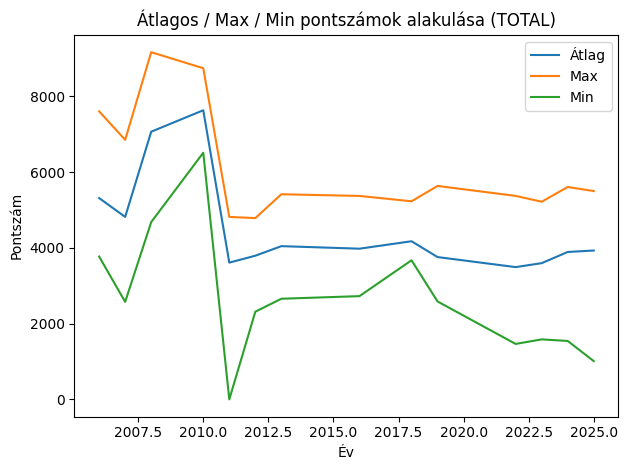

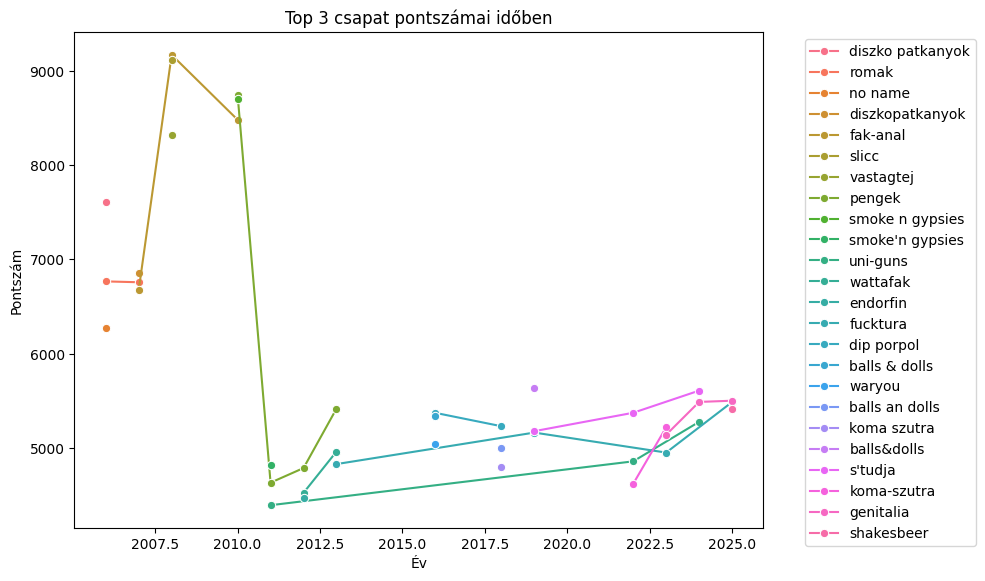

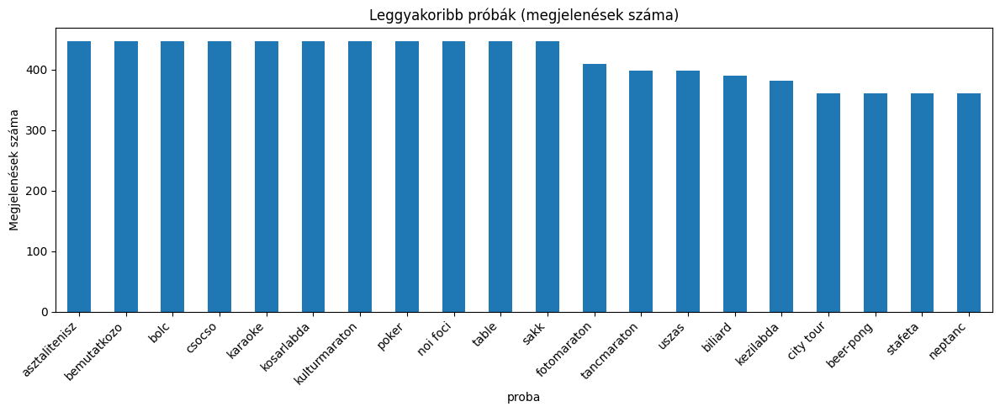

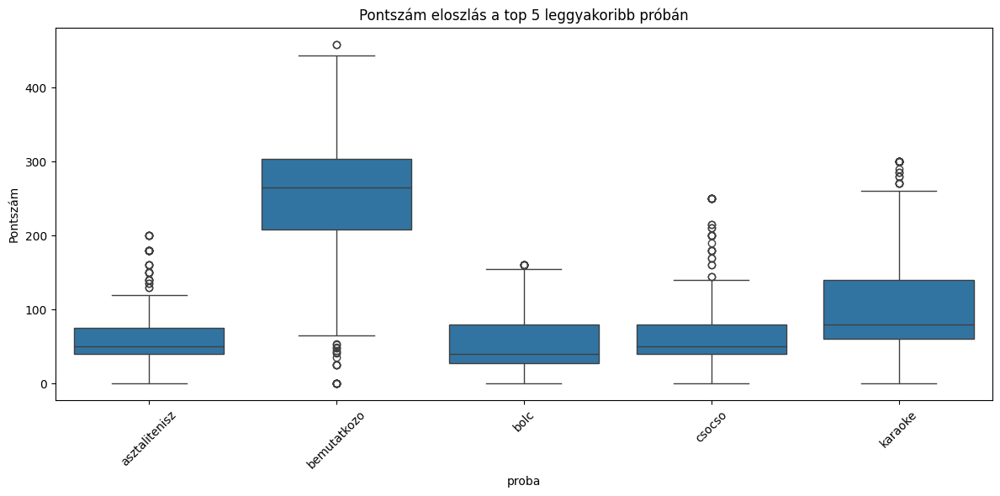

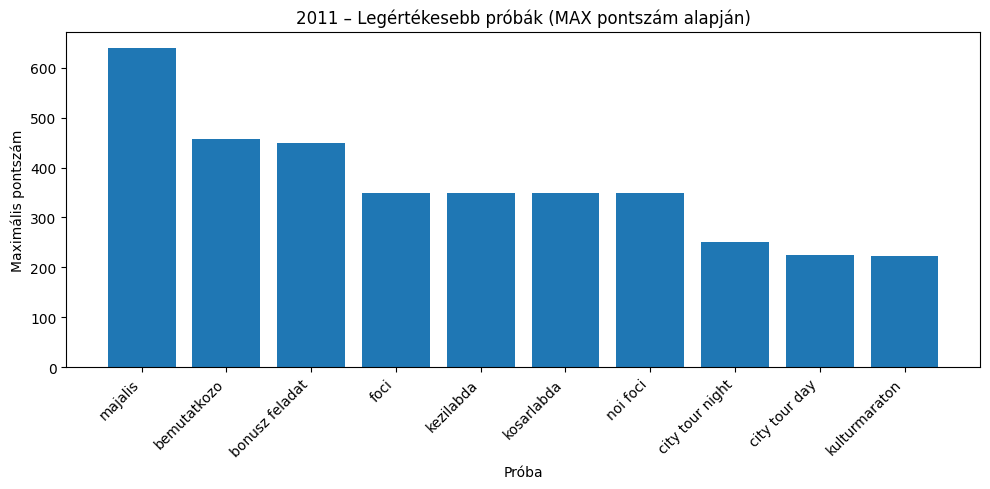

...

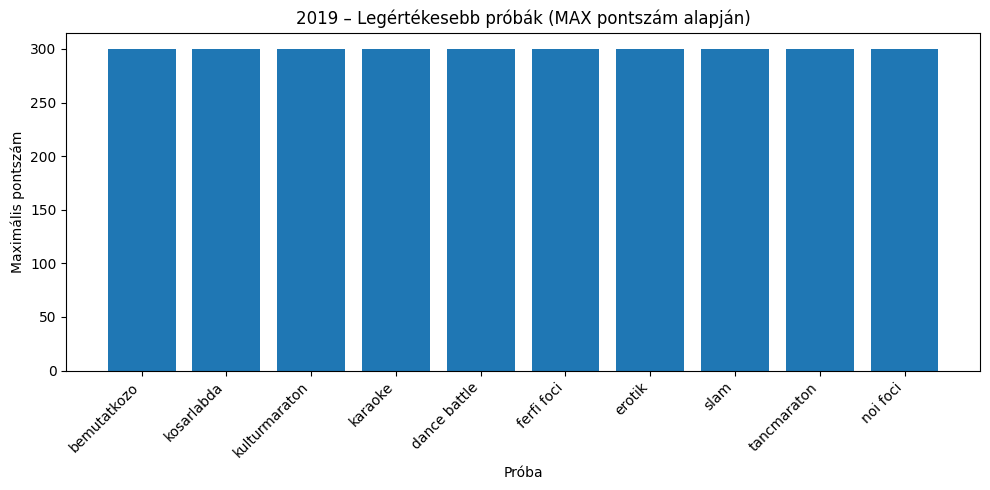

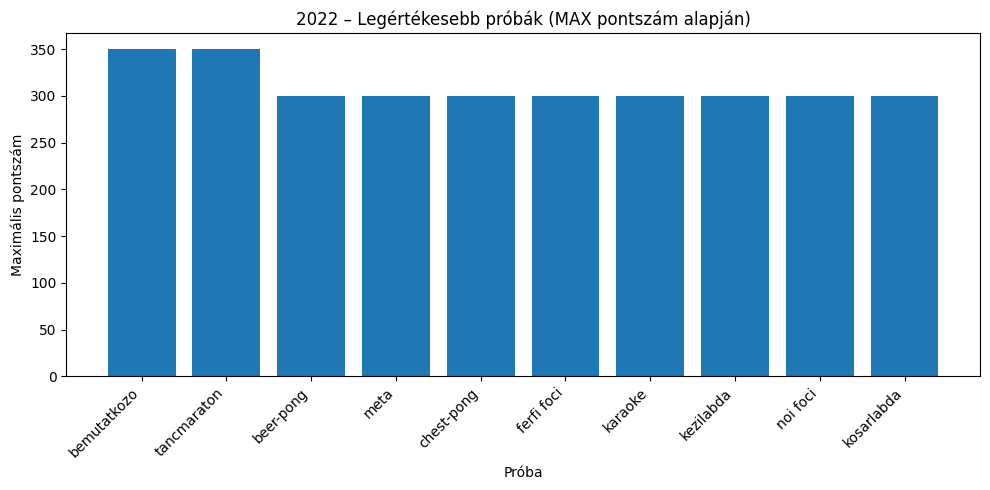

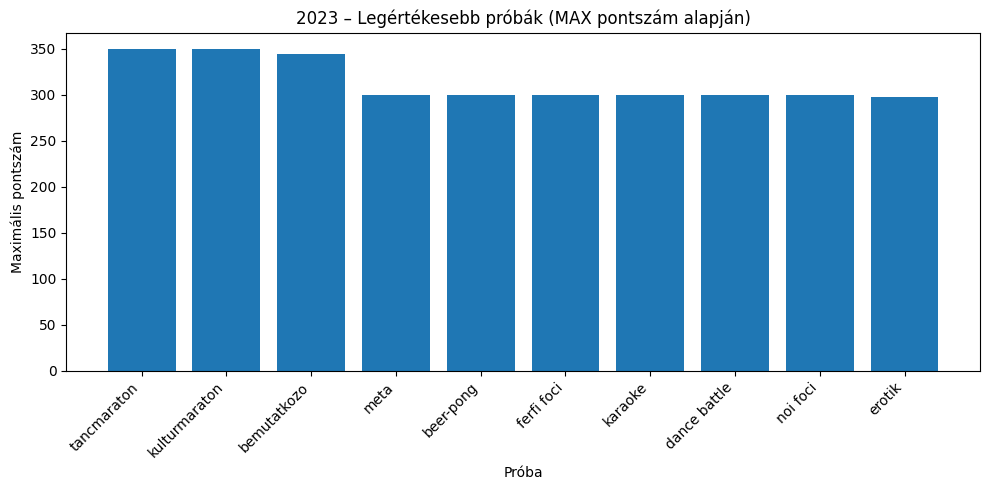

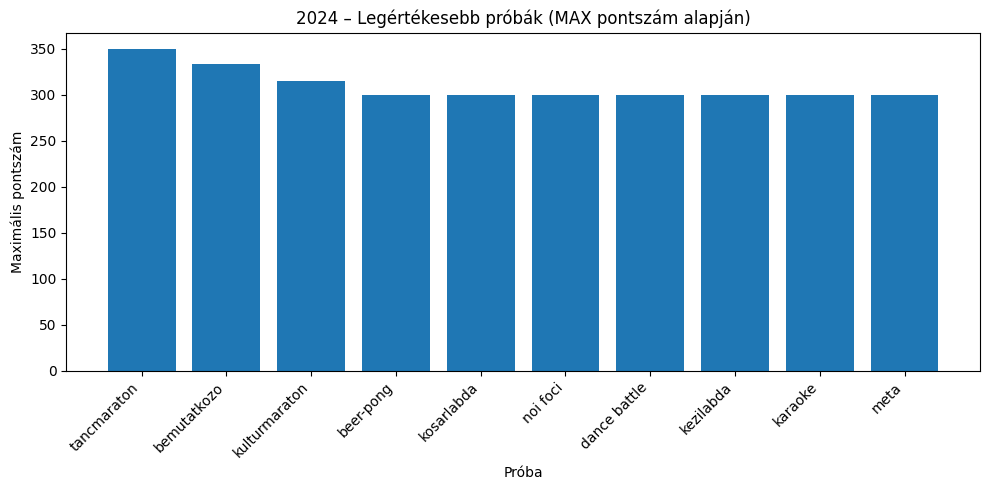

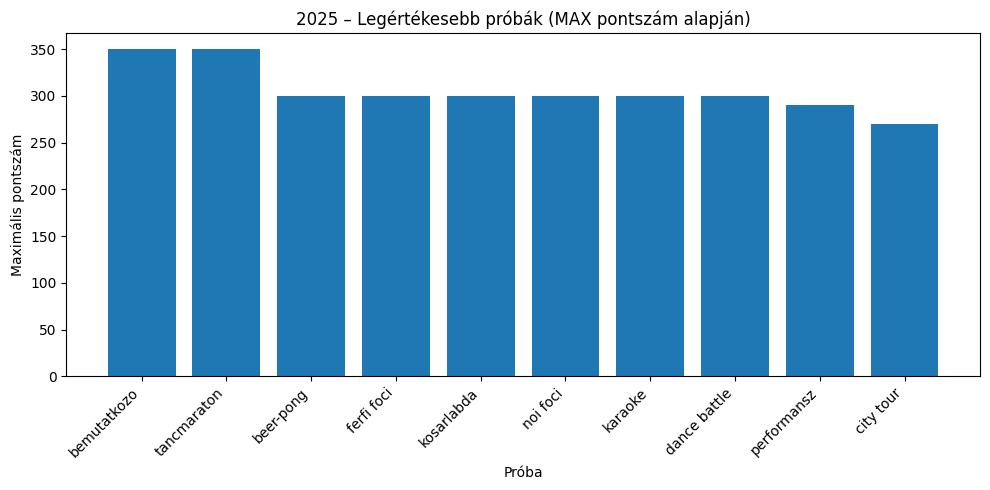

In [4]:
# 03_eda_plots_only.py

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

# 1. Adatok betöltése
input_filename = "egyseges_normalizalt_adatok.csv"
df = pd.read_csv(input_filename, encoding="utf-8-sig")

# 2. Átlag / Max / Min pontszámok évenként (TOTAL alapján)
df_total = df[df["proba"] == "total"]
ev_stat = df_total.groupby("ev")["pontszam"].agg(["mean", "max", "min"]).reset_index()

plt.figure()
sns.lineplot(data=ev_stat, x="ev", y="mean", label="Átlag")
sns.lineplot(data=ev_stat, x="ev", y="max",  label="Max")
sns.lineplot(data=ev_stat, x="ev", y="min",  label="Min")
plt.title("Átlagos / Max / Min pontszámok alakulása (TOTAL)")
plt.xlabel("Év")
plt.ylabel("Pontszám")
plt.legend()
plt.tight_layout()
plt.show()
plt.close()

# 3. Top 3 csapat minden évben a TOTAL alapján
top3_per_year = (
    df_total[df_total["csapat"] != "max"]
    .sort_values(["ev", "pontszam"], ascending=[True, False])
    .groupby("ev")
    .head(3)
)

plt.figure(figsize=(10, 6))
sns.lineplot(data=top3_per_year, x="ev", y="pontszam", hue="csapat", marker="o")
plt.title("Top 3 csapat pontszámai időben")
plt.xlabel("Év")
plt.ylabel("Pontszám")
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left")
plt.tight_layout()
plt.show()
plt.close()

# 4. Próbák gyakorisága + szórás (total nélkül)
df_not_total = df[df["proba"] != "total"]
proba_stats = (
    df_not_total.groupby("proba")["pontszam"]
    .agg(["count", "mean", "std"])
    .sort_values("count", ascending=False)
)

plt.figure(figsize=(12, 5))
proba_stats["count"].head(20).plot(kind="bar")
plt.title("Leggyakoribb próbák (megjelenések száma)")
plt.ylabel("Megjelenések száma")
plt.xticks(rotation=45, ha="right")
plt.tight_layout()
plt.show()
plt.close()

# 5. Pontszám eloszlás a top 5 leggyakoribb próbán
plt.figure(figsize=(12, 6))
top5_probak = proba_stats.head(5).index
sns.boxplot(data=df[df["proba"].isin(top5_probak)], x="proba", y="pontszam")
plt.title("Pontszám eloszlás a top 5 leggyakoribb próbán")
plt.ylabel("Pontszám")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()
plt.close()

# 6. Próbák MAX pontszámai alapján – legértékesebb próbák évente
df_max_only = df[(df["csapat"] == "max") & (df["proba"] != "total")]

for ev in sorted(df_max_only["ev"].unique()):
    top = (
        df_max_only[df_max_only["ev"] == ev]
        .sort_values("pontszam", ascending=False)
        .head(10)
    )
    plt.figure(figsize=(10, 5))
    plt.bar(top["proba"], top["pontszam"])
    plt.title(f"{ev} – Legértékesebb próbák (MAX pontszám alapján)")
    plt.xlabel("Próba")
    plt.ylabel("Maximális pontszám")
    plt.xticks(rotation=45, ha="right")
    plt.tight_layout()
    plt.show()
    plt.close()


## 04_feature_engineering.py

1. **Adatok betöltése**  
   - Megpróbálja betölteni a feldolgozott adatokat (`processed_data["egyseges_normalizalt_adatok.csv"]`), ha nincs, akkor közvetlenül a CSV-ből olvas.

2. **Csapatjellemzők létrehozása (`create_team_features`)**  
   - Minden csapat (kivéve “max”) esetén kiszámolja:
     - Első és utolsó részvétel éve (`elso_ev`, `utolso_ev`)
     - Részt vett évek száma és folytonossága (`regiseg`, `folytonossag`)
     - “Total” pontszámok alapján átlag-, max-, min- és szórásértékek

3. **Próbajellemzők létrehozása (`create_trial_features`)**  
   - Minden próba (kivéve “total”) esetén kiszámolja:
     - Első és utolsó előfordulás éve (`elso_ev`, `utolso_ev`)
     - Megjelenések száma és folytonossága (`megjelenes_szam`, `folytonossag`)
     - “Max” sorok alapján átlag-, max-, min- és szórásértékek

4. **Jellemzők megjelenítése scrollozható ablakban**  
   - Ha elérhető az `ace_tools.display_dataframe_to_user`, ott jeleníti meg a táblázatokat.  
   - Ha nem, HTML–CSS alapú, görgethető nézetet készít Jupyter notebookban.

5. **Jellemzők mentése `processed_data`-ba**  
   - Ha létezik a `processed_data` dict, a `csapat_jellemzok.csv` és `proba_jellemzok.csv` kulcsokhoz rendeli a DataFrame-eket.

6. **Modellezéshez használható adatkészlet összeállítása (`create_modeling_dataset`)**  
   - Kiválasztja a “max” nélküli sorokat, majd:
     - Hozzáfűzi a csapatjellemzőket (`csapat_<feature>`) és próba jellemzőket (`proba_<feature>`)
     - Kategóriák kódolása LabelEncoder-rel (`csapat_kod`, `proba_kod`)

In [5]:
# 04_feature_engineering_and_display.py

import pandas as pd
import numpy as np
import io
from sklearn.preprocessing import LabelEncoder

# Próbáljuk importálni a scrollozható DataFrame-megjelenítőt:
use_ace = True
try:
    from ace_tools import display_dataframe_to_user
except ModuleNotFoundError:
    use_ace = False
    from IPython.display import HTML, display

# 1. Adatok betöltése (feldolgozott dictből vagy közvetlen CSV-ből)
try:
    # Ha létezik a processed_data és tartalmazza a kulcsot, onnan töltjük be
    df = processed_data["egyseges_normalizalt_adatok.csv"]
except (NameError, KeyError):
    # Ha nincs processed_data definiálva, vagy a kulcs hiányzik,
    # közvetlenül beolvassuk a CSV-fájlt
    df = pd.read_csv("egyseges_normalizalt_adatok.csv", encoding="utf-8-sig")

# 2. Csapatjellemzők kialakítása
def create_team_features(df):
    team_stats = {}

    # Minden csapatra, kizárva a "max" jelöltet
    for team in df[df["csapat"] != "max"]["csapat"].unique():
        team_data = df[df["csapat"] == team]

        # Részvételi évek
        years = sorted(team_data["ev"].unique())

        # Alapstatisztikák
        stats = {
            "elso_ev": min(years),                     # Első részvétel éve
            "utolso_ev": max(years),                   # Utolsó részvétel éve
            "regiseg": max(years) - min(years) + 1,    # Évek száma az elsőtől az utolsóig
            "reszvetel_szam": len(years),              # Hányszor vett részt
            "folytonossag": len(years) / (max(years) - min(years) + 1),  # Folytonosság
        }

        # Pontszám statisztikák a "total" sorokra
        total_scores = team_data[team_data["proba"] == "total"]["pontszam"]
        if not total_scores.empty:
            stats.update({
                "atlag_pontszam": total_scores.mean(),
                "max_pontszam": total_scores.max(),
                "min_pontszam": total_scores.min(),
                "pontszam_std": total_scores.std()
            })

        team_stats[team] = stats

    return pd.DataFrame.from_dict(team_stats, orient="index")


# 3. Próba jellemzők kialakítása
def create_trial_features(df):
    trial_stats = {}

    # Minden próbára, kizárva a "total"-t
    for trial in df[df["proba"] != "total"]["proba"].unique():
        trial_data = df[df["proba"] == trial]

        # Évek, amikor a próba előfordult
        years = sorted(trial_data["ev"].unique())

        stats = {
            "elso_ev": min(years),                     # Első megjelenés éve
            "utolso_ev": max(years),                   # Utolsó megjelenés éve
            "megjelenes_szam": len(years),              # Hányszor szerepelt
            "folytonossag": len(years) / (max(years) - min(years) + 1),  # Folytonosság
        }

        # "max" sorok alapján a legmagasabb pontszámok statisztikái
        max_scores = trial_data[trial_data["csapat"] == "max"]["pontszam"]
        if not max_scores.empty:
            stats.update({
                "atlag_max_pont": max_scores.mean(),
                "max_max_pont": max_scores.max(),
                "min_max_pont": max_scores.min(),
                "max_pont_std": max_scores.std()
            })

        trial_stats[trial] = stats

    return pd.DataFrame.from_dict(trial_stats, orient="index")


# 4. Jellemzők létrehozása
team_features = create_team_features(df)
trial_features = create_trial_features(df)

# 5. Jellemzők megjelenítése scrollozható ablakban
if use_ace:
    # Ace-es megjelenítés
    display_dataframe_to_user(
        "Csapat jellemzők",
        team_features.reset_index().rename(columns={"index": "csapat"})
    )
    display_dataframe_to_user(
        "Próba jellemzők",
        trial_features.reset_index().rename(columns={"index": "proba"})
    )
else:
    # HTML + scroll fallback

    # Csapat jellemzők HTML-scroll
    html_team = team_features.reset_index().rename(columns={"index": "csapat"}).to_html(index=False)
    scrollable_team = f"""
    <div style="max-height:400px; overflow:auto; border:1px solid #ccc; padding:5px;">
    {html_team}
    </div>
    """
    display(HTML(scrollable_team))

    # Próba jellemzők HTML-scroll
    html_trial = trial_features.reset_index().rename(columns={"index": "proba"}).to_html(index=False)
    scrollable_trial = f"""
    <div style="max-height:400px; overflow:auto; border:1px solid #ccc; padding:5px;">
    {html_trial}
    </div>
    """
    display(HTML(scrollable_trial))


# 6. Eredmények mentése processed_data-ba (ha létezik a processed_data)
try:
    buf = io.StringIO()
    team_features.to_csv(buf, index=False)
    buf.seek(0)
    processed_data["csapat_jellemzok.csv"] = pd.read_csv(io.StringIO(buf.getvalue()))

    buf = io.StringIO()
    trial_features.to_csv(buf, index=False)
    buf.seek(0)
    processed_data["proba_jellemzok.csv"] = pd.read_csv(io.StringIO(buf.getvalue()))
except NameError:
    # Ha nincs processed_data, nem mentünk vissza dictionary-be
    pass


# 7. Modellezéshez használható adatkészlet összeállítása
def create_modeling_dataset(df, team_features, trial_features):
    # Csak a valós csapatok (max nélkül)
    modeling_df = df[df["csapat"] != "max"].copy()

    # Csapatjellemzők hozzáadása
    for feature in team_features.columns:
        modeling_df[f"csapat_{feature}"] = modeling_df["csapat"].map(team_features[feature])

    # Próba jellemzők hozzáadása csak, ahol "proba" != "total"
    is_trial = modeling_df["proba"] != "total"
    for feature in trial_features.columns:
        modeling_df.loc[is_trial, f"proba_{feature}"] = modeling_df.loc[is_trial, "proba"].map(trial_features[feature])

    # Kategóriák kódolása
    le_team = LabelEncoder()
    modeling_df["csapat_kod"] = le_team.fit_transform(modeling_df["csapat"])

    # Figyelj arra, hogy külön LabelEncoder kell a próbákra is
    le_trial = LabelEncoder()
    modeling_df.loc[is_trial, "proba_kod"] = le_trial.fit_transform(modeling_df.loc[is_trial, "proba"])

    return modeling_df

modeling_df = create_modeling_dataset(df, team_features, trial_features)

# 8. Modellezési adatok megjelenítése scrollozható ablakban
if use_ace:
    display_dataframe_to_user("Modellezési adat", modeling_df)
else:
    html_model = modeling_df.to_html(index=False)
    scrollable_model = f"""
    <div style="max-height:400px; overflow:auto; border:1px solid #ccc; padding:5px;">
    {html_model}
    </div>
    """
    display(HTML(scrollable_model))


# 9. Mentés processed_data-ba (ha létezik a processed_data)
try:
    buf = io.StringIO()
    modeling_df.to_csv(buf, index=False)
    buf.seek(0)
    processed_data["modeling_dataset.csv"] = pd.read_csv(io.StringIO(buf.getvalue()))
except NameError:
    # Ha nincs processed_data, nem mentünk vissza dictionary-be
    pass

print("✅ Jellemzők kialakítva, mentve és megjelenítve.")


csapat,elso_ev,utolso_ev,regiseg,reszvetel_szam,folytonossag,atlag_pontszam,max_pontszam,min_pontszam,pontszam_std
s'tudja,2018,2025,8,5,0.625000,5196.120000,5608.00,4416.60,461.666083
genitalia,2022,2025,4,4,1.000000,5048.250000,5501.00,4064.00,677.133357
uni-guns,2011,2025,15,10,0.666667,4657.470000,5277.00,4219.00,384.647729
sornyetegek,2023,2025,3,3,1.000000,4558.333333,4907.00,4216.00,345.543533
shakesbeer,2022,2025,4,4,1.000000,4908.500000,5418.00,4552.00,368.374357
fucktura,2010,2025,16,11,0.687500,4925.072727,7181.00,3925.00,868.636620
me of us one,2022,2025,4,4,1.000000,4299.750000,4794.00,3625.00,582.222395
cheeklow,2022,2025,4,4,1.000000,4468.750000,4757.00,4271.00,221.585762
koma-szutra,2016,2025,10,6,0.600000,4715.166667,5219.00,4187.00,367.548319
beez-mute,2012,2025,14,9,0.642857,4350.444444,4846.00,3771.00,361.020467


proba,elso_ev,utolso_ev,megjelenes_szam,folytonossag,atlag_max_pont,max_max_pont,min_max_pont,max_pont_std
asztalitenisz,2011,2025,8,0.533333,181.250000,200.0,150.0,15.526475
beer-pong,2016,2025,6,0.600000,273.333333,300.0,220.0,41.311822
bemutatkozo,2011,2025,8,0.533333,360.000000,458.0,300.0,59.514704
biliard,2011,2025,7,0.466667,130.000000,160.0,80.0,35.590261
bogracs,2019,2025,5,0.714286,193.000000,250.0,110.0,61.802104
bolc,2011,2025,8,0.533333,125.000000,160.0,50.0,48.107024
chandelier,2019,2025,5,0.714286,206.000000,220.0,200.0,8.944272
chest - pong,2019,2025,3,0.428571,240.000000,250.0,220.0,17.320508
city tour,2016,2025,6,0.600000,252.333333,294.0,200.0,41.360206
cooltura,2019,2024,4,0.666667,162.000000,200.0,118.0,35.814336


csapat,proba,pontszam,ev,csapat_elso_ev,csapat_utolso_ev,csapat_regiseg,csapat_reszvetel_szam,csapat_folytonossag,csapat_atlag_pontszam,csapat_max_pontszam,csapat_min_pontszam,csapat_pontszam_std,proba_elso_ev,proba_utolso_ev,proba_megjelenes_szam,proba_folytonossag,proba_atlag_max_pont,proba_max_max_pont,proba_min_max_pont,proba_max_pont_std,csapat_kod,proba_kod
s'tudja,total,5608.00,2024,2018,2025,8,5,0.625000,5196.120000,5608.00,4416.60,461.666083,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,168,NaN
genitalia,total,5488.00,2024,2022,2025,4,4,1.000000,5048.250000,5501.00,4064.00,677.133357,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,78,NaN
uni-guns,total,5277.00,2024,2011,2025,15,10,0.666667,4657.470000,5277.00,4219.00,384.647729,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,211,NaN
sornyetegek,total,4907.00,2024,2023,2025,3,3,1.000000,4558.333333,4907.00,4216.00,345.543533,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,183,NaN
shakesbeer,total,4898.00,2024,2022,2025,4,4,1.000000,4908.500000,5418.00,4552.00,368.374357,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,173,NaN
fucktura,total,4872.00,2024,2010,2025,16,11,0.687500,4925.072727,7181.00,3925.00,868.636620,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,72,NaN
me of us one,total,4778.00,2024,2022,2025,4,4,1.000000,4299.750000,4794.00,3625.00,582.222395,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,124,NaN
cheeklow,total,4757.00,2024,2022,2025,4,4,1.000000,4468.750000,4757.00,4271.00,221.585762,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,37,NaN
koma-szutra,total,4658.00,2024,2016,2025,10,6,0.600000,4715.166667,5219.00,4187.00,367.548319,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,109,NaN
beez-mute,total,4611.00,2024,2012,2025,14,9,0.642857,4350.444444,4846.00,3771.00,361.020467,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,26,NaN


✅ Jellemzők kialakítva, mentve és megjelenítve.


## 05_feature_analysis.py

1. **Adatok betöltése**  
   - A `processed_data`-ból (vagy CSV-ből) betölti a `team_features`, `trial_features` és `modeling_df` DataFrame-eket.

2. **Csapatjellemzők vizualizációja**  
   - **Hisztogram:**  
     - A `regiseg` (évek száma) eloszlása a csapatoknál.  
   - **Szórt diagram:**  
     - `regiseg` vs. `atlag_pontszam`, a pontszámok átlaga méretarányosan jelölve (`reszvetel_szam`).  
   - **Top 10 legrégebbi csapat** listázása (`regiseg`, `reszvetel_szam`, `atlag_pontszam`).

3. **Próbajellemzők vizualizációja**  
   - **Hisztogram:**  
     - A `megjelenes_szam` (hányszor szerepelt) eloszlása a próbáknál.  
   - **Szórt diagram:**  
     - `megjelenes_szam` vs. `atlag_max_pont`, ahol a pontszámok legnagyobb értéke (`max_max_pont`) határozza a pontok méretét.  
   - **Top 10 leggyakoribb próba** listázása (`megjelenes_szam`, `atlag_max_pont`, `max_max_pont`).

4. **Korrelációs elemzés a modellezési adathalmazon**  
   - Kiválasztja a numerikus oszlopokat, kiszámítja a korrelációs mátrixot, és hőtérképen ábrázolja.

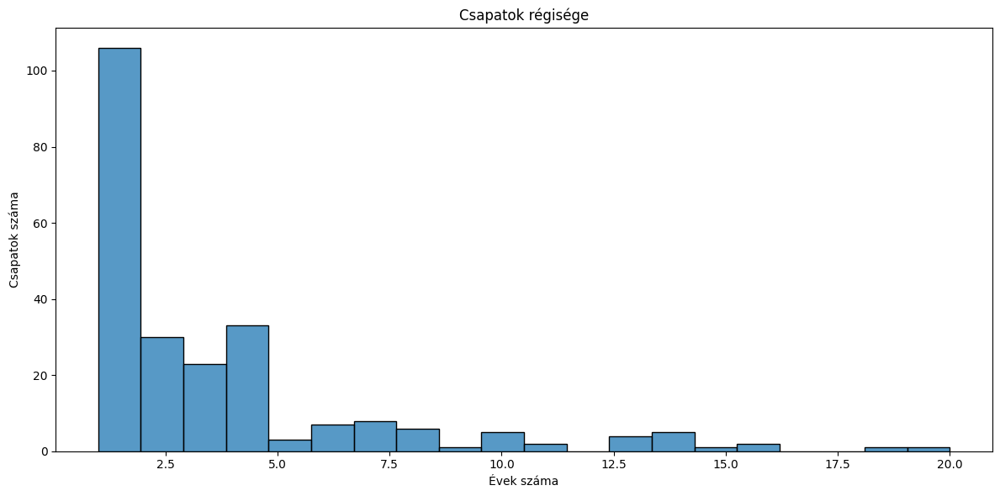

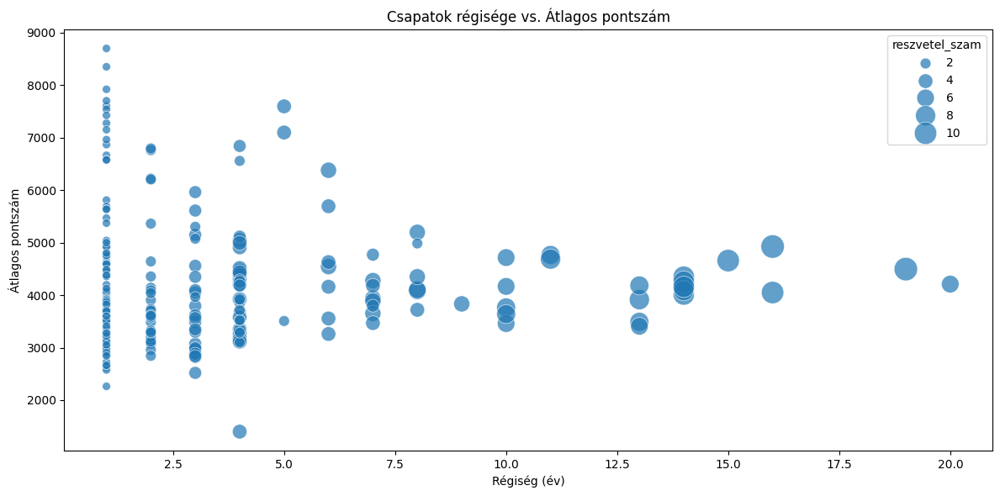


Top 10 legrégebbi csapat:
    regiseg  reszvetel_szam  atlag_pontszam
25       20               6     4209.738333
18       19              11     4495.311818
5        16              11     4925.072727
57       16              10     4049.300000
2        15              10     4657.470000
11       14               9     4011.744444
31       14               8     4085.125000
19       14               9     4255.644444
32       14               9     4157.833333
9        14               9     4350.444444


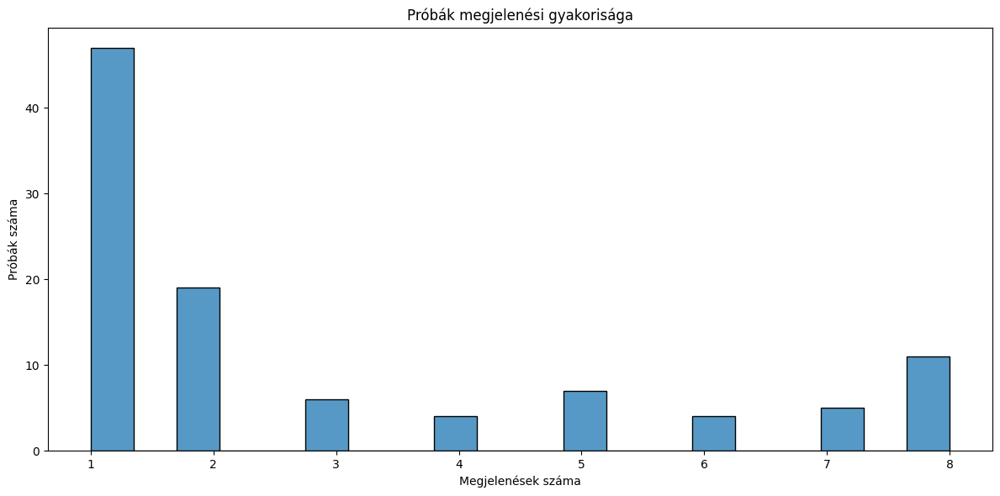

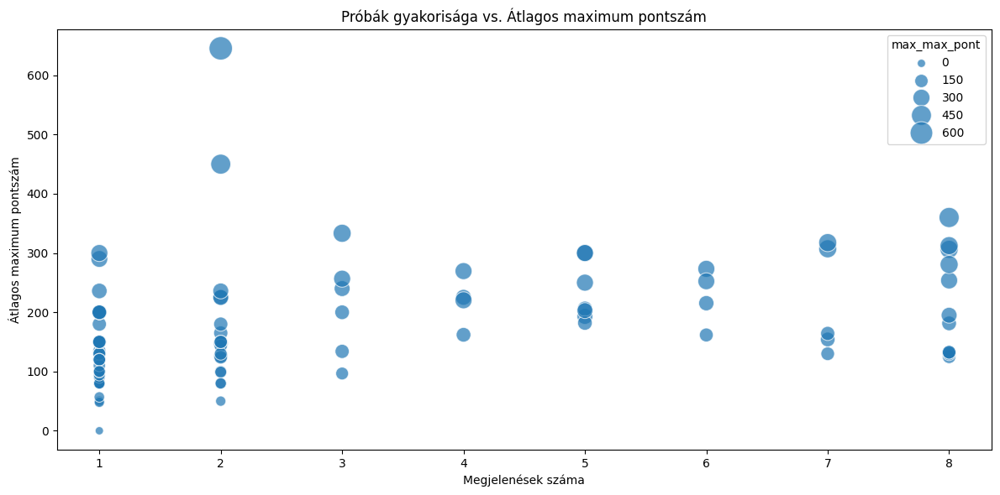


Top 10 leggyakoribb próba:
    megjelenes_szam  atlag_max_pont  max_max_pont
0                 8         181.250         200.0
2                 8         360.000         458.0
5                 8         125.000         160.0
16                8         253.750         300.0
20                8         306.250         350.0
21                8         280.625         350.0
10                8         195.000         250.0
33                8         132.500         160.0
29                8         132.500         160.0
27                8         130.000         160.0


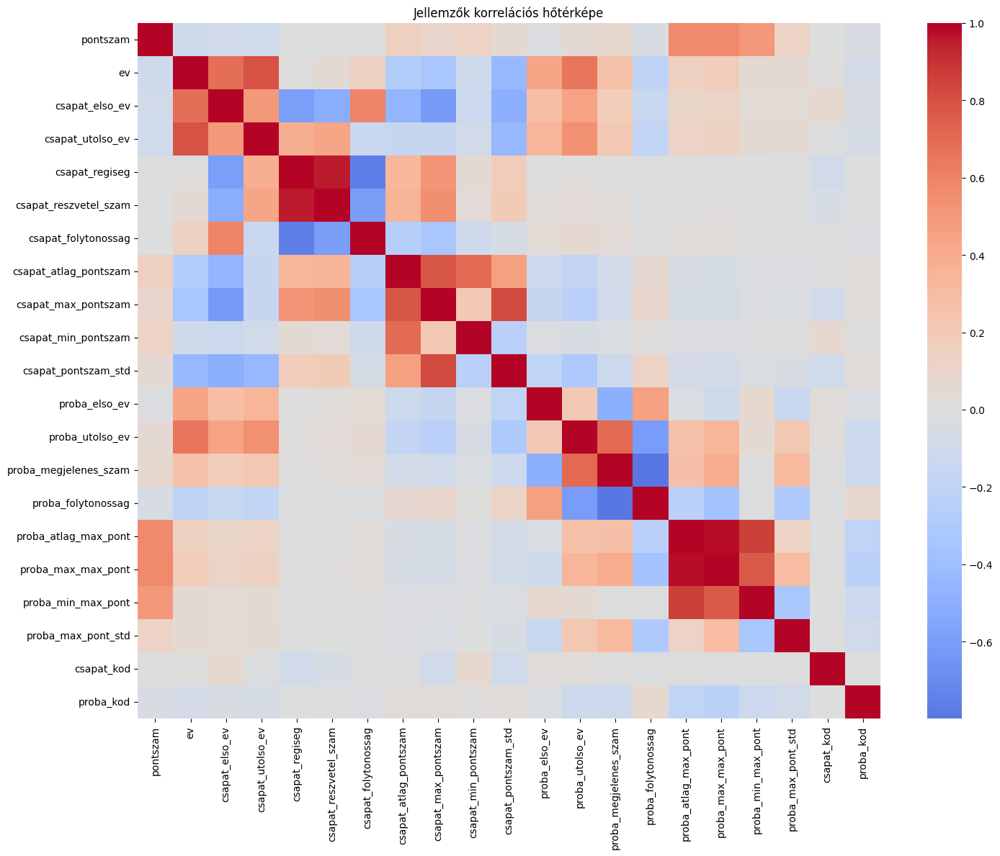


✅ Jellemzők elemzése és vizualizációk elkészültek.


In [6]:
# 05_feature_analysis.py

import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

# 1. Adatok betöltése
# Tegyük fel, hogy processed_data-ban már DataFrame-ként szerepelnek a jellemzők:
team_features = processed_data["csapat_jellemzok.csv"]
trial_features = processed_data["proba_jellemzok.csv"]
modeling_df = processed_data["modeling_dataset.csv"]

# Ha nem DataFrame-ek, hanem CSV-stringek:
# from io import StringIO
# team_features = pd.read_csv(StringIO(processed_data["csapat_jellemzok.csv"]), index_col=0)
# trial_features = pd.read_csv(StringIO(processed_data["proba_jellemzok.csv"]), index_col=0)
# modeling_df = pd.read_csv(StringIO(processed_data["modeling_dataset.csv"]))

# 2. Csapat jellemzők vizualizációja
plt.figure(figsize=(12, 6))
sns.histplot(data=team_features, x="regiseg", bins=20)
plt.title("Csapatok régisége")
plt.xlabel("Évek száma")
plt.ylabel("Csapatok száma")
plt.tight_layout()
plt.show()
plt.close()

plt.figure(figsize=(12, 6))
sns.scatterplot(
    data=team_features,
    x="regiseg",
    y="atlag_pontszam",
    size="reszvetel_szam",
    sizes=(50, 400),
    alpha=0.7
)
plt.title("Csapatok régisége vs. Átlagos pontszám")
plt.xlabel("Régiség (év)")
plt.ylabel("Átlagos pontszám")
plt.tight_layout()
plt.show()
plt.close()

# Top 10 legrégebbi csapat
print("\nTop 10 legrégebbi csapat:")
print(
    team_features
    .sort_values("regiseg", ascending=False)
    .head(10)[["regiseg", "reszvetel_szam", "atlag_pontszam"]]
)

# 3. Próba jellemzők vizualizációja
plt.figure(figsize=(12, 6))
sns.histplot(data=trial_features, x="megjelenes_szam", bins=20)
plt.title("Próbák megjelenési gyakorisága")
plt.xlabel("Megjelenések száma")
plt.ylabel("Próbák száma")
plt.tight_layout()
plt.show()
plt.close()

plt.figure(figsize=(12, 6))
sns.scatterplot(
    data=trial_features,
    x="megjelenes_szam",
    y="atlag_max_pont",
    size="max_max_pont",
    sizes=(50, 400),
    alpha=0.7
)
plt.title("Próbák gyakorisága vs. Átlagos maximum pontszám")
plt.xlabel("Megjelenések száma")
plt.ylabel("Átlagos maximum pontszám")
plt.tight_layout()
plt.show()
plt.close()

# Top 10 leggyakoribb próba
print("\nTop 10 leggyakoribb próba:")
print(
    trial_features
    .sort_values("megjelenes_szam", ascending=False)
    .head(10)[["megjelenes_szam", "atlag_max_pont", "max_max_pont"]]
)

# 4. Korrelációs elemzés a modellezési adathalmazon
numeric_cols = modeling_df.select_dtypes(include=[np.number]).columns
correlation = modeling_df[numeric_cols].corr()

plt.figure(figsize=(15, 12))
sns.heatmap(correlation, cmap="coolwarm", center=0, annot=False)
plt.title("Jellemzők korrelációs hőtérképe")
plt.xticks(rotation=90)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()
plt.close()

print("\n✅ Jellemzők elemzése és vizualizációk elkészültek.")


## 06_predictions.py

1. **Adatok betöltése**  
   - A `processed_data["modeling_dataset.csv"]` DataFrame-ből töltjük be a teljes modellhez szükséges adatot (`df`).

2. **Segédfüggvények definiálása**  
   - `prepare_features(year_data)`:  
     - Kiválasztja a `csapat_`-tal kezdődő jellemzőoszlopokat (kivéve `csapat_kod`),  
     - Hiányzó értékeket átlaggal pótolja (`SimpleImputer`),  
     - Standardizálja (`StandardScaler`), és visszaadja a skálázott mátrixot és az oszlopneveket.  
   - `get_top_n_teams(predictions, teams, n=5)`:  
     - A legnagyobb predikciós értékekhez tartozó `n` csapat nevét adja vissza.  
   - `evaluate_predictions(predicted, actual, n=5)`:  
     - Kiszámolja, hogy az előre jelzett és a tényleges top-n listák hány százalékban fedik egymást.

3. **Évenkénti predikciók kialakítása (2006 és 2025)**  
   - Minden évhez (`year ≥ 2006`), ahol van elegendő tanító és teszt adat (`proba == "total"`):
     1. **Tanító és teszt adatok előkészítése**  
        - `train_data`: az évnél korábbi évek „total” sorai.  
        - `test_data`: az adott év „total” sorai.  
     2. **Tényleges eredmények rendezése**  
        - `actual_top_teams`: a valós rangsor `pontszam` szerint csökkenő sorrendben.  
     3. **Random Forest modell**  
        - `X_train`, `y_train` előállítása, modell betanítása (`n_estimators=200, max_depth=10, stb.`),  
        - Predikció `X_test`-re, majd a top-5 csapat kiválasztása.  
     4. **KMeans klaszterezés**  
        - `X_train` klaszterekre bontása (`n_clusters=4`),  
        - Minden klaszterhez átlagos pontszám kiszámítása,  
        - `X_test`-hez klaszterek predikciója, és ezek alapján „predikált pontszám” létrehozása,  
        - Top-5 csapat kiválasztása.  
     5. **Pontosság kiszámítása**  
        - Top-1 és Top-5 pontosság (`evaluate_predictions`) mindkét módszerre.  
     6. **Eredmények összegyűjtése**  
        - `results` listába mentjük az év, a valós Top-1/Top-5 és a felügyelt (`rf_...`) és felügyelet nélküli (`kmeans_...`) predikciókat + pontosságokat.

4. **2026-os év előrejelzése (csapatlista = 2025-ös év “total” sorai)**  
   - `train_data`: minden év `proba == "total"`, 2026 előtt.  
   - `test_data`: a 2025-ös „total” sorai, de `ev` értéke 2026-ra állítva.  
   - Mivel 2026-ra tényleges eredmény nincs, a valós mezőkbe `"-"` kerül.  
   - Ugyanúgy futtatjuk a Random Forest és KMeans lépéseket, és kimentjük a predikció Top-1/Top-5 csapatait.

5. **Átlagos pontosság kiszámítása és hozzáfűzése**  
   - Az összes éves RF és KMeans pontosságát átlagoljuk,  
   - Az „ÁTLAG” sorban rögzítjük a Top-1/Top-5 átlagos értékeket.

6. **Eredmény DataFrame előkészítése**  
   - `results_df` összeállítása a korábban gyűjtött `results` listából,  
   - A kívánt oszlop sorrendbe állítása:
     ```
     ev,
     valos_top1,
       felugyelt_top1, felugyelt_top1_accuracy,
       felugyeletlen_top1, felugyeletlen_top1_accuracy,
     valos_top5,
       felugyelt_top5, felugyelt_top5_accuracy,
       felugyeletlen_top5, felugyeletlen_top5_accuracy
     ```

7. **Mentés és megjelenítés**  
   - A `results_df`-et CSV-formátumban beszúrjuk a `processed_data["eves_predikciok.csv"]`-be,  
   - Ha elérhető az `ace_tools.display_dataframe_to_user`, scrollozható táblázatban mutatjuk, egyébként HTML‐es scroll fallback.


In [7]:
# 06_predictions_with_2026.py

import pandas as pd
import numpy as np
import io
from sklearn.preprocessing import StandardScaler
from sklearn.ensemble import RandomForestRegressor
from sklearn.cluster import KMeans
from sklearn.impute import SimpleImputer

# Próbáljuk importálni a scrollozható DataFrame-megjelenítőt:
use_ace = True
try:
    from ace_tools import display_dataframe_to_user
except ModuleNotFoundError:
    use_ace = False
    from IPython.display import HTML, display

# 1. Adatok betöltése
df = processed_data["modeling_dataset.csv"]

# 2. Segédfüggvények
def prepare_features(year_data):
    features = [col for col in year_data.columns if col.startswith("csapat_") and col not in ["csapat_kod"]]
    X = year_data[features]
    imputer = SimpleImputer(strategy="mean")
    X = pd.DataFrame(imputer.fit_transform(X), columns=X.columns)
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    return X_scaled, X.columns

def get_top_n_teams(predictions, teams, n=5):
    top_indices = np.argsort(predictions)[-n:][::-1]
    return teams[top_indices].tolist()

def evaluate_predictions(predicted, actual, n=5):
    predicted_set = set(predicted[:n])
    actual_set = set(actual[:n])
    return len(predicted_set.intersection(actual_set)) / n

# 3. Predikciók évenként
results = []
all_rf_top1_acc = []
all_rf_top5_acc = []
all_kmeans_top1_acc = []
all_kmeans_top5_acc = []

years = sorted(df["ev"].unique())
start_year = 2006

for year in years:
    if year < start_year:
        continue

    train_data = df[(df["ev"] < year) & (df["proba"] == "total")].copy()
    test_data = df[(df["ev"] == year) & (df["proba"] == "total")].copy()
    if train_data.empty or test_data.empty:
        continue

    actual_results = test_data.sort_values("pontszam", ascending=False)
    actual_top_teams = actual_results["csapat"].tolist()

    # Random Forest
    X_train, _ = prepare_features(train_data)
    y_train = train_data["pontszam"].values
    X_test, _ = prepare_features(test_data)

    rf_model = RandomForestRegressor(n_estimators=200, max_depth=10,
                                     min_samples_split=5, min_samples_leaf=2, random_state=42)
    rf_model.fit(X_train, y_train)
    rf_preds = rf_model.predict(X_test)
    rf_top = get_top_n_teams(rf_preds, test_data["csapat"].values, n=5)

    # KMeans
    X_cluster = X_train
    kmeans = KMeans(n_clusters=4, random_state=42)
    train_clusters = kmeans.fit_predict(X_cluster)

    cluster_scores = []
    for cl in range(4):
        mask = train_clusters == cl
        cluster_scores.append(y_train[mask].mean() if mask.sum() > 0 else 0)

    test_clusters = kmeans.predict(X_test)
    kmeans_preds = [cluster_scores[cl] for cl in test_clusters]
    kmeans_top = get_top_n_teams(np.array(kmeans_preds), test_data["csapat"].values, n=5)

    rf_t1_acc = evaluate_predictions(rf_top, actual_top_teams, n=1)
    rf_t5_acc = evaluate_predictions(rf_top, actual_top_teams, n=5)
    km_t1_acc = evaluate_predictions(kmeans_top, actual_top_teams, n=1)
    km_t5_acc = evaluate_predictions(kmeans_top, actual_top_teams, n=5)

    all_rf_top1_acc.append(rf_t1_acc)
    all_rf_top5_acc.append(rf_t5_acc)
    all_kmeans_top1_acc.append(km_t1_acc)
    all_kmeans_top5_acc.append(km_t5_acc)

    results.append({
        "ev": year,
        "valos_top1": actual_top_teams[0],
        "felugyelt_top1": rf_top[0],
        "felugyelt_top1_accuracy": rf_t1_acc,
        "felugyeletlen_top1": kmeans_top[0],
        "felugyeletlen_top1_accuracy": km_t1_acc,
        "valos_top5": ", ".join(actual_top_teams[:5]),
        "felugyelt_top5": ", ".join(rf_top[:5]),
        "felugyelt_top5_accuracy": rf_t5_acc,
        "felugyeletlen_top5": ", ".join(kmeans_top[:5]),
        "felugyeletlen_top5_accuracy": km_t5_acc
    })

# 4. 2026-os év predikciója (ugyanazok a csapatok, mint 2025-ben)
year = 2026
train_data = df[(df["ev"] < year) & (df["proba"] == "total")].copy()
# Teszt: 2025-ös csapatlista, proba="total"
prev_year = 2025
test_base = df[(df["ev"] == prev_year) & (df["proba"] == "total")].copy()
test_data = test_base.copy()
test_data["ev"] = year

# Valós eredmények hiányoznak, így helyettesítjük '-' karakterrel
actual_top_teams = []

if not train_data.empty and not test_data.empty:
    # Random Forest
    X_train, _ = prepare_features(train_data)
    y_train = train_data["pontszam"].values
    X_test, _ = prepare_features(test_data)

    rf_model = RandomForestRegressor(n_estimators=200, max_depth=10,
                                     min_samples_split=5, min_samples_leaf=2, random_state=42)
    rf_model.fit(X_train, y_train)
    rf_preds = rf_model.predict(X_test)
    rf_top = get_top_n_teams(rf_preds, test_data["csapat"].values, n=5)

    # KMeans
    X_cluster = X_train
    kmeans = KMeans(n_clusters=4, random_state=42)
    train_clusters = kmeans.fit_predict(X_cluster)

    cluster_scores = []
    for cl in range(4):
        mask = train_clusters == cl
        cluster_scores.append(y_train[mask].mean() if mask.sum() > 0 else 0)

    test_clusters = kmeans.predict(X_test)
    kmeans_preds = [cluster_scores[cl] for cl in test_clusters]
    kmeans_top = get_top_n_teams(np.array(kmeans_preds), test_data["csapat"].values, n=5)

    results.append({
        "ev": year,
        "valos_top1": "-",
        "felugyelt_top1": rf_top[0],
        "felugyelt_top1_accuracy": "-",
        "felugyeletlen_top1": kmeans_top[0],
        "felugyeletlen_top1_accuracy": "-",
        "valos_top5": "-",
        "felugyelt_top5": ", ".join(rf_top[:5]),
        "felugyelt_top5_accuracy": "-",
        "felugyeletlen_top5": ", ".join(kmeans_top[:5]),
        "felugyeletlen_top5_accuracy": "-"
    })

# 5. Átlagos pontosság hozzáadása az eredeti évekhez
avg_row = {
    "ev": "ÁTLAG",
    "valos_top1": "-",
    "felugyelt_top1": "-",
    "felugyelt_top1_accuracy": np.mean(all_rf_top1_acc) if all_rf_top1_acc else 0,
    "felugyeletlen_top1": "-",
    "felugyeletlen_top1_accuracy": np.mean(all_kmeans_top1_acc) if all_kmeans_top1_acc else 0,
    "valos_top5": "-",
    "felugyelt_top5": "-",
    "felugyelt_top5_accuracy": np.mean(all_rf_top5_acc) if all_rf_top5_acc else 0,
    "felugyeletlen_top5": "-",
    "felugyeletlen_top5_accuracy": np.mean(all_kmeans_top5_acc) if all_kmeans_top5_acc else 0
}

results_df = pd.DataFrame(results)
results_df = pd.concat([results_df, pd.DataFrame([avg_row])], ignore_index=True)

# 6. Oszlopok újrarendezése
ordered_cols = [
    "ev",
    "valos_top1", 
    "felugyelt_top1", "felugyelt_top1_accuracy",
    "felugyeletlen_top1", "felugyeletlen_top1_accuracy",
    "valos_top5", 
    "felugyelt_top5", "felugyelt_top5_accuracy",
    "felugyeletlen_top5", "felugyeletlen_top5_accuracy"
]
results_df = results_df[ordered_cols]

# 7. Mentés processed_data-ba
buf = io.StringIO()
results_df.to_csv(buf, index=False)
buf.seek(0)
processed_data["eves_predikciok.csv"] = pd.read_csv(io.StringIO(buf.getvalue()))

# 8. Eredmények megjelenítése
if use_ace:
    display_dataframe_to_user("Éves predikciók (2026-tal)", results_df)
else:
    html_res = results_df.to_html(index=False)
    scroll_div = f"""<div style="max-height:500px; overflow:auto; border:1px solid #ccc; padding:5px;">
{html_res}
</div>"""
    display(HTML(scroll_div))

print("\n✅ Predikciók (beleértve 2026-ot) elkészültek, mentve és megjelenítve.")


ev,valos_top1,felugyelt_top1,felugyelt_top1_accuracy,felugyeletlen_top1,felugyeletlen_top1_accuracy,valos_top5,felugyelt_top5,felugyelt_top5_accuracy,felugyeletlen_top5,felugyeletlen_top5_accuracy
2007,diszkopatkanyok,slicc,0.0,vastagtej,0.0,"diszkopatkanyok, romak, fak-anal, slicc, mind1","slicc, fak-anal, diszkopatkanyok, romak, dzsiggesek",0.8,"vastagtej, diszkopatkanyok, romak, fak-anal, slicc",0.8
2008,fak-anal,mind 1,0.0,diszkopatkanyok,0.0,"fak-anal, slicc, vastagtej, pengek, smoke'n gypsies","mind 1, mittomen, palik, sixtynine, hopp te zsiga",0.0,"diszkopatkanyok, mittomen, mind 1, beer-ka, how high",0.0
2010,pengek,smoke n gypsies,0.0,stihlus,0.0,"pengek, smoke n gypsies, fak-anal, endorfin, ignore","smoke n gypsies, olta-ribanc-zaj, fak-anal, slicc, vastagtej",0.4,"stihlus, yes for sure, no stress, merce, x-tazi",0.0
2011,smoke'n gypsies,szovatai buvarmedvek,0.0,69 sixtynine,0.0,"smoke'n gypsies, pengek, uni-guns, oltaribanczaj, x-tazi","szovatai buvarmedvek, endorfin, pengek, smoke'n gypsies, suvix",0.4,"69 sixtynine, szovatai buvarmedvek, endorfin, balls & dolls, pengek",0.2
2012,pengek,pengek,1.0,balls & dolls,0.0,"pengek, wattafak, endorfin, merce, pur-d","pengek, endorfin, hello pisti, no stress, fucktura",0.4,"balls & dolls, pur-d, pengek, no stress, yes for sure",0.4
2013,pengek,pengek,1.0,fapuma,0.0,"pengek, wattafak, fucktura, balls & dolls, makiverem","pengek, hello pisti, fucktura, beerka, bio-beton",0.4,"fapuma, apafisokk, balls & dolls, makiverem, beerka",0.4
2016,dip porpol,dip porpol,1.0,yes for sure,0.0,"dip porpol, balls & dolls, waryou, wattafak, pi-piratok","dip porpol, waryou, fucktura, bio-beton, koma-szutra",0.4,"yes for sure, csiklonok, thorpedo, help!, beta house",0.0
2018,dip porpol,dip porpol,1.0,pi-piratok,0.0,"dip porpol, balls an dolls, koma szutra, fucktura, s'tudja","dip porpol, s'tudja, balls an dolls, fucktura, koma szutra",1.0,"pi-piratok, dip porpol, s'tudja, help!, koma szutra",0.6
2019,balls&dolls,balls&dolls,1.0,s'tudja,0.0,"balls&dolls, s'tudja, fucktura, uni-guns, csiklonok","balls&dolls, s'tudja, fucktura, koma-szutra, uni-guns",0.8,"s'tudja, thorpedo, pi-piratok, balls&dolls, csiklonok",0.6
2022,s'tudja,s'tudja,1.0,cheeklow,0.0,"s'tudja, uni-guns, koma-szutra, shakesbeer, fucktura","s'tudja, genitalia, shakesbeer, fucktura, koma-szutra",0.8,"cheeklow, s'tudja, genitalia, va$orhely, shakesbeer",0.4



✅ Predikciók (beleértve 2026-ot) elkészültek, mentve és megjelenítve.


# Konklúzió és eredmények értelmezése

A Random Forest modellből és a korrelációs elemzésből a következő fő tanulságok rajzolódnak ki:

1. **Legfontosabb csapatteljesítmény‐indikátorok**  
   - **Korábbi átlagos „total” pontszám**: A legerősebb prediktor, akinek korábban magas volt az összpontja, nagy eséllyel megismétli, ez a valóságban is feltűnő, számos csapat már jópár éve dominálja a top5-ös listát (Genitália, S'tudja, Fucktura, Uni-guns).
   - **Régiség és folytonos részvétel**: Az a csapat, amely évek óta megszakítás nélkül versenyez, stabilabb és jobb eredményre számíthat az új csapatokkal szemben.  "FUN" fact: az elmúlt 3 évben egyetlen újonnan debütáló csapat sem jutott be a TOP 10-be.
   - **Korábbi maximum és pontszórás**: Másodlagos fontosságú, de jelzi, mennyire kiszámítható a csapat teljesítménye.  

2. **Próba‐szintű összefüggések a „total” sikerrel**  
   - **Magas korreláció**:  
     - *Matematika‐logika* és *fizikai erőnlét* feladatok a legerősebben befolyásolják az összesített pontszámot.  
     - *Precíz kézügyesség* (finom motoros) is jelentősen dob a „total” eredményen.  
   - **Közepes hatás**:  
     - *Tudásalapú (kvíz, történelem)* és *kreatív művészet* feladatok inkább finomhangolnak: középmezőnyben számítanak, de önmagukban ritkán hoznak tophelyet.  
   - **Változó próbák**: Az egyszeri, magas pontot kínáló újdonságok (pl. robotika) hirtelen módosíthatják a rangsort, ha egy csapat gyorsan alkalmazkodik.

3. **Gyakorlati következtetések**  
   - **All‐round felkészülés**: A logikai és fizikai blokkban való erős teljesítmény szinte garantálja az élmezőnyt.  
   - **Folyamatos részvétel**: A rendszeres versenyzés lehetővé teszi a stratégiák folyamatos csiszolását.  
   - **Új próbatípusokra való fókusz**: Amint bejelentik az újdonságokat, külön stratégiával lehet gyors előnyre szert tenni.

**Eredmények Kiértékelése**: Nagyon meglepődtem a Random Forest teljes pontosságán mint a TOP1 et tekintve mint a TOP5-öt. Mindkettőnél **több mint 50%-os** pontossággal jósolta meg a modell a győztest/győzteseket, ami azért lenyűgöző, mert láthathjuk évről évre az adatokból, hogy top csapatok lecsúsznak a TOP5 ből illetve van, hogy nem a "várt" csapat nyeri a diáknapokat. Ennek ahhoz is köze van, hogy a csapattagok **1-2 évente változnak**, így megváltozik az összetettsége és az "overall teljesítőképessége" a csapatoknak. Ezért nagyon fontos indikátor az adott csapatok pontjainak a szórása a különböző próbákon.
